In [1]:
# Setup code and libraries


from google.colab import drive
drive.mount('/content/drive')

!pip install nibabel
!pip install bids
!pip install nltools
!pip install bids

import numpy as np
import matplotlib.pyplot as plt

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# ICA and Exercise 1

Open data with nlt object constructor

In [4]:
%matplotlib inline

import os
import glob
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from nltools.data import Brain_Data
from nltools.plotting import component_viewer

file_loc = '/content/drive/MyDrive/Localizer/derivatives/fmriprep' + \
'/sub-S01/func/sub-S01_task-localizer_space-MNI152NLin2009cAsym_desc-preproc_bold.nii'

data = Brain_Data(file_loc)

FileNotFoundError: No such file or no access: '/content/drive/MyDrive/Localizer/derivatives/fmriprep/sub-S01/func/sub-S01_task-localizer_space-MNI152NLin2009cAsym_desc-preproc_bold.nii'

Process data with a high pass filter to remove scaner drift



In [ ]:
data = data.filter(sampling_freq=1/2.4, high_pass=1/128)

data = data.smooth(6)

Run ica to decompose data into multiple independent signals

In [ ]:
output = data.decompose(algorithm='ica', n_components=30, axis='images', whiten='arbitrary-variance')

/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_fastica.py:128: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


Openning components to interract with them

interactive(children=(BoundedIntText(value=0, description='Component', max=29), BoundedFloatText(value=2.0, de…

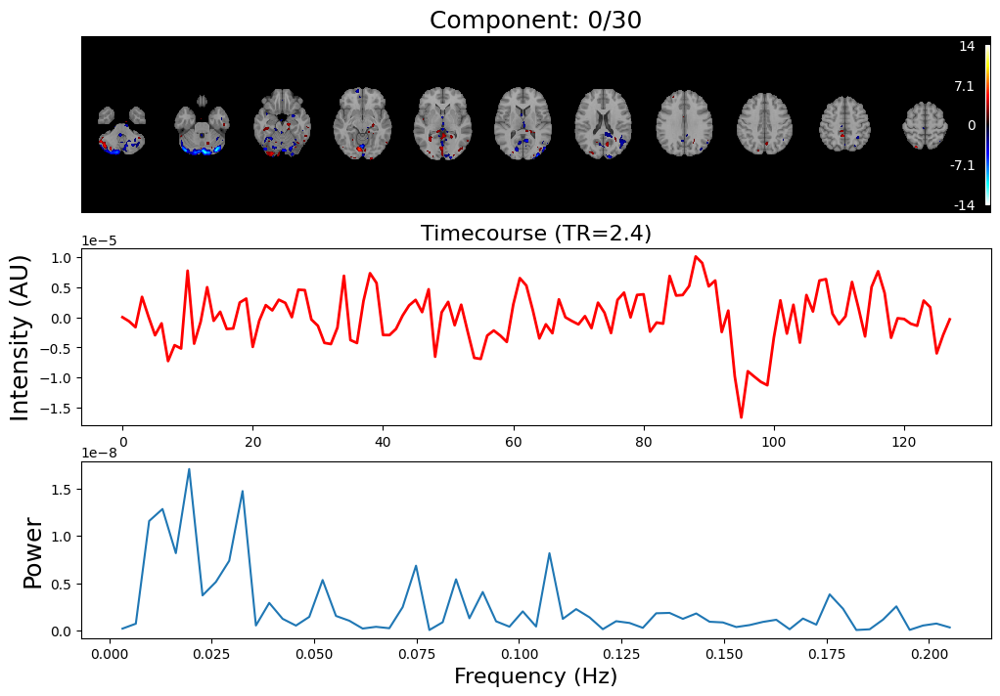

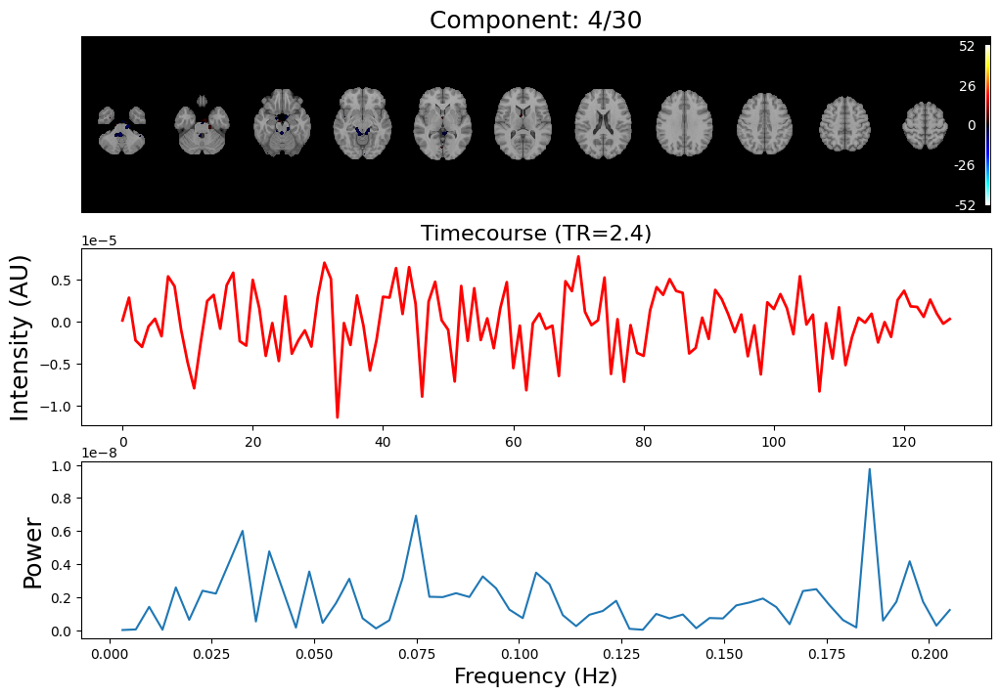

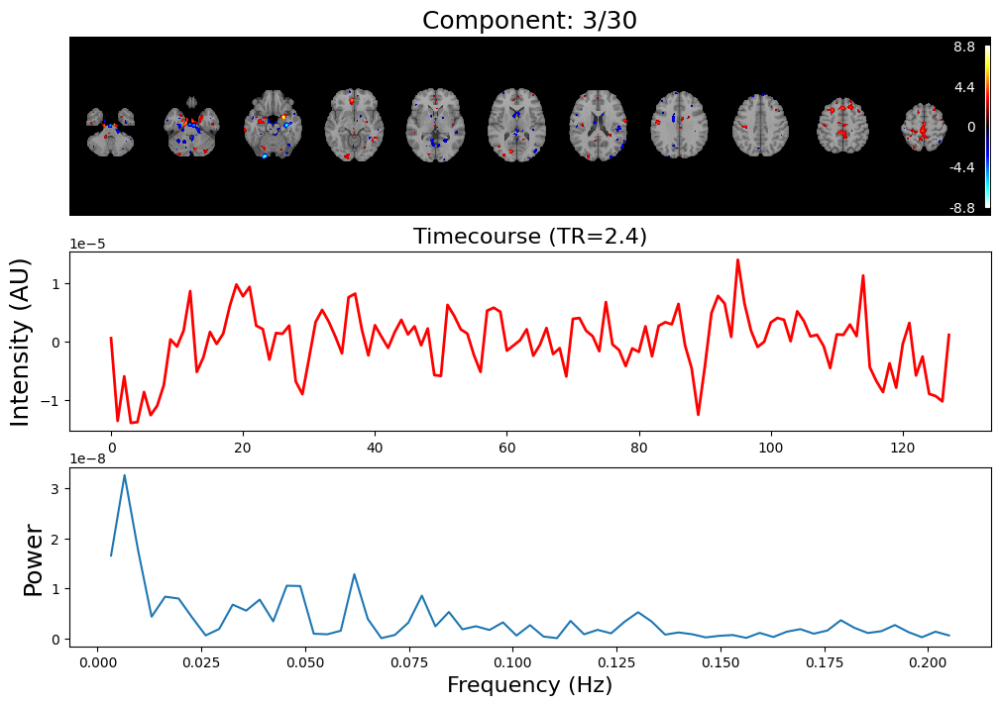

In [ ]:
component_viewer(output, tr=2.4)

Exercise one: Which components are noise and which are signals:

Strategy - ones that resemble the least an HRF:
- Component 1

In [ ]:
# Analyse only the first 10 components
for i in range(0, 5):
  fft_data = np.fft.fft(data.data[:, i])
  print(fft_data[0], fft_data[1], fft_data[2])

(126480.3363647461+0j) (-15.452816891307089-3.544774078519062j) (16.574074106231713-60.07846425081356j)
(121183.44415283203+0j) (-0.5574496804227991-4.37023835283658j) (46.43389561359915-70.93120459585455j)
(117216.25219726562+0j) (22.563331714110532-4.511229903001222j) (76.04710707736778-62.313496919457066j)
(119228.44262695312+0j) (29.13569589981038-4.502816472363364j) (75.14345451112983-47.86603698460864j)
(124873.31237792969+0j) (5.819711353721253-4.843488633876568j) (38.52644721683933-39.43433648706756j)


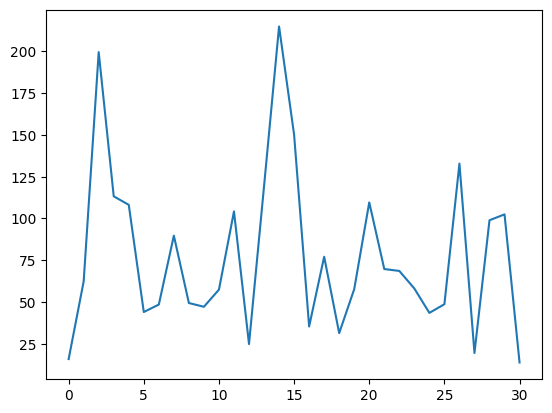

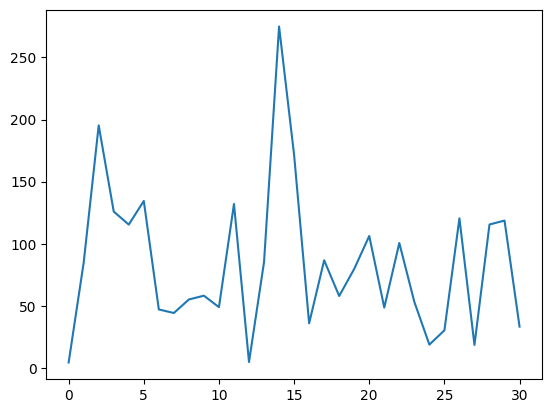

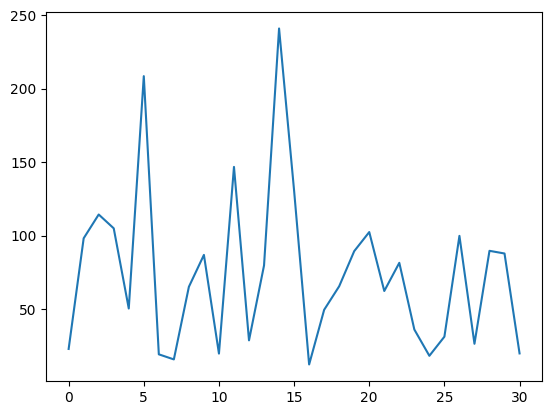

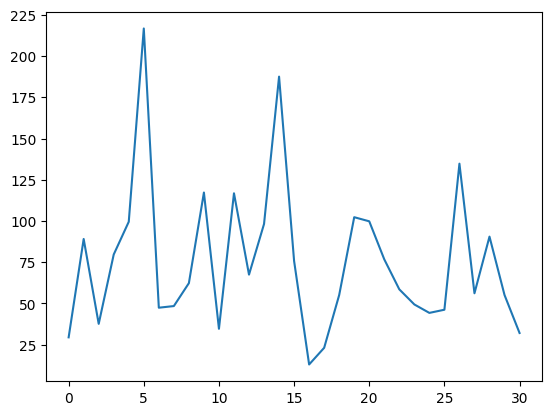

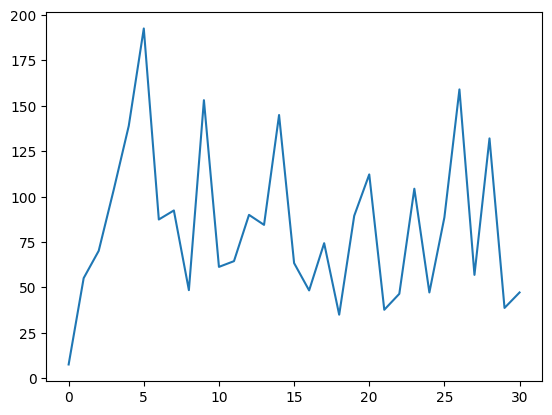

In [ ]:
# Analyse only the first 10 components
for i in range(0, 5):
  fft_data = np.fft.fft(data.data[:, i])
  n = int(0.25*len(fft_data))
  plt.plot(np.abs(fft_data[1:n]))
  plt.show()

#

# Intro to Neuroimaging Data

Let us test the bids package using the drive data

In [ ]:
from bids import BIDSLayout, BIDSValidator
import os

data_dir = '/content/drive/MyDrive/Localizer/'
layout = BIDSLayout(data_dir)
for a in layout.get():
  print(a)

<BIDSJSONFile filename='/content/drive/MyDrive/Localizer/dataset_description.json'>
<BIDSJSONFile filename='/content/drive/MyDrive/Localizer/participants.json'>
<BIDSDataFile filename='/content/drive/MyDrive/Localizer/participants.tsv'>
<BIDSDataFile filename='/content/drive/MyDrive/Localizer/phenotype/behavioural.tsv'>
<BIDSDataFile filename='/content/drive/MyDrive/Localizer/phenotype/subject.tsv'>
<BIDSImageFile filename='/content/drive/MyDrive/Localizer/sub-S01/anat/sub-S01_T1w.nii'>
<BIDSImageFile filename='/content/drive/MyDrive/Localizer/sub-S01/func/sub-S01_task-localizer_bold.nii'>
<BIDSDataFile filename='/content/drive/MyDrive/Localizer/sub-S01/func/sub-S01_task-localizer_events.tsv'>
<BIDSDataFile filename='/content/drive/MyDrive/Localizer/sub-S02/func/sub-S02_task-localizer_events.tsv'>


Get subject names

In [ ]:
layout.get(target='subject', return_type='id')

['S01', 'S02']

Get subject file names

In [ ]:
layout.get(target='subject', scope='raw', suffix='bold', return_type='file')

['/content/drive/MyDrive/Localizer/sub-S01/func/sub-S01_task-localizer_bold.nii']

In [ ]:
layout.get_tasks()

['localizer']

The code below extracts subjects according to a task

In [ ]:
layout.get(task='localizer', suffix='bold', scope='raw')[:10]

[<BIDSImageFile filename='/content/drive/MyDrive/Localizer/sub-S01/func/sub-S01_task-localizer_bold.nii'>]

Dataframe from the dataset

In [ ]:
layout.to_df()

entity,path,datatype,extension,subject,suffix,task
0,/content/drive/MyDrive/Localizer/dataset_descr...,NaN,.json,NaN,description,NaN
1,/content/drive/MyDrive/Localizer/participants....,NaN,.json,NaN,participants,NaN
2,/content/drive/MyDrive/Localizer/participants.tsv,NaN,.tsv,NaN,participants,NaN
3,/content/drive/MyDrive/Localizer/phenotype/beh...,NaN,.tsv,NaN,behavioural,NaN
4,/content/drive/MyDrive/Localizer/phenotype/sub...,NaN,.tsv,NaN,subject,NaN
5,/content/drive/MyDrive/Localizer/sub-S01/anat/...,anat,.nii,S01,T1w,NaN
6,/content/drive/MyDrive/Localizer/sub-S01/func/...,func,.nii,S01,bold,localizer
7,/content/drive/MyDrive/Localizer/sub-S01/func/...,func,.tsv,S01,events,localizer
8,/content/drive/MyDrive/Localizer/sub-S02/func/...,func,.tsv,S02,events,localizer


## Data Load

Now we look at subject one structural image. I had to make some changes due to the lack of some of the preprossed images. Also, I need to fix the error were the scope of the derivative files is not included

In [ ]:
import nibabel as nib

sub1_file = layout.get(subject='S01', suffix='T1w', return_type='file', extension='nii')[0]

data = nib.load(sub1_file)

# Show the obtained data from slice 50
print(data.get_fdata()[:,:,50])

[[313. 778. 328. ... 314.  99. 140.]
 [560.  74. 486. ... 517. 479. 575.]
 [205.  85. 307. ... 385. 150.  74.]
 ...
 [727. 310. 208. ... 224. 295. 212.]
 [117. 206. 424. ... 238.  75. 275.]
 [151. 507. 401. ... 829. 252. 393.]]


Finally, plot the data. I wanted to play arround with some of the images. That's why there are multiple plots

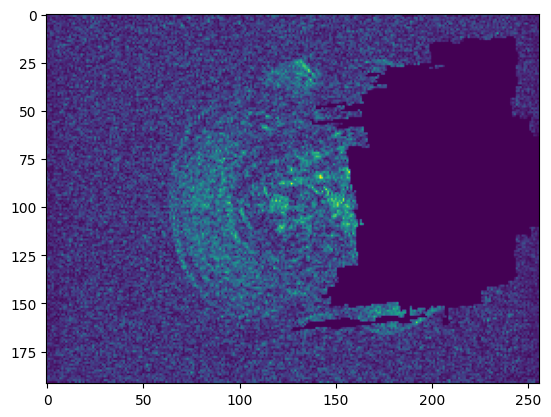

In [ ]:
import matplotlib.pyplot as plt

plt.imshow(data.get_fdata()[:,:,0])


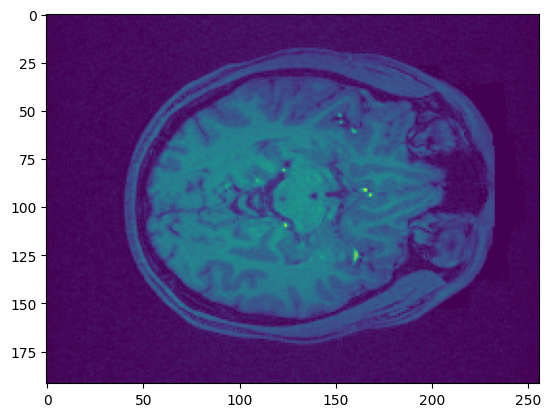

In [ ]:
plt.imshow(data.get_fdata()[:,:,50])

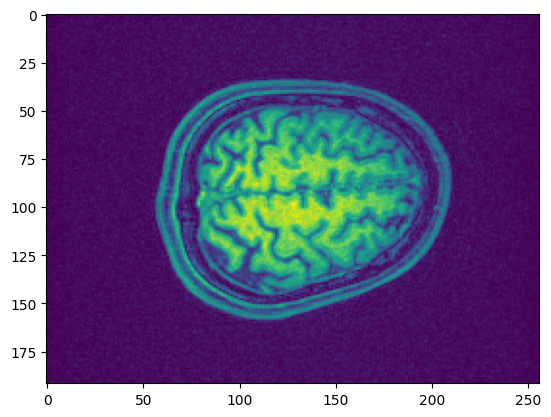

In [ ]:
plt.imshow(data.get_fdata()[:,:,100])

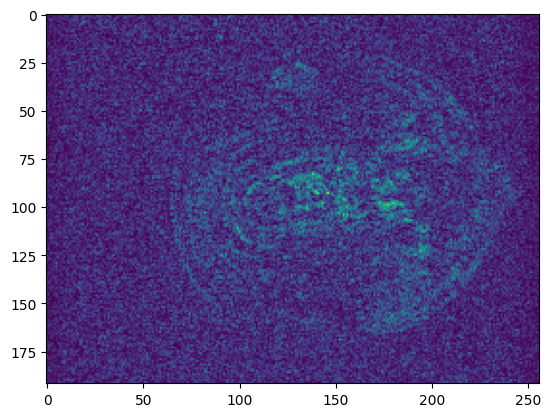

In [ ]:
plt.imshow(data.get_fdata()[:,:,127])

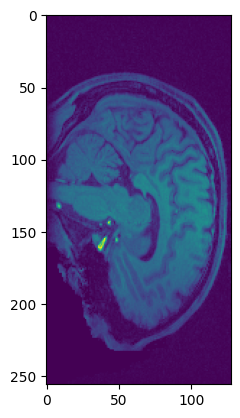

In [ ]:
plt.imshow(data.get_fdata()[100,:,:])

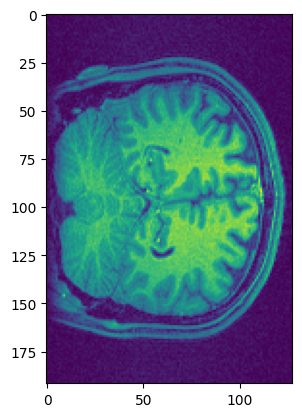

In [ ]:
plt.imshow(data.get_fdata()[:,100,:])

Take a look at the header data

In [ ]:
# Stoped here!

header = data.header
print(header)

<class 'nibabel.nifti1.Nifti1Header'> object, endian='<'
sizeof_hdr      : 348
data_type       : b''
db_name         : b''
extents         : 0
session_error   : 0
regular         : b''
dim_info        : 0
dim             : [  3 192 256 128   1   1   1   1]
intent_p1       : 0.0
intent_p2       : 0.0
intent_p3       : 0.0
intent_code     : none
datatype        : float32
bitpix          : 32
slice_start     : 0
pixdim          : [-1.   1.   1.   1.2  0.   1.   1.   1. ]
vox_offset      : 0.0
scl_slope       : nan
scl_inter       : nan
slice_end       : 0
slice_code      : unknown
xyzt_units      : 10
cal_max         : 0.0
cal_min         : 0.0
slice_duration  : 0.0
toffset         : 0.0
glmax           : 0
glmin           : 0
descrip         : b'FreeSurfer Mar  1 2013'
aux_file        : b''
qform_code      : scanner
sform_code      : scanner
quatern_b       : 0.0
quatern_c       : 1.0
quatern_d       : 0.0
qoffset_x       : 96.0
qoffset_y       : -128.0
qoffset_z       : -76.8
srow_x    



Affine matrix allows the transformation of data between diferent spaces. I don't understand how or why yet


In [ ]:
data.affine

array([[  -1.        ,    0.        ,    0.        ,   96.        ],
       [   0.        ,    1.        ,    0.        , -128.        ],
       [   0.        ,    0.        ,    1.20000005,  -76.80000305],
       [   0.        ,    0.        ,    0.        ,    1.        ]])

## Nilearn
Neuro data manipulation and visualisation. Start with the required import


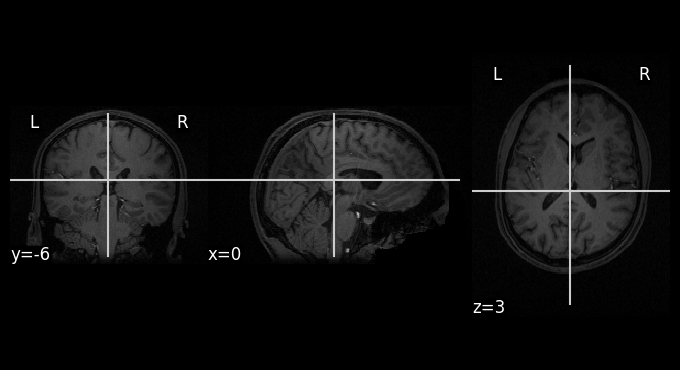

In [ ]:
%matplotlib inline

from nilearn.plotting import view_img, plot_glass_brain, plot_anat, plot_epi

plot_anat(data)

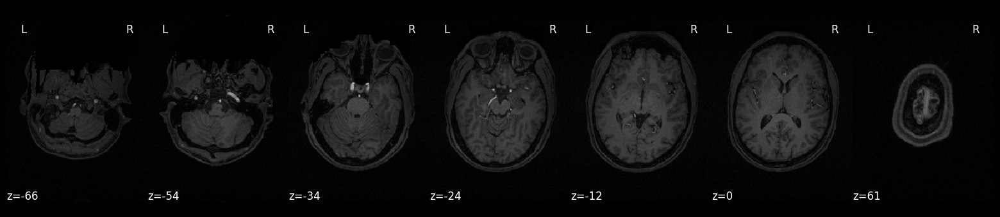

In [ ]:
plot_anat(data, draw_cross=False, display_mode='z')

I decided read the documentation of plot_anat to understand the function and the plot configuration better. Here are some interesting points:

Plot cuts of an anatomical image.

By default 3 cuts: Frontal, Axial, and Lateral.

PARAMETERS:
  - anat_img: Niimg-like object (takes data read with nibabel)
  - cut_coords: The MNI coordinates of the point where the cut is performed. The type depends on the the display mode (how one whises to perform the cut)
  - output_file: The name of an image file to export the plot to. Valid extensions are .png, .pdf, .svg. If output_file is not None, the plot is saved to a file, and the display is closed.
  - display_mode: {“ortho”, “tiled”, “mosaic”, “x”, “y”, “z”, “yx”, “xz”, “yz”}, default=”ortho” - Choose the direction of the cuts
  - figure: Matplotlib figure used or its number. If None is given, a new figure is created.

The other arguments are used mostly for image configuration.


Below, we find an iteractive image viwer from Nilearn:

/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:758: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)



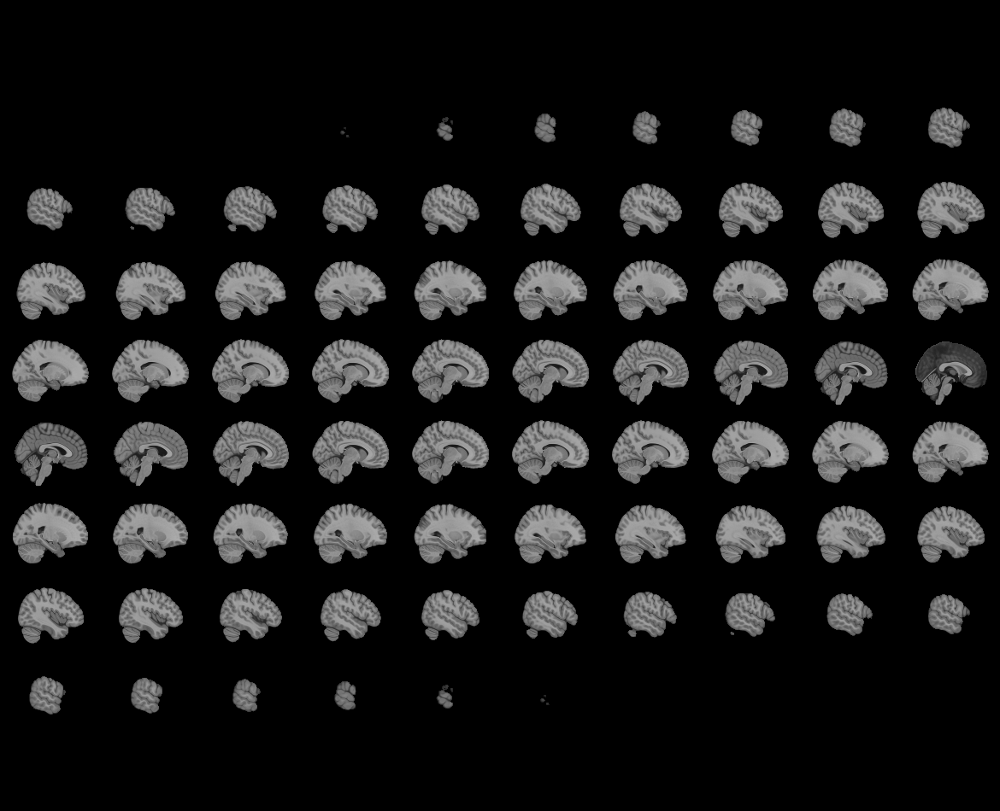
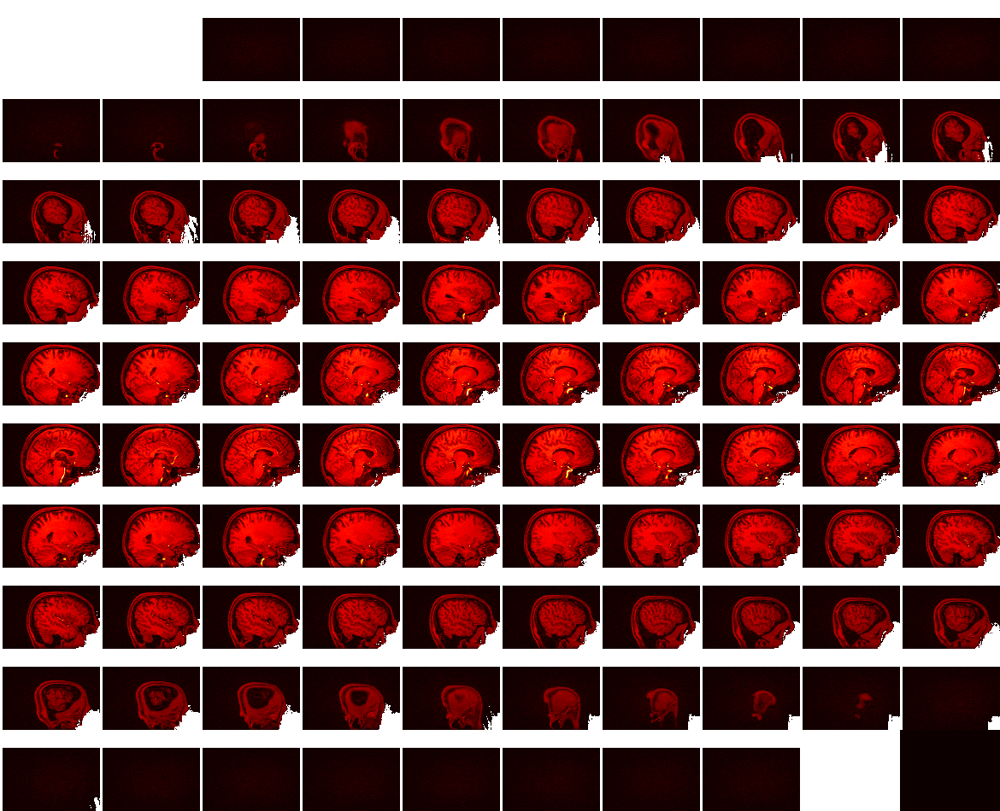

In [ ]:
view_img(data)

We can also load other brain data as a first argument and the brain as background data in the second argument. This allows the first image to overlay the second image. Herein, we plot the amygdala location on top of the previous data. (For now, it yields an error)

In [ ]:
from nltools.data import Brain_Data
amygdala_mask = Brain_Data('https://neurovault.org/media/images/1290/FSL_BAmyg_thr0.nii.gz').to_nifti()

view_img(amygdala_mask, data)

ImportError: cannot import name '_get_dataset_dir' from 'nilearn.datasets.utils' (/usr/local/lib/python3.10/dist-packages/nilearn/datasets/utils.py)

## Nltools

Package for brain data manipulation

- It is the package which contains the Brain_Data object
- Brain mask: brain mask refers to a binary mask that defines which voxels in the brain are included in the analysis. In brain imaging data, particularly when dealing with 3D or 4D images like fMRI data, the mask is used to select only the voxels (i.e., data points in the brain) that are relevant for further processing, while ignoring voxels that are outside the brain or in regions of no interest.

Start by loading the anatomical overlay that comes with the package:

In [ ]:
from nltools.data import Brain_Data
from nltools.utils import get_anatomical

anat = Brain_Data(get_anatomical())
anat

nltools.data.brain_data.Brain_Data(data=(238955,), Y=(0, 0), X=(0, 0), mask=MNI152_T1_2mm_brain_mask.nii.gz)

In [ ]:
print(vars(anat))

{'_h5_compression': 'gzip', 'mask': <nibabel.nifti1.Nifti1Image object at 0x7a15313a5ff0>, 'nifti_masker': NiftiMasker(mask_img=<nibabel.nifti1.Nifti1Image object at 0x7a15313a5ff0>), 'data': array([1875., 2127., 2182., ..., 5170., 5180., 2836.], dtype=float32), 'Y': Empty DataFrame
Columns: []
Index: [], 'X': Empty DataFrame
Columns: []
Index: []}


Get the available methods from Brain_Data class:

In [ ]:
for i, met in enumerate(dir(anat)):
  print(met + ' ', end="")
  if (i + 1) % 5 == 0:
    print()

X Y __add__ __class__ __delattr__ 
__dict__ __dir__ __doc__ __eq__ __format__ 
__ge__ __getattribute__ __getitem__ __gt__ __hash__ 
__init__ __init_subclass__ __iter__ __le__ __len__ 
__lt__ __module__ __mul__ __ne__ __new__ 
__radd__ __reduce__ __reduce_ex__ __repr__ __rmul__ 
__rsub__ __setattr__ __setitem__ __sizeof__ __slotnames__ 
__str__ __sub__ __subclasshook__ __truediv__ __weakref__ 
_h5_compression aggregate align append apply_mask 
astype bootstrap copy data decompose 
detrend distance dtype empty extract_roi 
filter find_spikes groupby icc iplot 
isempty mask mean median multivariate_similarity 
nifti_masker plot predict predict_multi r_to_z 
randomise regions regress scale shape 
similarity smooth standardize std sum 
temporal_resample threshold to_nifti transform_pairwise ttest 
upload_neurovault write z_to_r 

Load subject functional data:

In [ ]:
sub = 'sub-S01'

data_dir = '/content/drive/MyDrive/Localizer/derivatives/fmriprep' + \
           '/sub-S01/func/sub-S01_task-localizer_space-MNI152NLin2009cAsym_desc-preproc_bold.nii'

data = Brain_Data(data_dir)

Check data caracteristics:

In [ ]:
print(len(data))

128


In [ ]:
# Images times voxels here!

print(data.shape())

(128, 238955)


The data can be indexed - Why are the voxels linear? Why not a 3D array with their position?

In [ ]:
import numpy as np

print(data[5].shape())

print(data[[1,6,2]].shape())

print(data[0:10].shape())

index = np.zeros(len(data), dtype=bool)
index[[1,5,9, 16, 20, 22]] = True

print(data[index].shape())

(238955,)
(3, 238955)
(10, 238955)
(6, 238955)


Interesting, one can access speciefic indexes by using a numpy bool matrix and setting the respective indexes to true. One can then get_item the data object for the respective indexes.

In [ ]:
print(index)

[False  True False False False  True False False False  True False False
 False False False False  True False False False  True False  True False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False]


The next part is for calculations. I will perform some calculations and checks for now

In [ ]:
voxel_mean = data.mean()

print(voxel_mean.data)
print(voxel_mean.data[2])
print(voxel_mean.shape())

[1161.8536   675.25336  392.1093  ... 3867.6482  3734.377   1978.2362 ]
392.1093
(238955,)


In [ ]:
voxel_dev = data.std()
print(voxel_dev.data)
print(voxel_dev.shape())

[63.489384 62.66826  48.40051  ... 62.015793 82.39487  62.222076]
(238955,)


In [ ]:
# Ask about this - What is the shape? - 128 time instants?

new = data[1] + data[2]
print(new.data)
print(data.shape())
print(new.shape())

[2648.6135 1585.3638  833.7619 ... 7819.3555 7646.371  4006.9946]
(128, 238955)
(238955,)


The data can also be manipulated through basic aritimethic operations.

In [ ]:
data2 = (data + 10) * 2

In [ ]:
# Perform copies

new = data.copy()
print(new)

nltools.data.brain_data.Brain_Data(data=(128, 238955), Y=(0, 0), X=(0, 0), mask=MNI152_T1_2mm_brain_mask.nii.gz)


Can also be easily converted to nifi

In [ ]:
print(data.to_nifti())


<class 'nibabel.nifti1.Nifti1Image'>
data shape (91, 109, 91, 128)
affine:
[[  -2.    0.    0.   90.]
 [   0.    2.    0. -126.]
 [   0.    0.    2.  -72.]
 [   0.    0.    0.    1.]]
metadata:
<class 'nibabel.nifti1.Nifti1Header'> object, endian='<'
sizeof_hdr      : 348
data_type       : b''
db_name         : b''
extents         : 0
session_error   : 0
regular         : b''
dim_info        : 0
dim             : [  4  91 109  91 128   1   1   1]
intent_p1       : 0.0
intent_p2       : 0.0
intent_p3       : 0.0
intent_code     : none
datatype        : float32
bitpix          : 32
slice_start     : 0
pixdim          : [-1.  2.  2.  2.  1.  1.  1.  1.]
vox_offset      : 0.0
scl_slope       : nan
scl_inter       : nan
slice_end       : 0
slice_code      : unknown
xyzt_units      : 0
cal_max         : 0.0
cal_min         : 0.0
slice_duration  : 0.0
toffset         : 0.0
glmax           : 0
glmin           : 0
descrip         : b''
aux_file        : b''
qform_code      : unknown
sform_code

In [ ]:
# Any Brain_Data object can be written out to a nifti file.
# Yeah I am not gonna uncoment the code bellow because I don't want my drive to become a brain data dumbster

# data.write('Tmp_Data.nii.gz')

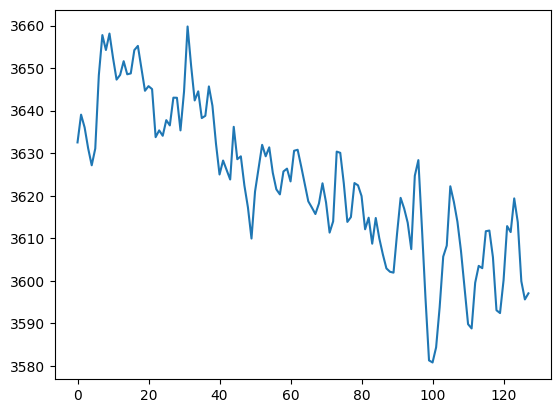

In [ ]:
import matplotlib.pyplot as plt

plt.plot(data.mean(axis=1))

The object Brain_Data from nltools.data also has a way to plot effect maps - Actually, I can't call this an effect map. It is just an average along multiple voxels.

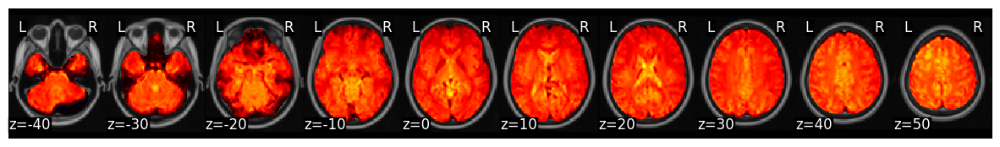

In [ ]:
f = data.mean().plot()

It also has an iterative plot

In [ ]:
data.mean().iplot()

interactive(children=(FloatText(value=0.0, description='Threshold'), HTML(value='Image is 3D', description='Vo…

## Exercises

For exercise one, as unfortunately I do not have the entire dataset. Only subject one. I will write what I believe to be the correct command

In [ ]:
# Dataset json is missing from derivatives so it cannot be appended - to fix later
from bids import BIDSLayout, BIDSValidator
import os

data_dir = '/content/drive/MyDrive/Localizer/'
layout = BIDSLayout(data_dir, derivatives=True)

# Scope - derivatives - only searches for subjects which have been preprocessed
layout.get(target='subject', suffix='bold', scope='derivatives')

/usr/local/lib/python3.10/dist-packages/bids/layout/layout.py:516: UserWarning: Derivative indexing was requested, but no valid datasets were found in the specified locations ([PosixUPath('/content/drive/MyDrive/Localizer/derivatives')]). Note that all BIDS-Derivatives datasets must meet all the requirements for BIDS-Raw datasets (a common problem is to fail to include a 'dataset_description.json' file in derivatives datasets).
Example contents of 'dataset_description.json':
{"Name": "Example dataset", "BIDSVersion": "1.0.2", "GeneratedBy": [{"Name": "Example pipeline"}]}
  warnings.warn("Derivative indexing was requested, but no valid "


[]

For exercise two, we need to calculate the SNR of the data of subject one using the brain data constructor.

In [ ]:
sub = 'sub-S01'

data_dir = '/content/drive/MyDrive/Localizer/derivatives/fmriprep' + \
           '/sub-S01/func/sub-S01_task-localizer_space-MNI152NLin2009cAsym_desc-preproc_bold.nii'

data = Brain_Data(data_dir)

data_snr = data.mean()/data.std()
print(data_snr.data)

[18.299967 10.775045  8.101347 ... 62.365536 45.322933 31.793156]


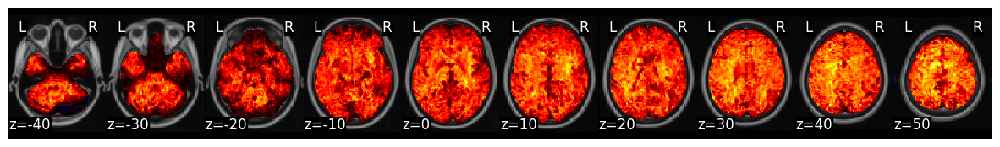

In [ ]:
data_snr.plot()

For exercise 3, we need to find outliers in the data using the zscore.

In [ ]:
mean = data.mean()
std = data.std()


z_scores = []
for img in data:
  z = (img - mean)/std
  z = z.mean()
  z_scores.append(z)

print(z_scores)


[0.11748856, 0.21675317, 0.16960898, 0.09397618, 0.03890168, 0.11288297, 0.37404847, 0.49916285, 0.43496796, 0.49923468, 0.40558556, 0.328248, 0.37499306, 0.37256008, 0.36525944, 0.36944488, 0.42090476, 0.45690608, 0.3455158, 0.29847616, 0.29208252, 0.32117847, 0.1396336, 0.19641069, 0.160346, 0.21518162, 0.20461969, 0.29764807, 0.26943067, 0.13346893, 0.31220555, 0.48658127, 0.36788273, 0.23023215, 0.27232617, 0.1765626, 0.20394719, 0.3268525, 0.23836644, 0.084739774, 0.012049451, 0.05980689, 0.025521357, -0.028497064, 0.18956533, 0.06783456, 0.08932238, -0.046229854, -0.08473708, -0.17147465, -0.0033233517, 0.023630626, 0.12523848, 0.061889775, 0.09058378, 0.020450912, -0.047923684, -0.046030097, 0.04214556, 0.06455976, 0.018318236, 0.12812594, 0.115382254, 0.039045826, 0.011767916, -0.070786245, -0.048769265, -0.108569235, -0.041957173, 0.005583532, -0.030207764, -0.1724221, -0.0851001, 0.13573253, 0.08804863, -0.0018451707, -0.14820164, -0.08947649, -0.0042913337, -0.0017655253, -0

In [ ]:
import numpy as np

spatial_averages = []
spatial_devs = []

for i in range(len(data)):
  spatial_averages.append(np.mean(data[i].data))

u = np.mean(spatial_averages)
s = np.std(spatial_averages)

z_scores = []
for x in spatial_averages:
  z = (x - u)/s
  z_scores.append(z)
print(z_scores)

[0.52294534, 0.8879318, 0.719698, 0.44410238, 0.22228315, 0.442615, 1.4047914, 1.933072, 1.7372199, 1.9537038, 1.6340882, 1.3482722, 1.4097173, 1.5901364, 1.418, 1.429544, 1.7355825, 1.7911874, 1.5002817, 1.2014889, 1.2623336, 1.2233351, 0.59208643, 0.6811771, 0.6101529, 0.8156113, 0.7463065, 1.1110201, 1.1096964, 0.68098605, 1.1909001, 2.0463285, 1.5286777, 1.0743959, 1.1940658, 0.84292936, 0.8724853, 1.258622, 1.004204, 0.50520635, 0.10141242, 0.28499728, 0.16116552, 0.03575088, 0.7280626, 0.30231327, 0.34020647, -0.042682733, -0.3314871, -0.73997504, -0.12234443, 0.18919311, 0.4911789, 0.34073865, 0.45834813, 0.12383177, -0.09340259, -0.16001931, 0.1411614, 0.17849514, 0.010534229, 0.41349578, 0.4264043, 0.2072596, -0.02074097, -0.25111583, -0.33219665, -0.4179169, -0.27885687, -0.013877346, -0.26676708, -0.6620463, -0.5139121, 0.4023339, 0.3863142, -0.015596664, -0.5214171, -0.45810252, -0.010902654, -0.040840607, -0.18170181, -0.61834013, -0.4659759, -0.8075196, -0.47017866, -0.73

# Signal Processing Basics

Start with some dot product basics. Just simple application of a dot product.

In [ ]:
import numpy as np

a = np.random.randint(1,10,20)
b = np.random.randint(1,10,20)

res = np.dot(a, b)
print(res)

505


## Convolution

This section describes the code refering to the convolution

Text(0.5, 1.0, 'Kernel ')

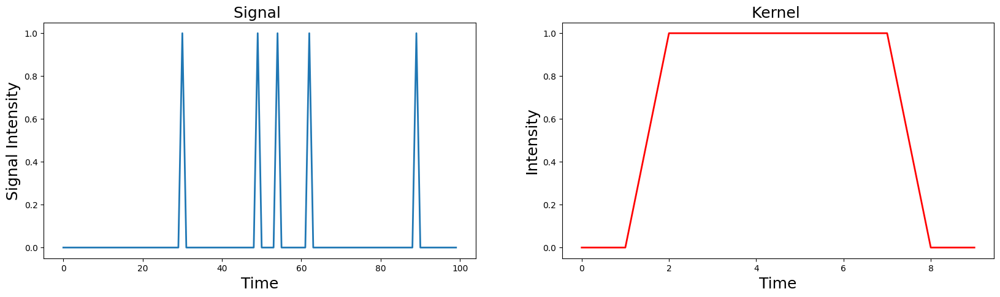

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

n_samples = 100

signal = np.zeros(n_samples)
signal[np.random.randint(0 ,n_samples, 5)] = 1

kernel = np.zeros(10)
kernel[2:8] = 1

f,a = plt.subplots(ncols=2, figsize=(20,5))
a[0].plot(signal, linewidth=2)
a[0].set_xlabel('Time', fontsize=18)
a[0].set_ylabel('Signal Intensity', fontsize=18)
a[0].set_title('Signal ', fontsize=18)
a[1].plot(kernel, linewidth=2, color='red')
a[1].set_xlabel('Time', fontsize=18)
a[1].set_ylabel('Intensity', fontsize=18)
a[1].set_title('Kernel ', fontsize=18)

So, to perform the convolution, we shift the kernal through all the duration of the signal. For some reasons, points where the kernel is cut-off are not considered. This does affect the convolution at the edges of the singal. Furthermore, the kernel is reapeted along to rows to ensure consistency when multiplies.

Text(0.5, 1.0, 'Time Shifted Kernels')

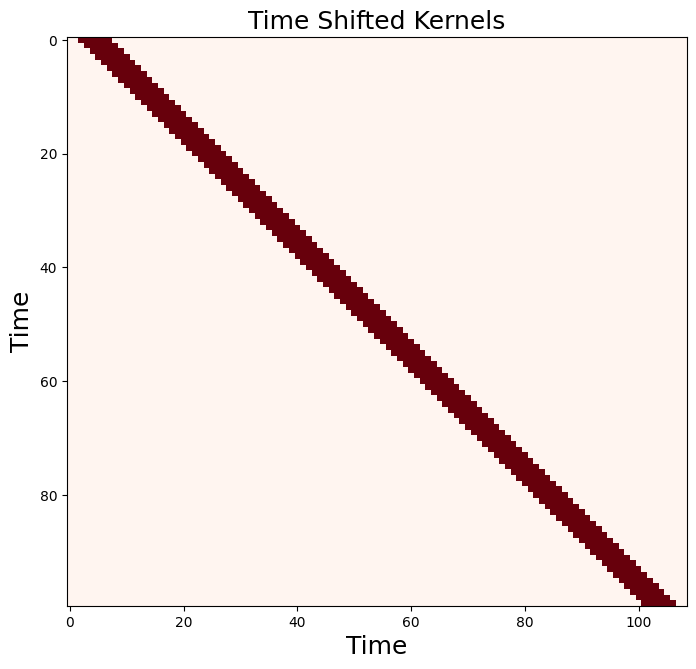

In [ ]:
# @TODO QUESTION ---------------------------------------------------------------
# Edges not considered - The kernel is cut-off as soon as any point reaches the edge of the signal
# I kinda dislike this to be honest.

shifted_kernel = np.zeros((n_samples, n_samples+len(kernel) - 1))

for i in range(n_samples):
    shifted_kernel[i, i:i+len(kernel)] = kernel

plt.figure(figsize=(8, 8))
plt.imshow(shifted_kernel, cmap='Reds')
plt.xlabel('Time', fontsize=18)
plt.ylabel('Time', fontsize=18)
plt.title('Time Shifted Kernels', fontsize=18)

Checking dimension consitance to perform the convolution.

In [ ]:
print(signal.shape)
print(shifted_kernel.shape)

(100,)
(100, 109)


Performing the convolution

Text(0.5, 1.0, 'Signal convolved with boxcar kernel')

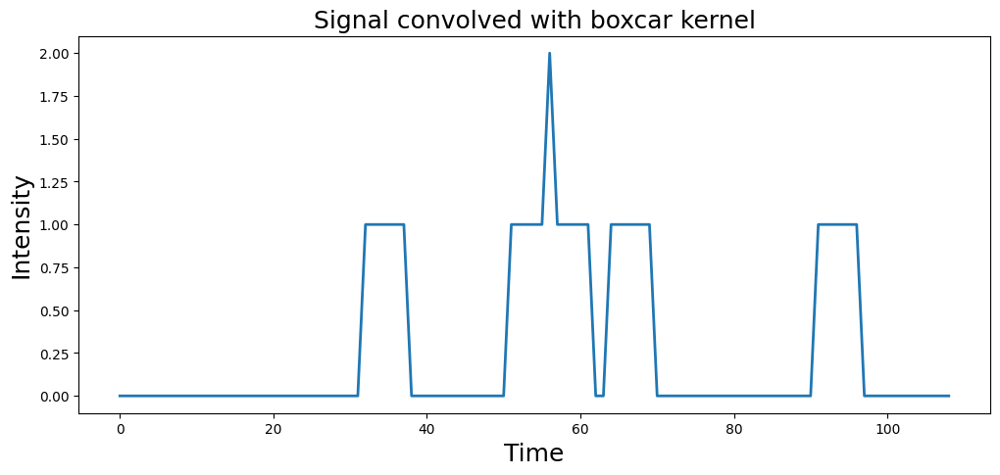

In [ ]:
convolved_signal = np.dot(signal, shifted_kernel)

plt.figure(figsize=(12, 5))
plt.plot(convolved_signal, linewidth=2)
plt.ylabel('Intensity', fontsize=18)
plt.xlabel('Time', fontsize=18)
plt.title('Signal convolved with boxcar kernel', fontsize=18)

Text(0.5, 1.0, 'Signal convolved with boxcar kernel')

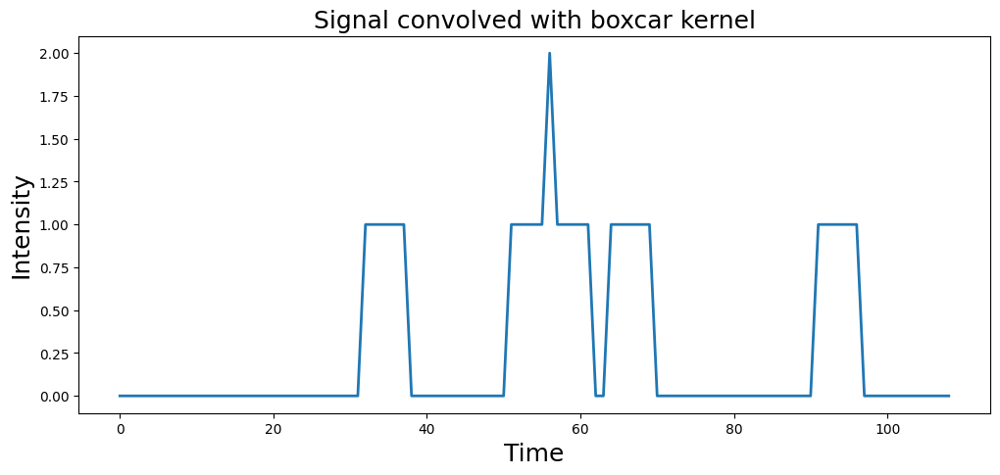

In [ ]:
# Np.convolve can also perform a convolution

plt.figure(figsize=(12, 5))
plt.plot(np.convolve(signal, kernel), linewidth=2)
plt.ylabel('Intensity', fontsize=18)
plt.xlabel('Time', fontsize=18)
plt.title('Signal convolved with boxcar kernel', fontsize=18)

Text(0.5, 1.0, 'Hemodynamic Response Function')

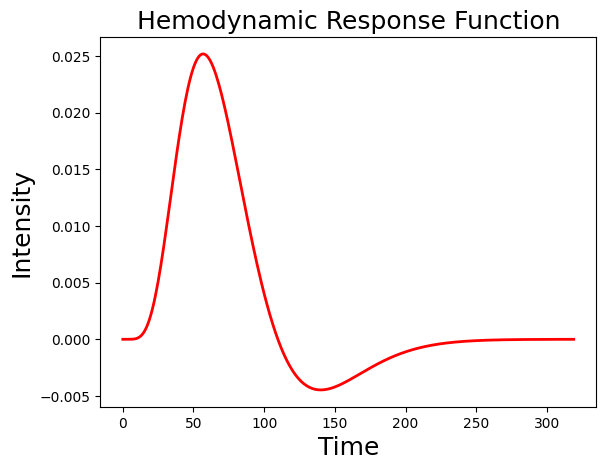

In [ ]:
# QUESTION ---------------------------------------------------------------------
# HOW DO I PROPERLY ADJUST THE HEMODYNAMIC RESPONSE FUNCTION TO MATCH SAMPLE
# BRAIN RATES? - OVERSAMPLING
# This part of the code imports the hemodynamic function

from nltools.external import glover_hrf

tr = 2
hrf = glover_hrf(tr, oversampling=20)
plt.plot(hrf, linewidth=2, color='red')
plt.ylabel('Intensity', fontsize=18)
plt.xlabel('Time', fontsize=18)
plt.title('Hemodynamic Response Function', fontsize=18)

Text(0.5, 1.0, 'Hemodynamic Response Function')

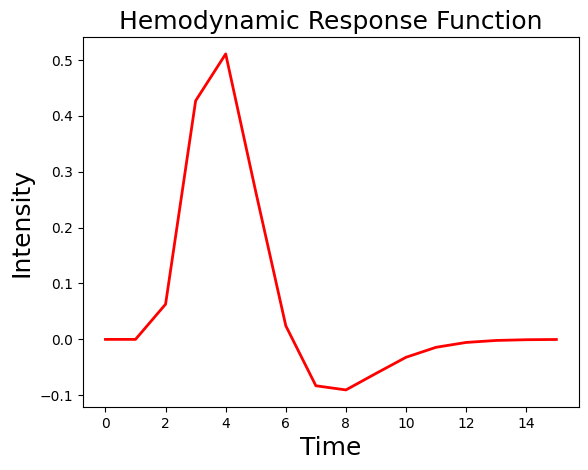

In [ ]:
# Another hemodynamic function but with a lower oversampling
# 1 - for the sampling rate of this problem

hrf = glover_hrf(tr, oversampling=1)
plt.plot(hrf, linewidth=2, color='red')
plt.ylabel('Intensity', fontsize=18)
plt.xlabel('Time', fontsize=18)
plt.title('Hemodynamic Response Function', fontsize=18)

Text(0.5, 1.0, 'Signal convolved with HRF kernel')

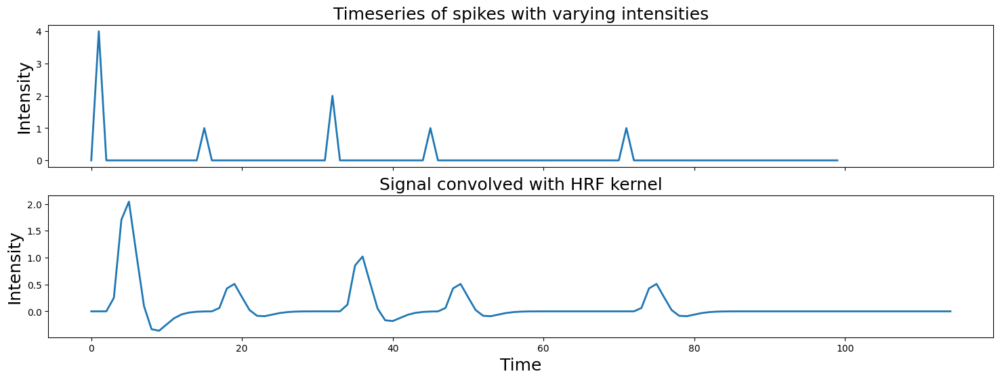

In [ ]:
# Perform a convolution with a random signal and the HRF
import numpy as np
import matplotlib.pyplot as plt

n_samples = 100

signal = np.zeros(n_samples)
signal[np.random.randint(0,n_samples,5)] = np.random.randint(1,5,5)

f,a = plt.subplots(nrows=2, figsize=(18,6), sharex=True)
a[0].plot(signal, linewidth=2)
a[1].plot(np.convolve(signal, hrf), linewidth=2)
a[0].set_ylabel('Intensity', fontsize=18)
a[0].set_title('Timeseries of spikes with varying intensities', fontsize=18)
a[1].set_ylabel('Intensity', fontsize=18)
a[1].set_xlabel('Time', fontsize=18)
a[1].set_title('Signal convolved with HRF kernel', fontsize=18)

## Oscilations

Text(0, 0.5, 'Amplitude')

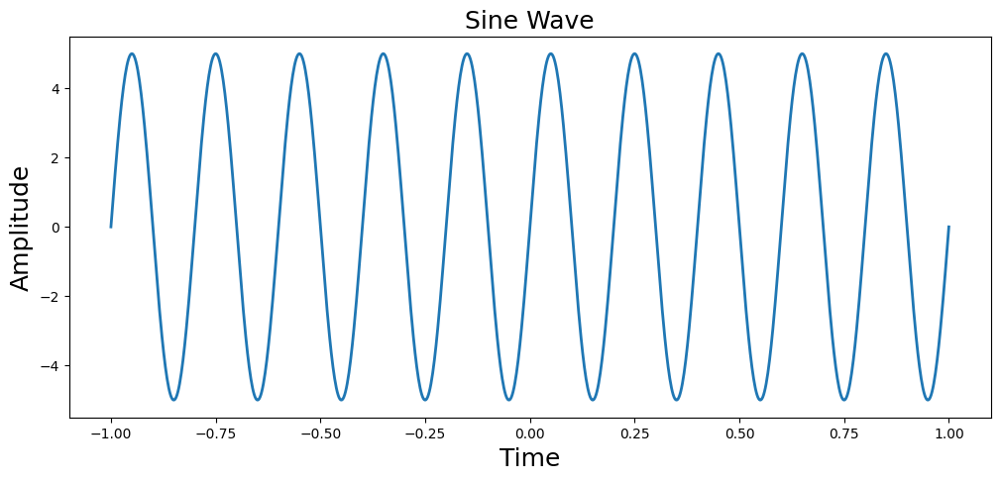

In [ ]:
# This function plots a simple sine wave using numpy arrange

from numpy import sin, pi, arange

sampling_freq = 500
# Returns evenly spaced intervals from -1 to 1+1/samp with spacing of 1/samp
time = arange(-1, 1 + 1/sampling_freq, 1/sampling_freq)
amplitude = 5
freq = 5
theta = 0

# Calculates the value of the sin function to all times in the arrange
simulation = amplitude * sin(2 * pi * freq * time + theta)

plt.figure(figsize=(12, 5))
plt.plot(time, simulation, linewidth=2)
plt.title('Sine Wave', fontsize=18)
plt.xlabel('Time', fontsize=18)
plt.ylabel('Amplitude', fontsize=18)

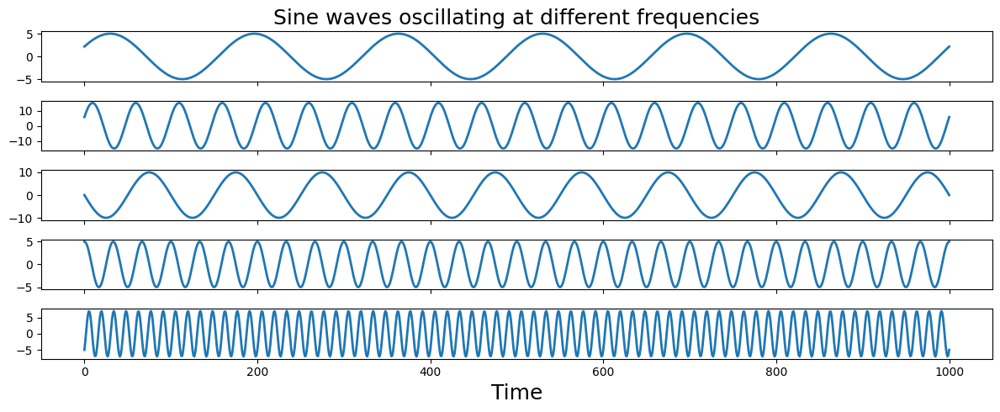

In [ ]:
# Different sine frequencies

sampling_freq = 500

freq = [3, 10, 5 ,15, 35]
amplitude = [5, 15, 10, 5, 7]
phases = pi*np.array([1/7, 1/8, 1, 1/2, -1/4])

time = arange(-1, 1 + 1/sampling_freq, 1/sampling_freq)

sine_waves = []
for i,f in enumerate(freq):
    sine_waves.append(amplitude[i] * sin(2*pi*f*time + phases[i]))
sine_waves = np.array(sine_waves)


f,a = plt.subplots(nrows=5, ncols=1, figsize=(12,5), sharex=True)
for i,x in enumerate(freq):
    a[i].plot(sine_waves[i,:], linewidth=2)
a[0].set_title("Sine waves oscillating at different frequencies", fontsize=18)
a[i].set_xlabel("Time", fontsize=18)
plt.tight_layout()

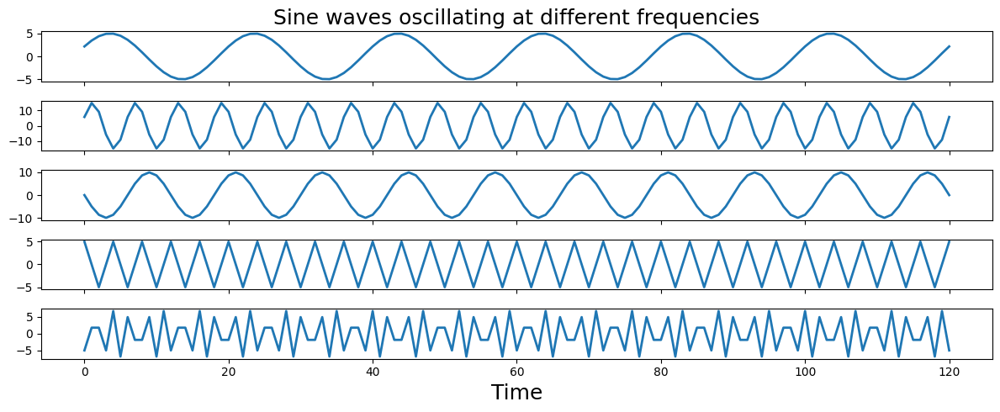

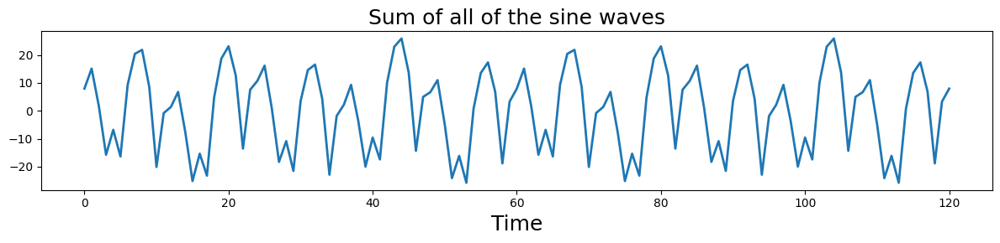

In [ ]:
# The following example shows that how by decreasing the sampling frequency we
# are not able to reconstitue the original signal anymore. Here the reduced
# samplying frequencies make it impossible to reconstruct and properly retrieve
# the higher frequency signal. This clearly afects the sum of all signals.

sampling_freq = 60

freq = [3, 10, 5 ,15, 35]
amplitude = [5, 15, 10, 5, 7]
phases = pi*np.array([1/7, 1/8, 1, 1/2, -1/4])

time = arange(-1, 1 + 1/sampling_freq, 1/sampling_freq)

sine_waves = []
for i,f in enumerate(freq):
    sine_waves.append(amplitude[i] * sin(2*pi*f*time + phases[i]))
sine_waves = np.array(sine_waves)


f,a = plt.subplots(nrows=5, ncols=1, figsize=(12,5), sharex=True)
for i,x in enumerate(freq):
    a[i].plot(sine_waves[i,:], linewidth=2)
a[0].set_title("Sine waves oscillating at different frequencies", fontsize=18)
a[i].set_xlabel("Time", fontsize=18)
plt.tight_layout()


plt.figure(figsize=(12,3))
plt.plot(np.sum(sine_waves, axis=0), linewidth=2)
plt.title("Sum of all of the sine waves", fontsize=18)
plt.xlabel("Time", fontsize=18)
plt.tight_layout()

## Time & Frequency Domains

The frequency domain is the result of the convolution of the signal with all possible frequencies of waves. Normally, for computers, we use the discrete fourrier transform. As the data is discreate and not continous. The sine can be written as an exponential to an imaginary power.

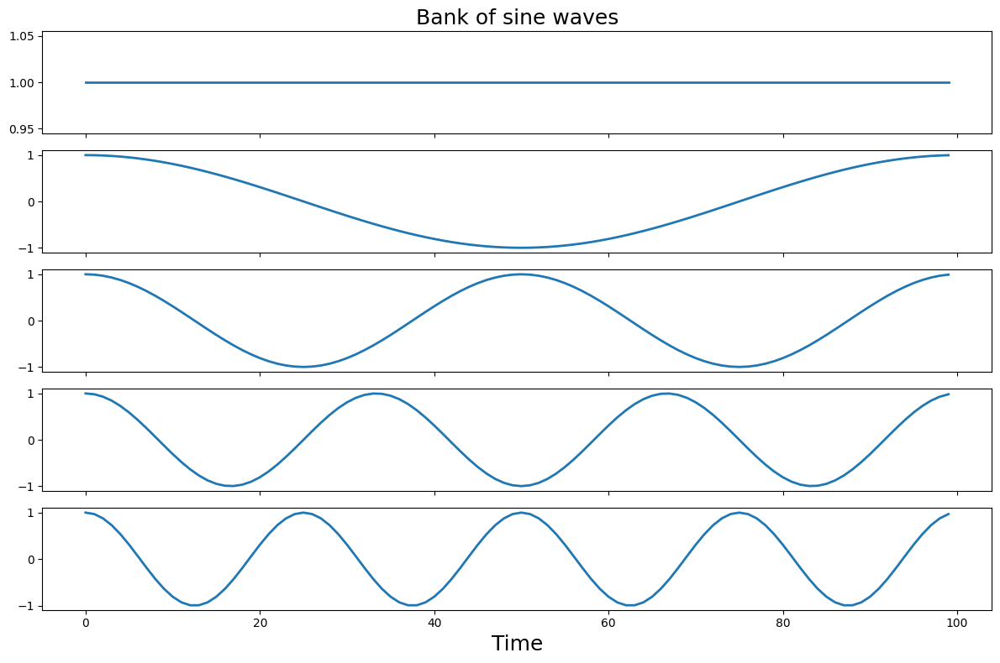

In [ ]:
# This part of the code creates a filter bank - I don't yet know what that is
# So let us start with the 5 sin wave functions using the imaginary exponential

import numpy as np
from numpy import exp

time = np.arange(0, len(signal), 1)/len(signal)

sine_waves = []
for i in range(len(signal)):
    sine_waves.append(exp(-1j*2*pi*i*time))
sine_waves = np.array(sine_waves)

f,a = plt.subplots(nrows=5, figsize=(12,8), sharex=True)
for i in range(0,5):
    a[i].plot(sine_waves[i,:], linewidth=2)
a[0].set_title('Bank of sine waves', fontsize=18)
a[i].set_xlabel('Time', fontsize=18)
plt.tight_layout()

Text(0.5, 0, 'Time')

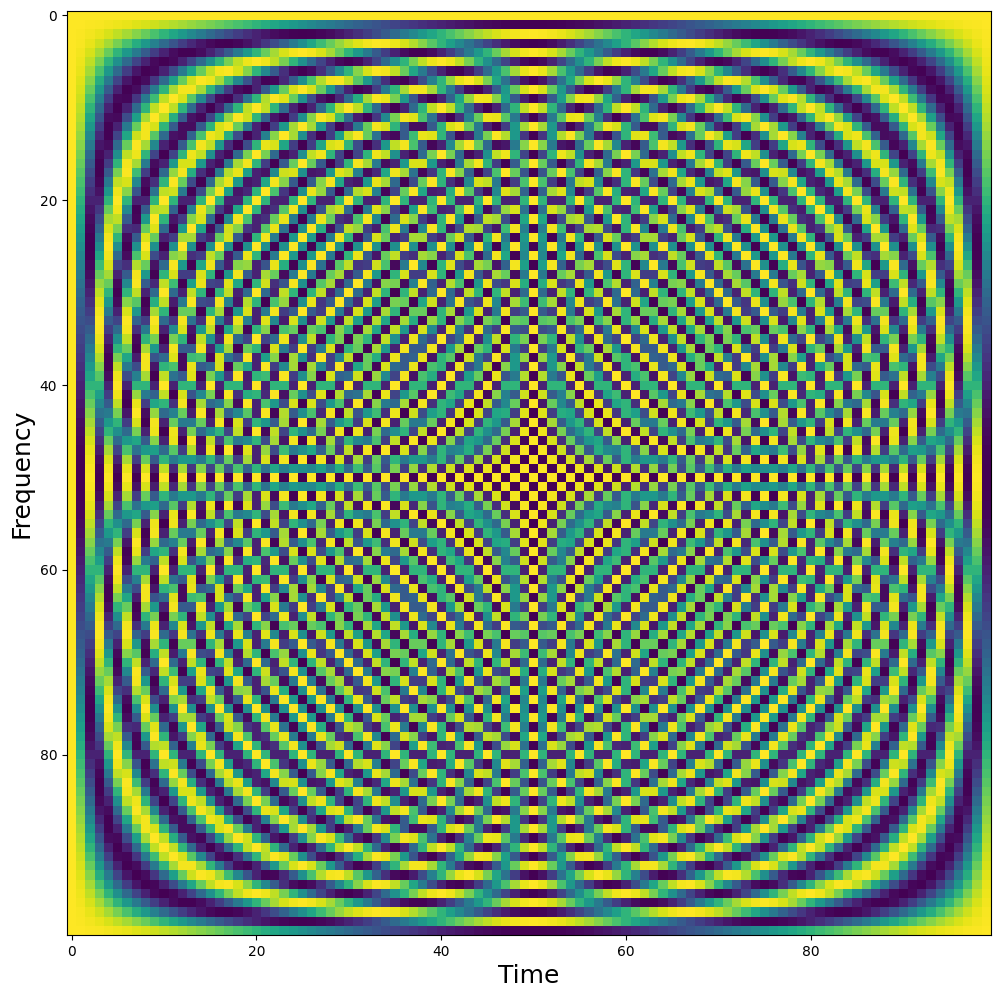

In [ ]:
# There was a heatmap that I did not fully understand the reason, why and how it is plot
# I will skip it for now, but I will post the plot here

plt.figure(figsize = (12, 12))
plt.imshow(np.real(sine_waves))
plt.ylabel('Frequency', fontsize=18)
plt.xlabel('Time', fontsize=18)

Interesting, the course proposes a process to normalize the signal amplitude so it remains in the same magnitude as the original data - Here it is:

Now let’s take the dot product of each of the sine wave basis set with our signal to get the fourier coefficients.

We can scale the coefficients to be more interpretable by dividing by the number of time points and multiplying by 2. Watch this video if you’re interested in a more detailed explanation. Basically, this only needs to be done if you want the amplitude to be in the same units as the original data. In practice, this scaling factor will not change your interpretation of the spectrum.

From the video this is what I get:
The longer the signal - the more it adds to the fourrier transform. This makes sense as the actual fourrier transform of the sine wave has infinity amplitude due to the infite time duration of the sine. We normalize by signal length to account for this and get a finite response.
Further, we multiply by two as the positive and negative frequencies are equal for a real signal.



Text(0.5, 1.0, 'Power spectrum derived from discrete fourier transform')

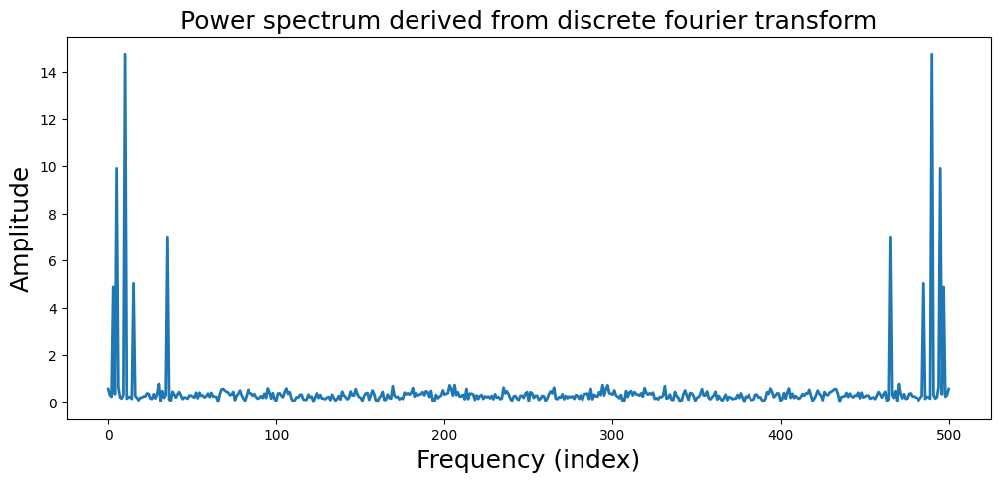

In [ ]:
# There is clearly an error in this code. I am too frustrated to fix it
# It comes from the course habit of constantly redifining the same variables
# over and over. So it gets quite messy and it is hard to see track what
# is actually being used in each operation
# There are more magnitudes than expected here

sampling_freq = 500

freq = [3, 10, 5 ,15, 35]
amplitude = [5, 15, 10, 5, 7]
phases = pi*np.array([1/7, 1/8, 1, 1/2, -1/4])

time = arange(-1, 1 + 1/sampling_freq, 1/sampling_freq)

sine_waves = []
for i,f in enumerate(freq):
    sine_waves.append(amplitude[i] * sin(2*pi*f*time + phases[i]))
sine_waves = np.array(sine_waves)

noise = 5 * np.random.randn(sine_waves.shape[1])
signal = np.sum(sine_waves,axis=0) + noise

sine_waves = []
for i in range(len(signal)):
    sine_waves.append(exp(-1j*2*pi*i*time))
sine_waves = np.array(sine_waves)

fourier = 2*np.dot(signal, sine_waves)/len(signal)

mag_fourier = np.abs(fourier[0:int(np.ceil(len(fourier)/2))])

plt.figure(figsize=(12, 5))
plt.plot(mag_fourier, linewidth=2)
plt.xlabel('Frequency (index)', fontsize=18)
plt.ylabel('Amplitude', fontsize=18)
plt.title('Power spectrum derived from discrete fourier transform', fontsize=18)

Text(0.5, 1.0, 'Power spectrum derived from discrete fourier transform')

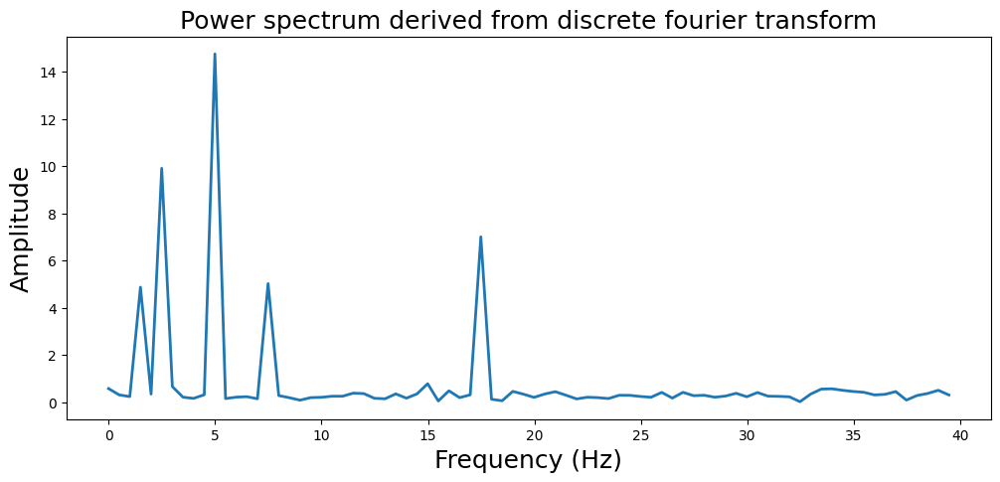

In [ ]:
# At least the fft is correct - So yeah. This dot product approach is a little
# insane

from numpy.fft import fftfreq

freq = fftfreq(len(signal),1/sampling_freq)

plt.figure(figsize=(12,5))
plt.plot(freq[:80], np.abs(fourier)[0:80], linewidth=2)
plt.xlabel('Frequency (Hz)', fontsize=18)
plt.ylabel('Amplitude', fontsize=18)
plt.title('Power spectrum derived from discrete fourier transform', fontsize=18)

In [ ]:
# I am coding this as a test for "fun". I just want to see if I can code a
# transform by hand

freqs = [5, 10, 17]
sample_freq = 500
time = arange(-1, 1 + 1/sampling_freq, 1/sampling_freq)

waves = []
for f in freqs:
  waves.append(2*np.exp(-1j*2*pi*f*time))
waves = np.array(waves)

print(signal.shape)
print(waves.shape)

signal_reshaped = signal.reshape(-1, 1)
partial_fft = np.abs(np.dot(waves, signal_reshaped)/len(signal))

print(len(partial_fft))

print(partial_fft)



(1001,)
(3, 1001)
3
[[ 9.9064045 ]
 [14.75128683]
 [ 0.19620723]]


## Inverse Fourrier Transform

Reverse operation. For some reason, there was no phase fixing, so it's likely there is an issue with this signal's fase. The sign change of the exponetial was not taken into consideration

/usr/local/lib/python3.10/dist-packages/matplotlib/cbook/__init__.py:1335: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


Text(0.5, 1.0, 'Reconstructed Time Series Signal')

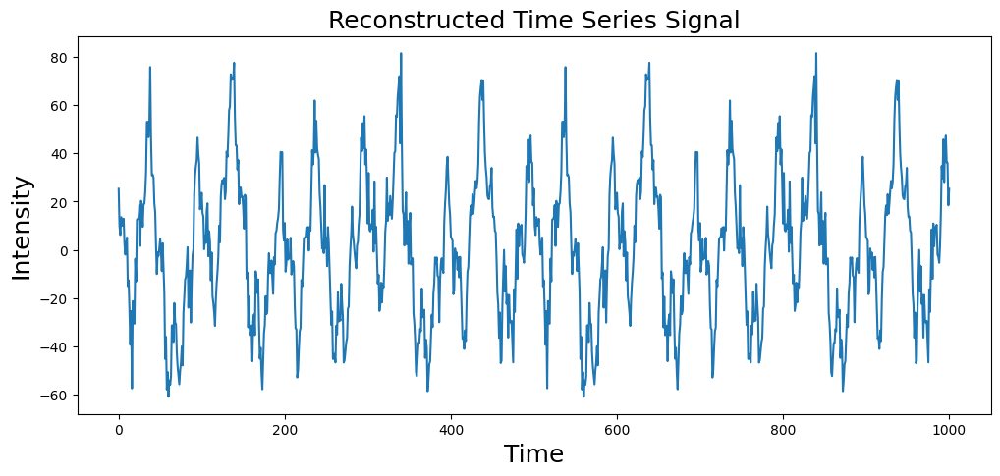

In [ ]:
plt.figure(figsize=(12,5))
plt.plot(np.dot(fourier, sine_waves)/2)
plt.ylabel('Intensity', fontsize=18)
plt.xlabel('Time', fontsize=18)
plt.title('Reconstructed Time Series Signal', fontsize=18)

## Fast Fourier Transform

Fast fourier transform is just an algorithm that executes the fourrier transform but faster. Here is the import, just to add some code to this section.

In [ ]:
from numpy.fft import fft, ifft, fftfreq


## Convolution Theorem


Convolution in the time domain is the same as multiplication in the frequency domain. This means that time domain convolution computations can be performed much more efficiently in the frequency domain via simple multiplication.

## Filters

They act uppon the frequency domain to reduce or increase the amplitude of some frenquecies. Therefore, once converted back to the time domain, they can remove some of the frequencies from the original singal.

### High-Pass Filters

These filters remove the lower frequencies

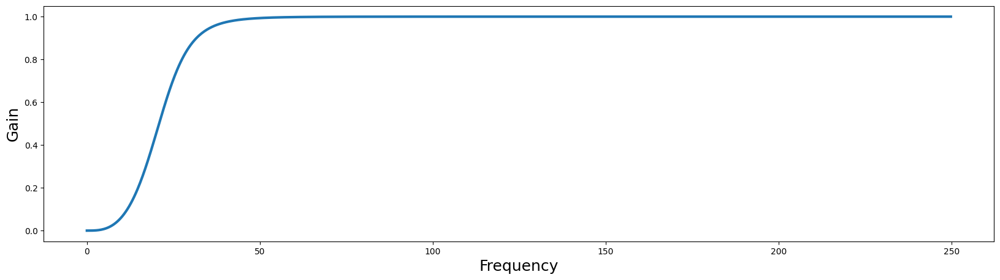

In [ ]:
from scipy.signal import butter, filtfilt, freqz, sosfreqz

# Example of high pass filter

filter_order = 3
frequency_cutoff = 25
sampling_frequency = 500

# Create the filter
# b and a are the filter constructed from the butter function
# Butterworth digital and analog filter design = butter
# Returns the both numerator and denominator of the filters polynomials
b, a = butter(filter_order, frequency_cutoff, btype='high', output='ba', fs=sampling_frequency)

# Convert from Hz to radians
def rad_sample_to_hz(x, fs):
    return (x*fs)/(2*np.pi)

# Just plot the filters frequency response
# Freqz computes the response of a digital filter
# It returns first the frequencies the response was computed and the response
# itself
def plot_filter(b, a, fs):
    plt.figure(figsize=(20,5))
    w, h = freqz(b, a, worN=512*2, whole=False)
    plt.plot(rad_sample_to_hz(w, fs), abs(h), linewidth=3)
    plt.ylabel('Gain', fontsize=18)
    plt.xlabel('Frequency', fontsize=18)

plot_filter(b, a, sampling_frequency)

/usr/local/lib/python3.10/dist-packages/matplotlib/cbook/__init__.py:1335: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


Text(0.5, 0, 'Time')

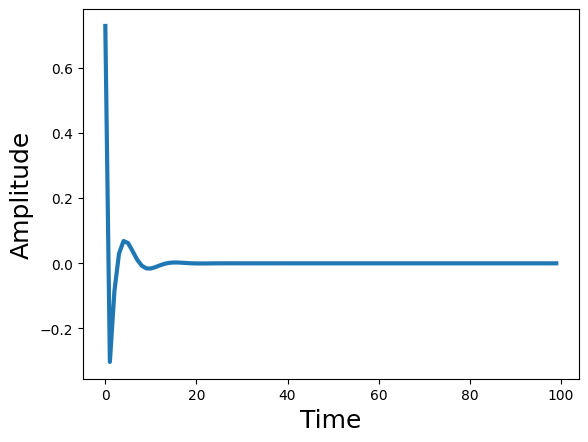

In [ ]:
# Conversion of the filter to the time domain
# First the previous filter

from scipy.signal import sosfreqz

filter_order = 8
# b, a = butter(filter_order, frequency_cutoff, btype='high', output='sos', fs=sampling_frequency)
w, h = freqz(b, a, worN=512*2, whole=False)

plt.plot(ifft(h)[0:100], linewidth=3)
plt.ylabel('Amplitude', fontsize=18)
plt.xlabel('Time', fontsize=18)

Text(0.5, 0, 'Time')

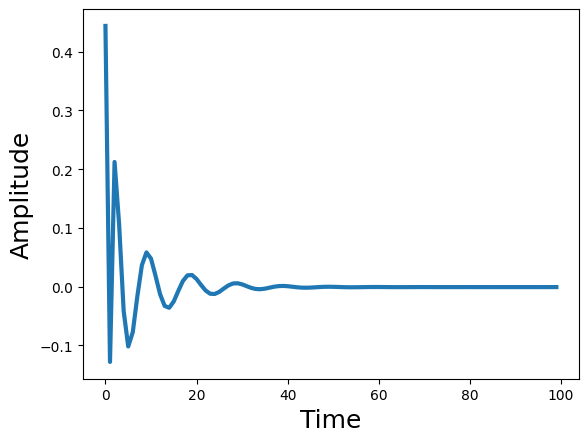

In [ ]:
# Now the course filter

from scipy.signal import sosfreqz

filter_order = 8
sos = butter(filter_order, frequency_cutoff, btype='high', output='sos', fs=sampling_frequency)
w_sos, h_sos = sosfreqz(sos)

plt.plot(ifft(h_sos)[0:100], linewidth=3)
plt.ylabel('Amplitude', fontsize=18)
plt.xlabel('Time', fontsize=18)

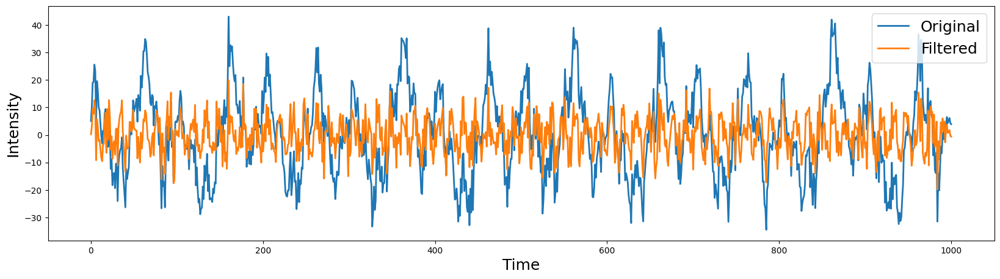

In [ ]:
# Apply filter to a signal data

filtered = filtfilt(b, a, signal)

plt.figure(figsize=(20,5))
plt.plot(signal, linewidth=2)
plt.plot(filtered, linewidth=2)
plt.ylabel('Intensity', fontsize=18)
plt.xlabel('Time', fontsize=18)
plt.legend(['Original','Filtered'], fontsize=18)

### Low pass

Same as the previous but the higher frequencies are atenuated here.

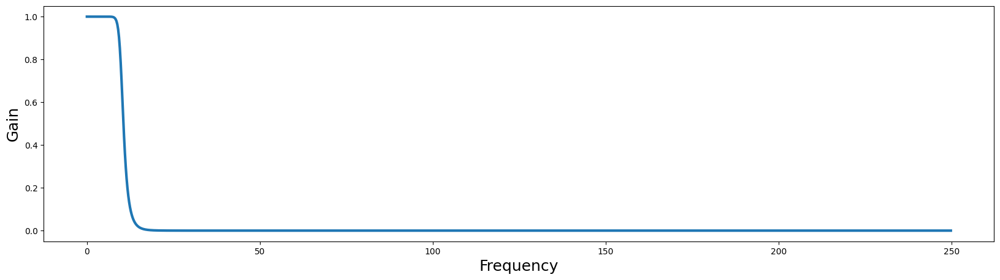

In [ ]:
# Code for low pass

filter_order = 10
frequency_cutoff = 10
sampling_frequency = 500

# Create the filter
b, a = butter(filter_order, frequency_cutoff, btype='low', output='ba', fs=sampling_frequency)

plot_filter(b, a, sampling_frequency)

### Band Pass and Band Stop


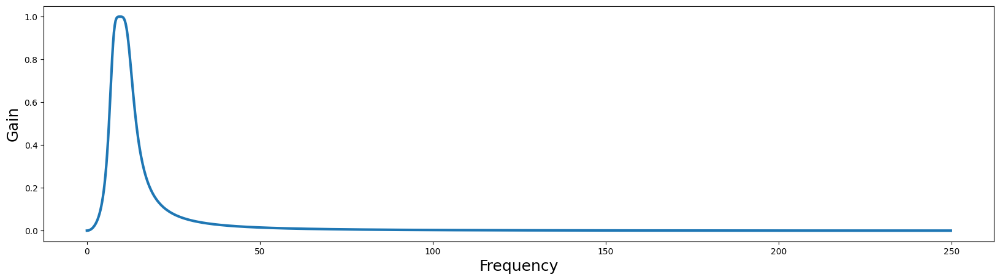

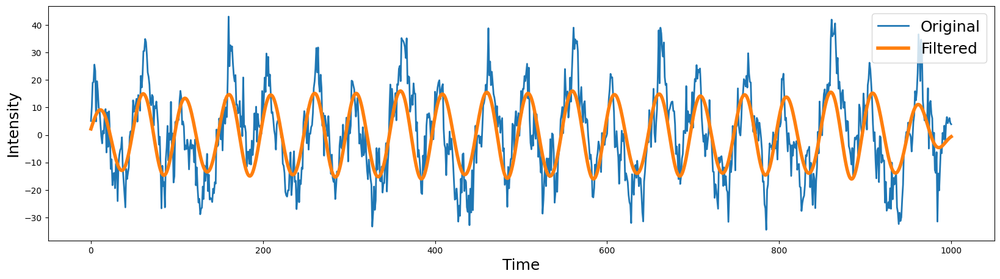

In [ ]:
# Band pass

filter_order = 2
lowcut = 7
highcut = 13

# Create the filter
b, a = butter(filter_order, [lowcut, highcut], btype='bandpass', output='ba', fs=sampling_frequency)

plot_filter(b, a, sampling_frequency)

# Apply the filter
filtered = filtfilt(b, a, signal)

plt.figure(figsize=(20,5))
plt.plot(signal, linewidth=2)
plt.plot(filtered, linewidth=4)
plt.ylabel('Intensity', fontsize=18)
plt.xlabel('Time', fontsize=18)
plt.legend(['Original','Filtered'], fontsize=18)

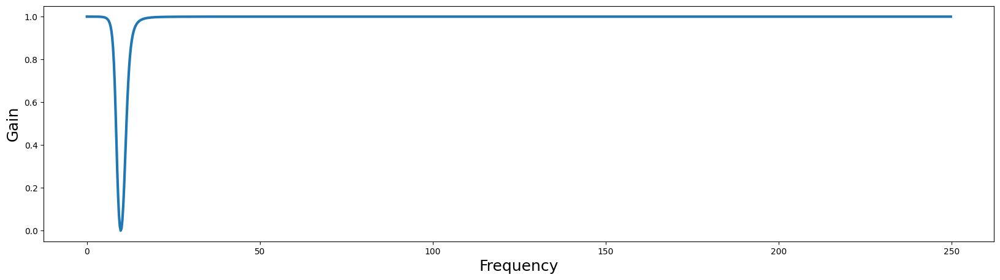

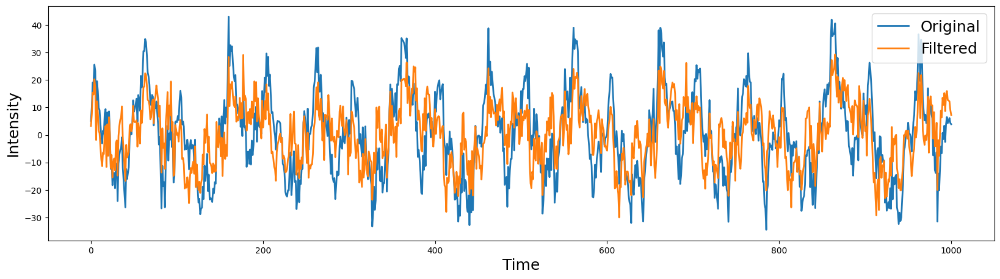

In [ ]:
# Band Stop

filter_order = 2
lowcut = 8
highcut = 12

# Create the filter
b,a = butter(filter_order, [lowcut, highcut], btype='bandstop', output='ba', fs=sampling_frequency)

# Plot the filter
plot_filter(b, a, sampling_frequency)

# Apply the filter
filtered = filtfilt(b, a, signal)

plt.figure(figsize=(20,5))
plt.plot(signal, linewidth=2)
plt.plot(filtered, linewidth=2)
plt.ylabel('Intensity', fontsize=18)
plt.xlabel('Time', fontsize=18)
plt.legend(['Original','Filtered'], fontsize=18)

## Exercises

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import butter, filtfilt, freqz, sosfreqz, impulse


from numpy.fft import fft, ifft, fftfreq

def plot_filter(b, a, fs):
    plt.figure(figsize=(20,5))
    w, h = freqz(b, a, worN=512*2, whole=False)
    plt.plot(rad_sample_to_hz(w, fs), abs(h), linewidth=3)
    plt.ylabel('Gain', fontsize=18)
    plt.xlabel('Frequency', fontsize=18)

### Exercise 1

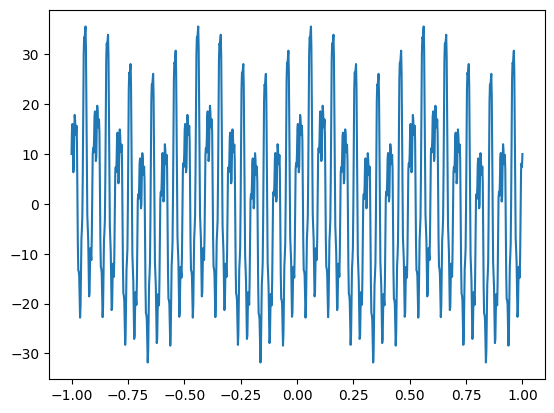

In [ ]:
# There is clearly an error in this code. I am too frustrated to fix it
# It comes from the course habit of constantly redifining the same variables
# over and over. So it gets quite messy and it is hard to see track what
# is actually being used in each operation
# There are more magnitudes than expected here

sampling_freq = 500

freq = [2, 20, 30 , 50, 100]
amplitude = [5, 20, 10, 3, 4]

time = arange(-1, 1 + 1/sampling_freq, 1/sampling_freq)

sine_waves = []
for i,f in enumerate(freq):
    sine_waves.append(amplitude[i] * sin(2*pi*f*time + phases[i]))
sine_waves = np.array(sine_waves)

signal = np.sum(sine_waves,axis=0)

plt.plot(time, signal)
plt.show()

### Exercise 2

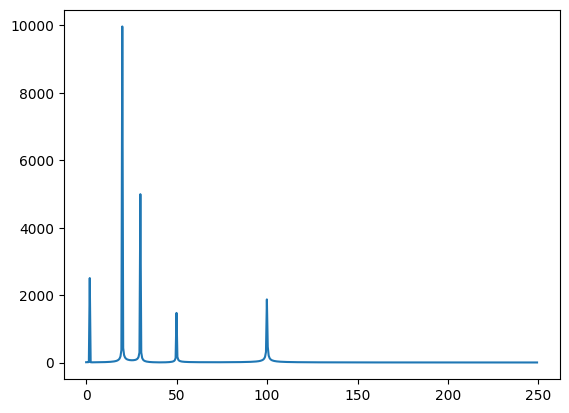

In [ ]:
fft_signal = fft(signal)

mag_fft = np.abs(fft_signal)[:int(len(signal)/2)]
freqs = fftfreq(len(signal), d=1/sampling_freq)[:int(len(signal)/2)]

plt.plot(freqs, mag_fft)
plt.show()

### Exercise 3

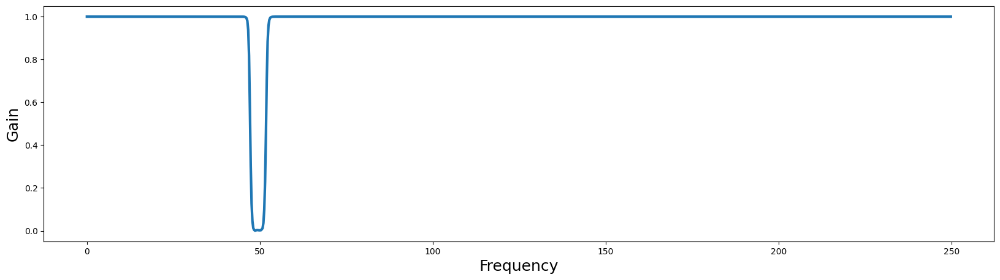

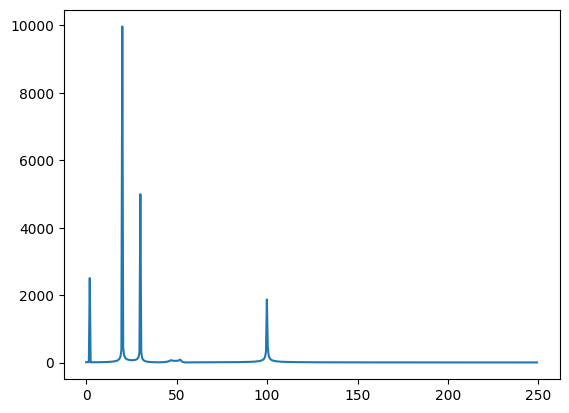

In [ ]:
filter_order = 7
lowcut = 47
highcut = 52

# Create the filter
b,a = butter(filter_order, [lowcut, highcut], btype='bandstop', output='ba', fs=sampling_frequency)

plot_filter(b, a, sampling_freq)
plt.show()

filtered_sig = filtfilt(b, a, signal)

mag_fft = np.abs(fft(filtered_sig))[:int(len(signal)/2)]
freqs = fftfreq(len(filtered_sig), d=1/sampling_freq)[:int(len(signal)/2)]

plt.plot(freqs, mag_fft)
plt.show()

### Exercise 4

1001
1001


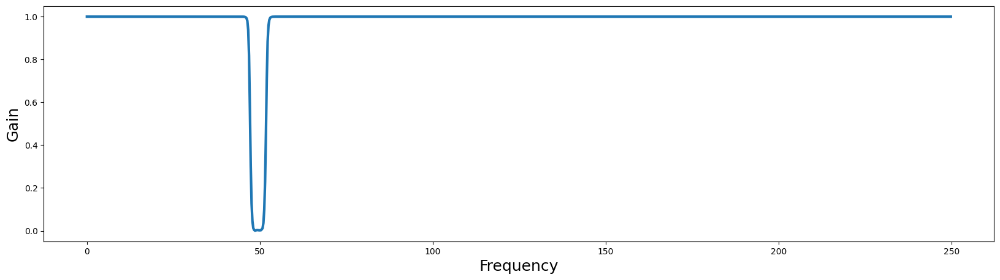

In [ ]:
# Start by getting the filter impulse response

filter_order = 7
lowcut = 47
highcut = 52

# Create the filter
b,a = butter(filter_order, [lowcut, highcut], btype='bandstop', output='ba', fs=sampling_frequency)

w, h = freqz(b, a, worN=len(signal), fs=sampling_freq)

print(len(signal))
print(len(h))

plot_filter(b, a, sampling_freq)


(1001,)
(1001,)


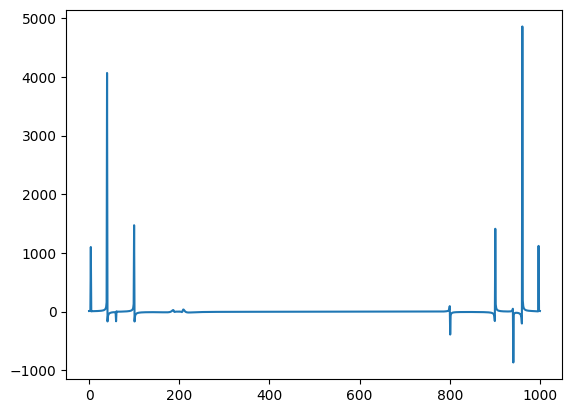

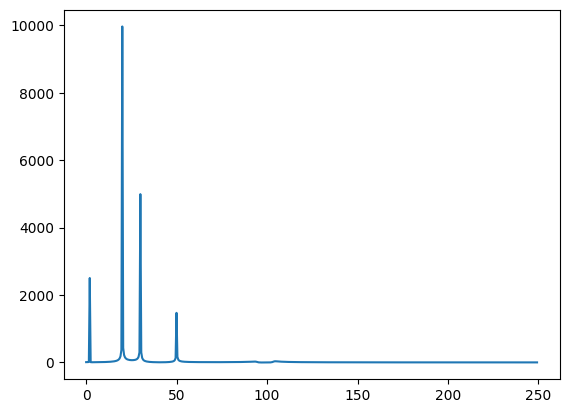

In [ ]:
# Perform product

fft_signal = fft(signal)

filtered_signal = h * fft_signal

mag_fft = np.abs(filtered_signal)[:int(len(signal)/2)]
freqs = fftfreq(len(signal), d=1/sampling_freq)[:int(len(signal)/2)]

plt.plot(freqs, mag_fft)
plt.show()

# Preprocessing

## Rigid Body Transformation

Preprocessing brain data with fmriprep.
Topics in this section:

Image transformations
Head motion correction
Spatial Normalization
Spatial Smoothing

The transformation works through matrix multiplication. For instance of the orginal coordinates are i, j, k and the transformed coordinates are x, y, z. One example of transform is the scalling through:

$$
\begin{bmatrix}
x \\
y \\
z \\
\end{bmatrix}
=
\begin{bmatrix}
p & 0 & 0 \\
0 & q & 0 \\
0 & 0 & r \\
\end{bmatrix}
\cdot
\begin{bmatrix}
i \\
j \\
k \\
\end{bmatrix}
$$

There are other operations that refer to rotations about each axis:

$$
\begin{bmatrix}
x \\
y \\
z \\
\end{bmatrix}
=
\begin{bmatrix}
cos(θ) & -sin(θ) & 0 \\
sin(θ) & cos(θ) & 0 \\
0 & 0 & 0 \\
\end{bmatrix}
\cdot
\begin{bmatrix}
i \\
j \\
k \\
\end{bmatrix}
$$

$$
\begin{bmatrix}
x \\
y \\
z \\
\end{bmatrix}
=
\begin{bmatrix}
cos(ϕ) & 0 & sin(ϕ) \\
0 & 1 & 0 \\
-sin(ϕ) & 0 & cos(θ) \\
\end{bmatrix}
\cdot
\begin{bmatrix}
i \\
j \\
k \\
\end{bmatrix}
$$

There is one more rotation axis which was not written here.
The rotations and scaling can be combined in the following manner:

$$
\begin{bmatrix}
x \\
y \\
z \\
\end{bmatrix}
=
\begin{bmatrix}
p & 0 & 0 \\
0 & q & 0 \\
0 & 0 & r \\
\end{bmatrix}
\cdot
\begin{bmatrix}
cos(θ) & -sin(θ) & 0 \\
sin(θ) & cos(θ) & 0 \\
0 & 0 & 0 \\
\end{bmatrix}
\cdot
\begin{bmatrix}
cos(ϕ) & 0 & sin(ϕ) \\
0 & 1 & 0 \\
-sin(ϕ) & 0 & cos(θ) \\
\end{bmatrix}
\cdot
\begin{bmatrix}
i \\
j \\
k \\
\end{bmatrix}
$$

And the matrices can be combined such that:

$$
\begin{bmatrix}
x \\
y \\
z \\
\end{bmatrix}
=
\begin{bmatrix}
m_{1,1} & m_{1,2} & m_{1,3} \\
m_{2,1} & m_{2,2}  & m_{2,3} \\
m_{3,1} & m_{3,2} & m_{3,3} \\
\end{bmatrix}
\cdot
\begin{bmatrix}
i \\
j \\
k \\
\end{bmatrix}
$$

$$
\begin{bmatrix}
x \\
y \\
z \\
\end{bmatrix}
=
M
\cdot
\begin{bmatrix}
i \\
j \\
k \\
\end{bmatrix}
$$

Futhermore, there can be translations for i, j, k to x, y, z. It is the following:

$$
\begin{bmatrix}
x \\
y \\
z \\
\end{bmatrix}
=
\begin{bmatrix}
a \\
b \\
c \\
\end{bmatrix}
+
\begin{bmatrix}
i \\
j \\
k \\
\end{bmatrix}
$$

The translation can also be added to the matrix M with the following shape:

$$
\begin{bmatrix}
x \\
y \\
z \\
1 \\
\end{bmatrix}
=
\begin{bmatrix}
m_{1,1} & m_{1,2} & m_{1,3} &  a \\
m_{2,1} & m_{2,2}  & m_{2,3} & b \\
m_{3,1} & m_{3,2} & m_{3,3} & c \\
0 & 0 & 0 & 1 \\
\end{bmatrix}
\cdot
\begin{bmatrix}
i \\
j \\
k \\
1 \\
\end{bmatrix}
$$


In [ ]:
# Necessary imports for this chapter - for now

%matplotlib inline

from mpl_toolkits import mplot3d
import numpy as np
import matplotlib.pyplot as plt
from nibabel.affines import apply_affine, from_matvec, to_matvec
from scipy.ndimage import affine_transform, map_coordinates
import nibabel as nib
from ipywidgets import interact, FloatSlider
from copy import deepcopy

## Cost Function

- How do we adjust M? How good is the alignment between two brain images?
- alignment measure - a cost function

- Sum of squares - works if signal intensities and images are similar





In [ ]:
# Example of an affine cost function
# It doesn't work well on google colab as it replots a new image - be careful
# It is slowing down colab so I comment out the function

def plot_affine_cost(trans_x=0, trans_y=0):
    '''This function creates an interactive demo to highlight how a cost function works in image registration.'''
    fov = 30
    radius = 15
    x, y = np.indices((fov, fov))
    square1 = (x < radius-2) & (y < radius-2)
    square2 = ((x > fov//2 - radius//2) & (x < fov//2 + radius//2)) & ((y > fov//2 - radius//2) \
     & (y < fov//2 + radius//2))
    square1 = square1.astype(float)
    square2 = square2.astype(float)

    vec = np.array([trans_y, trans_x])

    affine = from_matvec(np.eye(2), vec)

    i_coords, j_coords = np.meshgrid(range(square1.shape[0]), range(square1.shape[1]), indexing='ij')
    coordinate_grid = np.array([i_coords, j_coords])
    coords_last = coordinate_grid.transpose(1, 2, 0)

    # Aplies the afine matrix
    transformed = apply_affine(affine, coords_last)
    coords_first = transformed.transpose(2, 0, 1)

    transformed_square = map_coordinates(square1, coords_first)
    f,a = plt.subplots(ncols=3, figsize=(15, 5))
    a[0].imshow(transformed_square)
    a[0].set_xlabel('x', fontsize=16)
    a[0].set_ylabel('y', fontsize=16)
    a[0].set_title('Target Image', fontsize=18)

    a[1].imshow(square2)
    a[1].set_xlabel('x', fontsize=16)
    a[1].set_ylabel('y', fontsize=16)
    a[1].set_title('Reference Image', fontsize=18)

    point_x = deepcopy(trans_x)
    point_y = deepcopy(trans_y)

    # This part calculates the SSE
    sse = np.sum((transformed_square - square2)**2)
    a[2].bar(0, sse)
    a[2].set_ylim([0, 350])
    a[2].set_ylabel('SSE', fontsize=18)
    a[2].set_xlabel('Cost Function', fontsize=18)
    a[2].set_xticks([])
    a[2].set_title(f'Parameters: ({int(trans_x)},{int(trans_y)})', fontsize=20)
    plt.tight_layout()

# interact(plot_affine_cost,
#         trans_x=FloatSlider(value=0, min=-30, max=0, step=1),
#         trans_y=FloatSlider(value=0, min=-30, max=0, step=1))

Cost functions examples:

- Sum of Squared Error
- Normalized correlation
- Correlation ratio
- Mutual information or normalized mutual information
- Boundary Based Registration


## Realigment

Part of the process that accounts for pacient movement within a session.

In [ ]:
# The code below shows the example of the rotation and translation parameters
# varying throught one session

import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from bids import BIDSLayout, BIDSValidator
import os

data_dir = '/content/drive/MyDrive/Localizer/'
layout = BIDSLayout(data_dir, derivatives=True)

try:
  data = pd.read_csv(layout.get(subject='S01', scope='derivatives', extension='.tsv')[0].path, sep='\t')

  f,a = plt.subplots(ncols=2, figsize=(15,5))

  data.loc[:,['trans_x','trans_y','trans_z']].plot(ax=a[0])
  a[0].set_ylabel('Translation (mm)', fontsize=16)
  a[0].set_xlabel('Time (TR)', fontsize=16)
  a[0].set_title('Translation', fontsize=18)

  data.loc[:,['rot_x','rot_y','rot_z']].plot(ax=a[1])
  a[1].set_ylabel('Rotation (radian)', fontsize=16)
  a[1].set_xlabel('Time (TR)', fontsize=16)
  a[1].set_title('Rotation', fontsize=18)

except:
  print('Data Retrival Failed')


Data Retrival Failed


/usr/local/lib/python3.10/dist-packages/bids/layout/layout.py:516: UserWarning: Derivative indexing was requested, but no valid datasets were found in the specified locations ([PosixUPath('/content/drive/MyDrive/Localizer/derivatives')]). Note that all BIDS-Derivatives datasets must meet all the requirements for BIDS-Raw datasets (a common problem is to fail to include a 'dataset_description.json' file in derivatives datasets).
Example contents of 'dataset_description.json':
{"Name": "Example dataset", "BIDSVersion": "1.0.2", "GeneratedBy": [{"Name": "Example pipeline"}]}
  warnings.warn("Derivative indexing was requested, but no valid "


## Spatial Normalization

The main one is called spatial normalization, in which each subject’s brain data is warped into a common stereotactic space

algotithm - diffeomorphic registration



## Spatial normalization of the anatomical T1w reference

fmriprep uses the ANTs to perform nonlinear spatial normaliziation

## Alignment of functional and anatomical MRI data

We can evaluate the quality of alignment of the functional data to the anatomical T1 image. FSL flirt was used to generate transformations from EPI-space to T1w-space - The white matter mask calculated with FSL fast (brain tissue segmentation) was used for BBR.

## Spatial Smoothing

Applying a 3D filter to the image to remove high-frequency components

Increase the signal to noise ratio by reducing the impact of partial volume effects, residual anatomical differences following normalization, and other aliasing from applying spatial transformation.

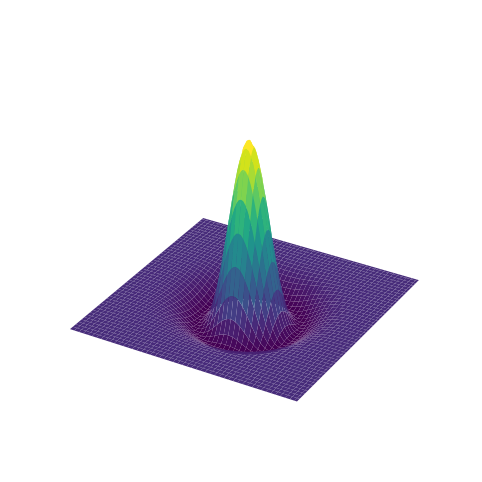

In [ ]:
# 3D Gaussian Kernel

def plot_gaussian(sigma=2, kind='surface', cmap='viridis', linewidth=1, **kwargs):
    '''Generates a 3D matplotlib plot of a Gaussian distribution'''
    mean=0
    domain=10
    x = np.arange(-domain + mean, domain + mean, sigma/10)
    y = np.arange(-domain + mean, domain + mean, sigma/10)
    x, y = np.meshgrid(x, x)
    r = (x ** 2 + y ** 2) / (2 * sigma ** 2)
    z = 1 / (np.pi * sigma ** 4) * (1 - r) * np.exp(-r)

    fig = plt.figure(figsize=(12, 6))

    ax = plt.axes(projection='3d')
    if kind=='wire':
        ax.plot_wireframe(x, y, z, cmap=cmap, linewidth=linewidth, **kwargs)
    elif kind=='surface':
        ax.plot_surface(x, y, z, cmap=cmap, linewidth=linewidth, **kwargs)
    else:
        NotImplemented

    ax.set_xlabel('x', fontsize=16)
    ax.set_ylabel('y', fontsize=16)
    ax.set_zlabel('z', fontsize=16)
    plt.axis('off')

plot_gaussian(kind='surface', linewidth=1)

## fmriprep

- Pipiline = Fmriprep performs basic processing steps (coregistration, normalization, unwarping, noise component extraction, segmentation, skullstripping etc.) providing outputs that are ready for data analysis.

- fmriprep was built on top of nipype, which is a tool to build preprocessing pipelines in python using graphs.

- docker container that contains everything you need to run the pipeline

In [ ]:
# Code to run fmri prep

import os
base_dir = '/content/drive/MyDrive/Localizer/'
data_path = os.path.join(base_dir, 'localizer')
output_path = os.path.join(base_dir, 'preproc')
work_path = os.path.join(base_dir, 'work')

# fmriprep - docker is not installed in colab so it's normal that this does not work

sub = 'S01'
subs = [f'S{x:0>2d}' for x in range(10)]
for sub in subs:
    !fmriprep-docker {data_path} {output_path} participant --participant_label sub-{sub} --write-graph --fs-no-reconall --notrack --fs-license-file ~/Dropbox/Dartbrains/License/license.txt --work-dir {work_path}

/bin/bash: line 1: fmriprep-docker: command not found
/bin/bash: line 1: fmriprep-docker: command not found
/bin/bash: line 1: fmriprep-docker: command not found
/bin/bash: line 1: fmriprep-docker: command not found
/bin/bash: line 1: fmriprep-docker: command not found
/bin/bash: line 1: fmriprep-docker: command not found
/bin/bash: line 1: fmriprep-docker: command not found
/bin/bash: line 1: fmriprep-docker: command not found
/bin/bash: line 1: fmriprep-docker: command not found
/bin/bash: line 1: fmriprep-docker: command not found


## Exercise

Open a subject html - here it is

In [ ]:
# Output of fmri prep

from IPython.display import HTML

sub_01_html = '/content/drive/MyDrive/Localizer/derivatives/fmriprep/sub-S01.html'

HTML(sub_01_html)

## Fmri prep - important issue

 - fmriprep, is unfortunately in its current state not easily customizable. If you disagree with the developers about the order or specific preprocessing steps, it is very difficult to modify.

# Introduction to the GLM


In [ ]:
# Necessary modules for this chapter

%matplotlib inline

import os
import glob
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from nltools.stats import regress
from nltools.external import glover_hrf


## Simulate a voxel time course

- Simulate a time series for a single voxel

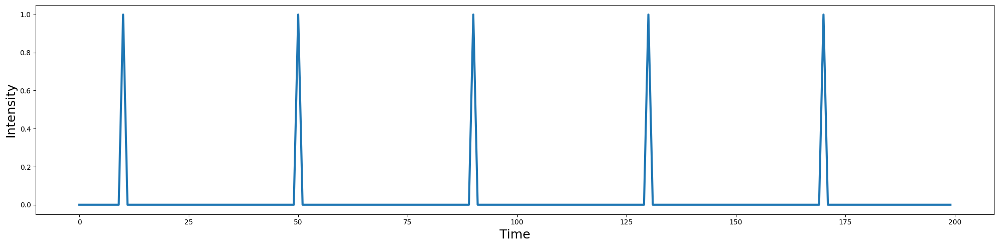

In [ ]:
# Function that produces time series data with a pulse at each 40 time units

n_tr = 200
n_trial = 5
face = np.zeros(n_tr)
face[np.arange(10, n_tr, int(n_tr/n_trial))] = 1

def plot_timeseries(data, labels=None, linewidth=3, title=None):
    '''Plot a timeseries

    Args:
        data: (np.ndarray) signal varying over time, where each column is a different signal.
        labels: (list) labels which need to correspond to the number of columns.
        linewidth: (int) thickness of line
    '''
    plt.figure(figsize=(20,5))
    plt.plot(data, linewidth=linewidth)
    plt.ylabel('Intensity', fontsize=18)
    plt.xlabel('Time', fontsize=18)
    if title is not None:
      plt.title(title)
    plt.tight_layout()
    if labels is not None:
        if len(labels) != data.shape[1]:
            raise ValueError('Need to have the same number of labels as columns in data.')
        plt.legend(labels, fontsize=18)

plot_timeseries(face)

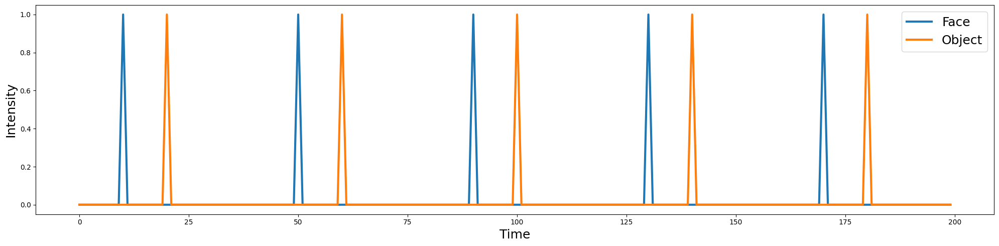

In [ ]:
# This one produces another time series that triggers every 40 seconds , but it's offset by 10 seconds

n_tr = 200
n_trial = 5
face = np.zeros(n_tr)
face[np.arange(10, n_tr, int(n_tr/n_trial))] = 1
obj = np.zeros(n_tr)
obj[np.arange(20, n_tr, int(n_tr/n_trial))] = 1
voxel = np.vstack([face,obj]).T

plot_timeseries(voxel, labels=['Face', 'Object'])

In [ ]:
# Checking voxel data - It's a transpose matrix of both time-series

print(voxel)

[[0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [1. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 1.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [1. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 1.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [1. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 1.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 

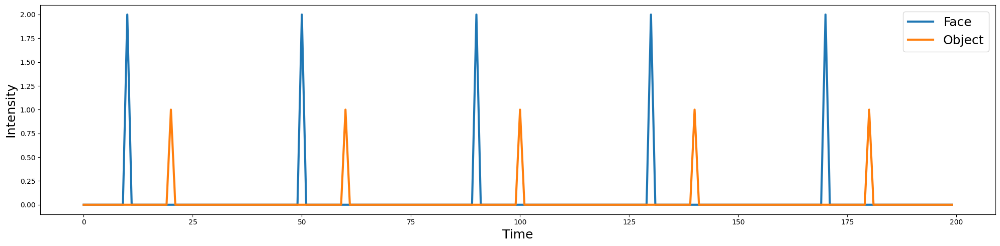

In [ ]:
# Small change of amplitude - face time series has an amplitude of 2

n_tr = 200
n_trial = 5
face_intensity = 2
object_intensity = 1

face = np.zeros(n_tr)
face[np.arange(10, n_tr, int(n_tr/n_trial))] = face_intensity
obj = np.zeros(n_tr)
obj[np.arange(20, n_tr, int(n_tr/n_trial))] = object_intensity
voxel = np.vstack([face,obj]).T

plot_timeseries(voxel, labels=['Face', 'Object'])

Text(0.5, 0, 'Time')

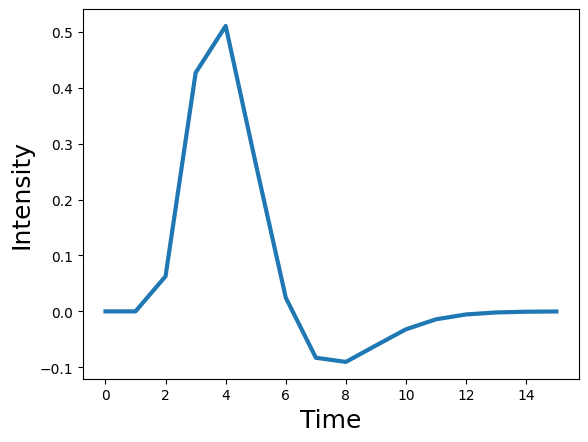

In [ ]:
# Here is the HRF function - It will be convolved with the pulse time series to generate the neural signal
# The pulse time series indicates when the events happened - the biological response comes from the HRF

tr = 2
hrf = glover_hrf(tr, oversampling=1)
plt.plot(hrf, linewidth=3)
plt.ylabel('Intensity', fontsize=18)
plt.xlabel('Time', fontsize=18)

face (200,)
obj (200,)
voxel (200, 2)
hrf (16,)


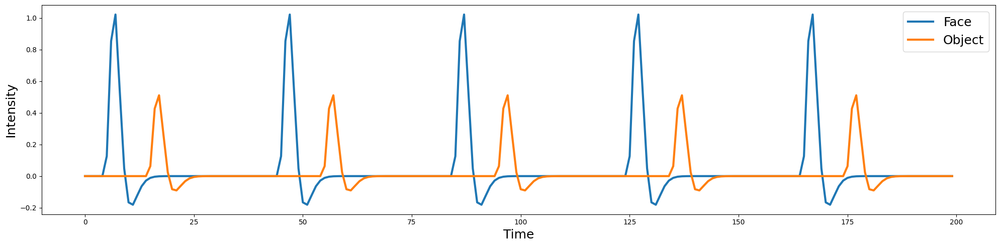

In [ ]:
# Here is the convolution signal
# Checking shapes before plot

print('face', face.shape)
print('obj', obj.shape)
print('voxel', voxel.shape)
print('hrf', hrf.shape)

face_conv = np.convolve(face, hrf, mode='same')
obj_conv = np.convolve(obj, hrf, mode='same')
voxel_conv = np.vstack([face_conv, obj_conv]).T

plot_timeseries(voxel_conv, labels=['Face', 'Object'])

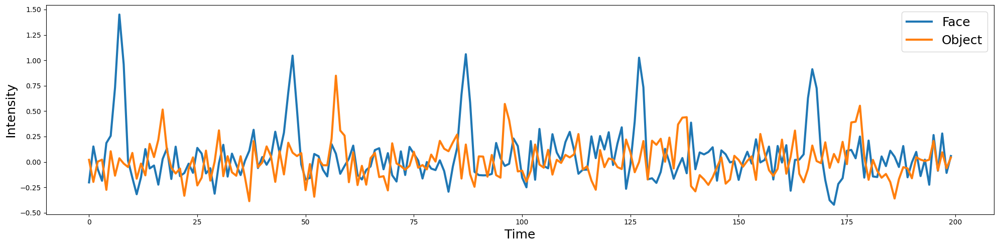

In [ ]:
# Add some noise - real response is more caotic

sigma = 0.15
epsilon = sigma*np.random.randn(n_tr, 2)
voxel_conv_noise = voxel_conv + epsilon

plot_timeseries(voxel_conv_noise, labels=['Face', 'Object'])

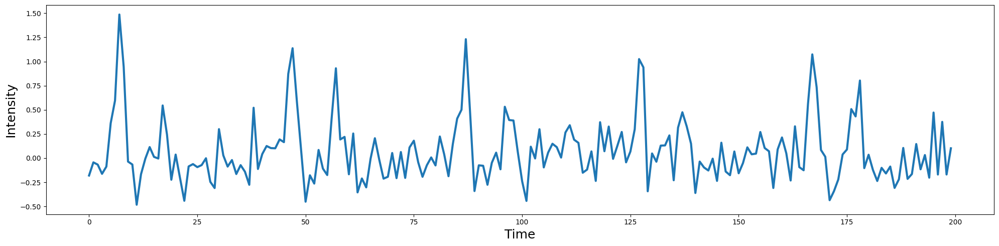

In [ ]:
# This is a single voxel time series simulated. We would observe the sum of both of those series

Y = voxel_conv_noise.sum(axis=1)

plot_timeseries(Y)

## Construct Design Matrix

Recover the original signal using a general linear model in the form of:

$$
Y = XΒ + ϵ
$$

Y is the observed series and X is our model of the design matrix. Epsilon is independent Gaussian noise.

[[ 1.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.00000000e+00  6.28941574e-02  0.00000000e+00]
 [ 1.00000000e+00  4.26730903e-01  0.00000000e+00]
 [ 1.00000000e+00  5.10566523e-01  0.00000000e+00]
 [ 1.00000000e+00  2.64126724e-01  0.00000000e+00]
 [ 1.00000000e+00  2.42913838e-02  0.00000000e+00]
 [ 1.00000000e+00 -8.29535564e-02  0.00000000e+00]
 [ 1.00000000e+00 -9.04082736e-02  0.00000000e+00]
 [ 1.00000000e+00 -6.09213993e-02  0.00000000e+00]
 [ 1.00000000e+00 -3.19919014e-02  0.00000000e+00]
 [ 1.00000000e+00 -1.41464436e-02  0.00000000e+00]
 [ 1.00000000e+00 -5.48406408e-03  6.28941574e-02]
 [ 1.00000000e+00 -1.91225973e-03  4.26730903e-01]
 [ 1.00000000e+00 -6.10716753e-04  5.10566523e-01]
 [ 1.00000000e+00 -1.81076075e-04  2.64126724e-01]
 [ 1.00000000e+00  0.00000000e+

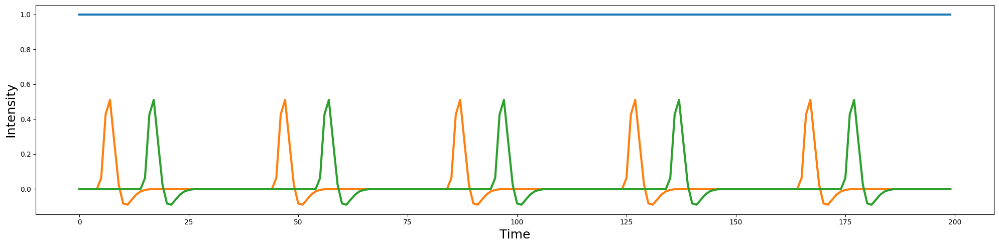

In [ ]:
n_tr = 200
n_trial = 5
face = np.zeros(n_tr)
face[np.arange(10, n_tr, int(n_tr/n_trial))] = 1
obj = np.zeros(n_tr)
obj[np.arange(20, n_tr, int(n_tr/n_trial))] = 1
intercept = np.ones(n_tr)
X = np.vstack([intercept, np.convolve(face, hrf, mode='same'), np.convolve(obj, hrf, mode='same')]).T

plot_timeseries(X)

print(X)

## GLM dimension check

Just to write down the dimensions.

Let ts be the time series length

The X signal is tsx3 - where one column is the incerpt and the others are the signal for taks and rest

There are 3 betas, so it's a 3x1 matrix

So the output - (ts x 3) x (3 x 1) = (ts x 1)

## Estimate the GLM

QUESTION: FOUND THE Y OVER X

Voxel timeseries Y - design matrix X - Fit model through $Β$ estimation

Equation that maximizes the
$$
β' = (X^T X)^{-1} X^T Y
$$

I solved for the optimization myself. I set the error to the following:
$$
ϵ = \frac{1}{2} (Y - Xβ)^2
$$
$$
\frac{d ϵ}{d β} = X(Y - Xβ)
$$
Setting $$\frac{d ϵ}{d β} = 0$$
We get
$$
X \beta = Y
$$
Since X is not necessarily squared, and it needs to be squared to be inversible, multiply by transpose:
$$
X^T X \beta = X^T Y
$$
It results in:
$$
\beta = (X^T X)^{-1} X^T Y
$$

In Matlab, we can write:
$$
\beta = \frac{Y}{X}
$$
which performs the minimization ofsum of squared errors of the following expression:
$$
X \beta = Y
$$



beta Faces - beta Objects: 0.97


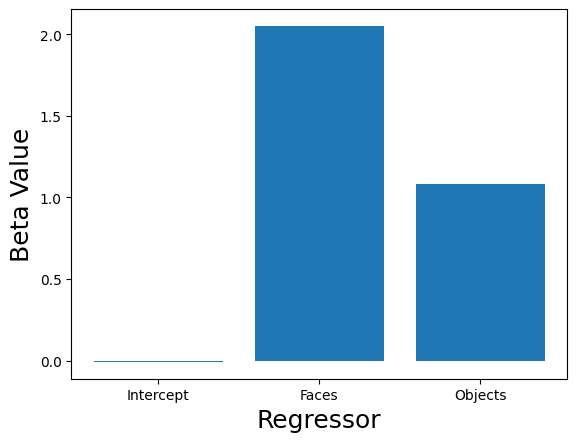

In [ ]:
# Fitting the GLM to the data using the previous expression

def ols_estimator(X, Y):
    return np.dot(np.dot(np.linalg.pinv(np.dot(X.T, X)), X.T), Y)

beta = ols_estimator(X, Y)

plt.bar(['Intercept','Faces', 'Objects'], beta)
plt.xlabel('Regressor', fontsize=18)
plt.ylabel('Beta Value', fontsize=18)

print(f'beta Faces - beta Objects: {beta[1]-beta[2]:.2}')

Text(0.5, 1.0, 'Residual')

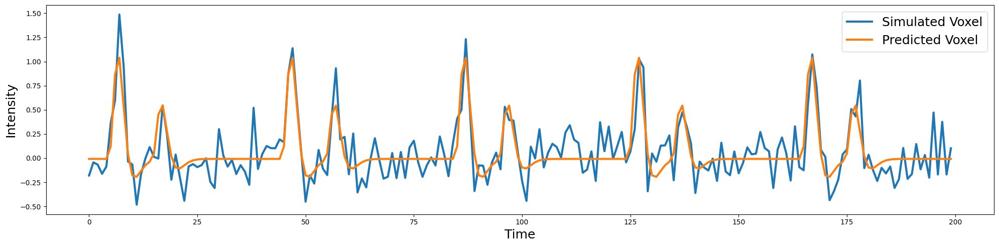

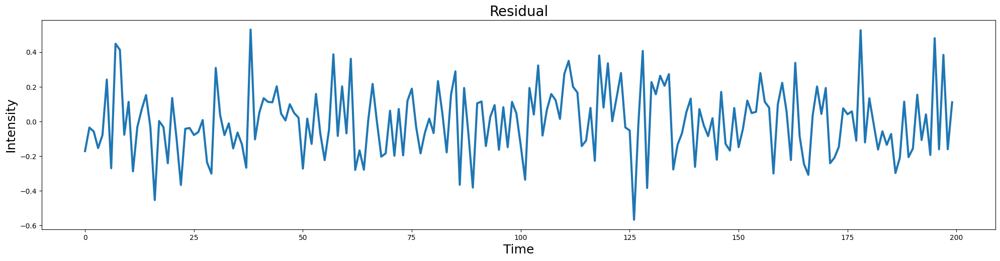

In [ ]:
# Calculating the residuals

predicted_y = np.dot(X, beta)

predicted_ts = np.vstack([Y, predicted_y]).T

plot_timeseries(predicted_ts, labels=['Simulated Voxel', 'Predicted Voxel'])

residual = Y - predicted_y

plot_timeseries(residual)
plt.title('Residual', fontsize=20)

## Standard Errors

The standard error of the estimate refers to the standard deviation of the residual.

Formally it is:
$$
σ = \sqrt{\frac{\sum^n_i(y_i - y_i')^2}{n - k}}
$$
It is also called residual variance.

The smaller the residual variance the better the fit of the model.

Standard Error of the Estimate: 0.2


Text(0.5, 0, 'Prediction Error')

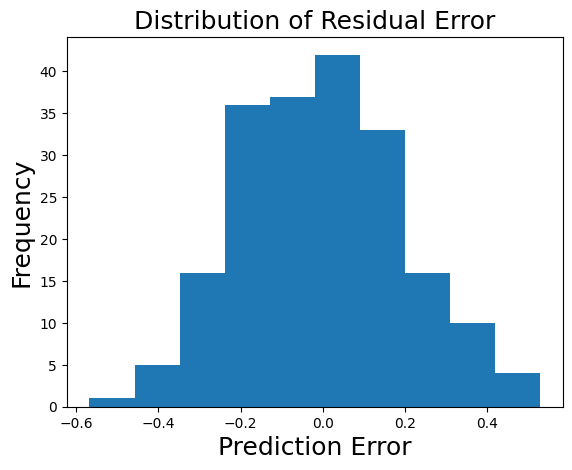

In [ ]:
# Residual Error Distribution

standard_error_of_estimate = np.std(residual)

print(f"Standard Error of the Estimate: {standard_error_of_estimate:.2}")

plt.hist(residual)
plt.title('Distribution of Residual Error', fontsize=18)
plt.ylabel('Frequency', fontsize=18)
plt.xlabel('Prediction Error', fontsize=18)

## Explained Variance

A metric that explains how well our model was able to explain the variance in the data - goodness of fit - R^2

$$
R^2 = 1 - \frac{\sum^n_i(y_i - y_i')^2}{\sum^n_i(y_i - \bar{y})^2}
$$

- So the R^2 predictor estimates how good the model can explain the variance. It is because how much it deviates for a standard fit with just an average value? Yes.


In [ ]:
def r_square(Y, predicted_y):
    SS_total = np.sum((Y - np.mean(Y))**2)
    SS_residual = np.sum((Y - predicted_y)**2)
    return 1-(SS_residual/SS_total)

print(f"R^2: {r_square(Y, predicted_y):.2}")

R^2: 0.63


## Standard Error of Beta estimates

We can also estimate the uncertainty of regression coefficients. The uncertainty of the beta parameters is quantified as a standard error around each specific estimate.

I didn't like the explanation provided so I asked chat GPT -
It basically gives the confidence interval for each parameter and it is the square root of the squared of the residual variance devided by the sum of squared differences of each column of the design matrix by the mean of each column (predictor mean)

For regressor \beta_j, it is noted as $SE(β_j)$ - (The course uses $σ$ which I find confusing, as it is also the notation for regressor variance)



Text(0, 0.5, 'Beta Value')

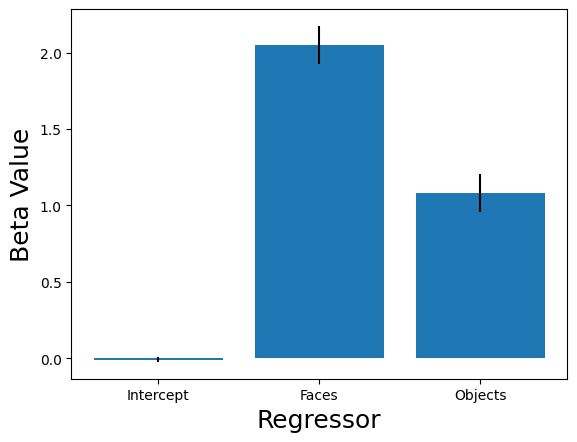

In [ ]:
std_error = np.sqrt(np.diag((np.linalg.pinv(np.dot(X.T, X))))) * standard_error_of_estimate

plt.bar(['Intercept','Faces', 'Objects'], beta, yerr = std_error)
plt.xlabel('Regressor', fontsize=18)
plt.ylabel('Beta Value', fontsize=18)

## Statistical Significance

The statistical significance of each regressor is:

$$
t = \frac{β_j}{σ_j}
$$

As it is a t value, we can find a p-value using student's t distribution.



## Contrasts

- They allow the estimation of the statistical significance of operations between the regressors

Example in this GLM case:

then, the corresponding contrast code or vector for faces would be:

[0, 1, 0]

The contrast code for the object condition would be:

[0, 0, 1]

and importantly the contrast between the face and object condition would be:

[0, 1, -1]

{('[0, 0, 1]', 1.0827379557054106),
 ('[0, 1, -1]', 0.9678691518297322),
 ('[0, 1, 0]', 2.050607107535143)}

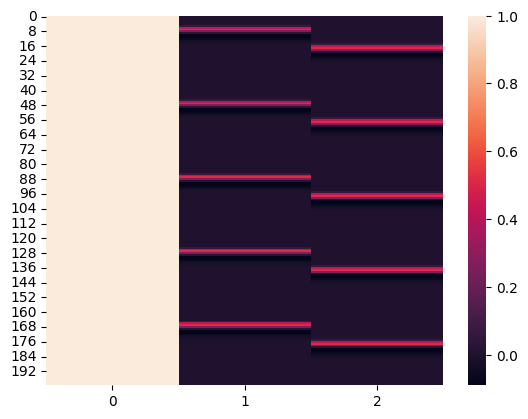

In [ ]:
# Calculated the constrasts here

sns.heatmap(X)

c1 = [0, 1, 0]
c2 = [0, 0, 1]
c3 = [0, 1, -1]

{(str(c),np.dot(beta, c)) for c in [c1, c2, c3]}

## Eficiency

The efficiency, or the quality of an estimator for a specific experimental design or a hypothesis testing procedure. Efficiency is related to power, or the ability to detect an effect should one exist. However, unlike power, we can estimate efficiency from our design matrix and do not actually need to know the standard error for the model.

$$
E = \frac{1}{c(X^T X)^-1 c^T}
$$

Reducing collinearity or covariance between regressors can increase design efficiency

## Inter-Trial Interval with Jittering

All of the examples so far have used a fixed inter-trial interval. However, in real experiments it is almost always a good idea to vary the inter-trial interval using jitter. This helps to decouple the slice acquisition with the experimental design to better sample the hemodynamic response over multiple trials. In addition, this can help reduce the temporal correlation between regressors modeling events that may be sequentially dependent.



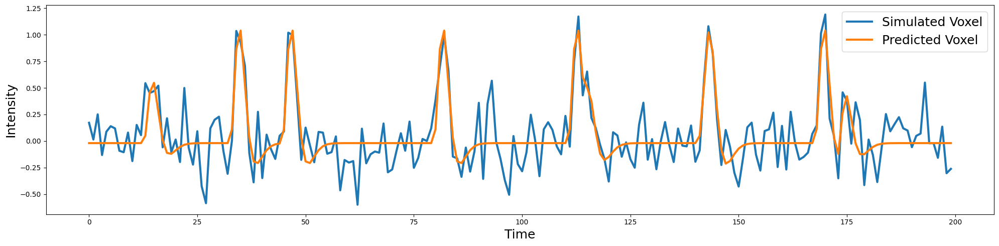

In [ ]:
# Code implementation of Jittering using random intervals

# Set Simulation Parameters
n_tr = 200
n_trial = 5
face_intensity = 2
object_intensity = 1
sigma = 0.15

# Build Simulation
face_trials = np.random.randint(10, 180, n_trial)
obj_trials = np.random.randint(10, 180, n_trial)
face = np.zeros(n_tr)
face[face_trials] = 1
obj = np.zeros(n_tr)
obj[obj_trials] = 1
voxel_conv = np.vstack([np.convolve(face*face_intensity, hrf, mode='same'), np.convolve(obj*object_intensity, hrf, mode='same')]).T
epsilon = sigma*np.random.randn(n_tr, 2)
voxel_conv_noise = voxel_conv + epsilon

# Build Model
Y = voxel_conv_noise.sum(axis=1)
X = np.vstack([np.ones(len(face)), np.convolve(face, hrf, mode='same'), np.convolve(obj, hrf, mode='same')]).T

# Estimate Model
beta = ols_estimator(X, Y)
predicted_y = np.dot(X, beta)
predicted_sigma = np.std(residual)
predicted_ts = np.vstack([Y, predicted_y]).T
plot_timeseries(predicted_ts, labels=['Simulated Voxel', 'Predicted Voxel'])

## Exercises

### Exercise 1


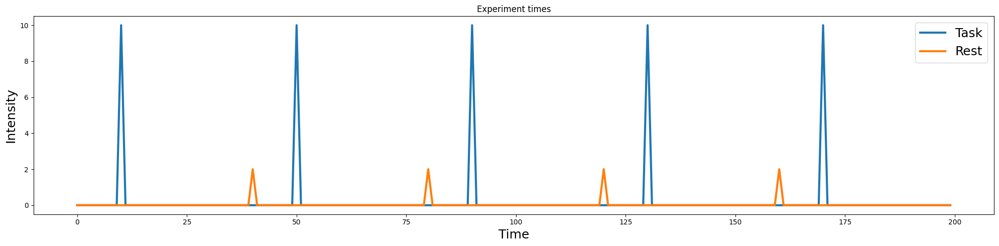

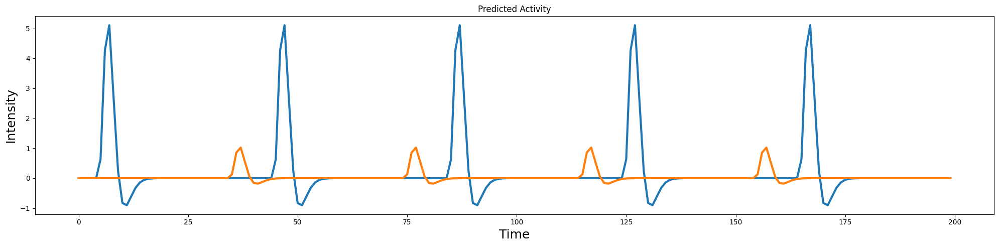

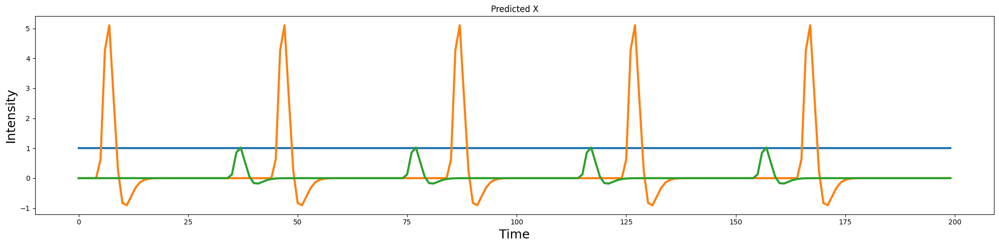

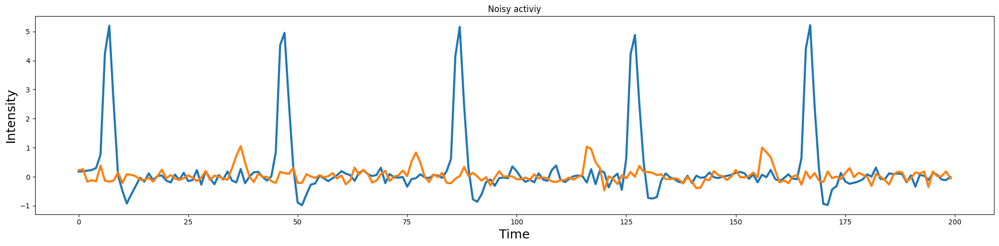

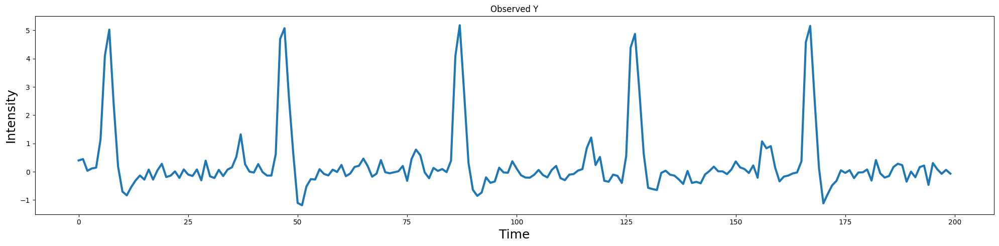

In [ ]:
# Start by defining a new signal

# Small change of amplitude - face time series has an amplitude of 2

# Set Simulation Parameters

n_tr = 200
n_trial = 5
task_intensity = 10
# Yeah rest intensity is stupid - I suck at naming this.
# This makes no sense fMRI experiment-wise
rest_intensity = 2

task = np.zeros(n_tr)
task[np.arange(10, n_tr, int(n_tr/n_trial))] = task_intensity
rest = np.zeros(n_tr)
rest[np.arange(40, n_tr, int(n_tr/n_trial))] = rest_intensity
ex_voxel = np.vstack([task, rest]).T

plot_timeseries(ex_voxel, labels=['Task', 'Rest'], title='Experiment times')

task = np.convolve(task, hrf, mode='same')
rest = np.convolve(rest, hrf, mode='same')
ex_voxel = np.vstack([task, rest]).T

plot_timeseries(ex_voxel, title='Predicted Activity')

# Before adding noise - Let us extract X
intercept = np.ones(n_tr)
X = np.vstack([intercept, task, rest]).T

plot_timeseries(X, title='Predicted X')


sigma = 0.15
epsilon = sigma*np.random.randn(n_tr, 2)
ex_voxel = ex_voxel + epsilon

plot_timeseries(ex_voxel, title="Noisy activiy")

Y = ex_voxel.sum(axis=1)

plot_timeseries(Y, title='Observed Y')

[0.00414111 1.00342605 0.92417886]


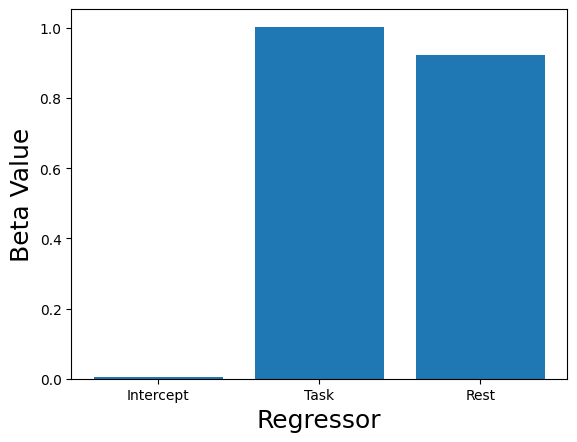

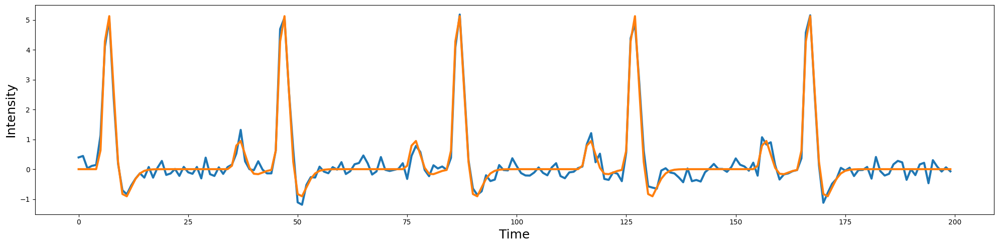

In [ ]:
B = np.dot(np.dot(np.linalg.pinv(np.dot(X.T, X)), X.T), Y)

plt.bar(['Intercept','Task', 'Rest'], B)
plt.xlabel('Regressor', fontsize=18)
plt.ylabel('Beta Value', fontsize=18)

print(B)

predicted_y = np.dot(X, B)

predicted_ts = np.vstack([Y, predicted_y]).T

plot_timeseries(predicted_ts)

Clearly increasing amplitude improves the fit.

## Exercise 4

[0.00288839 0.96447806 0.94145611]


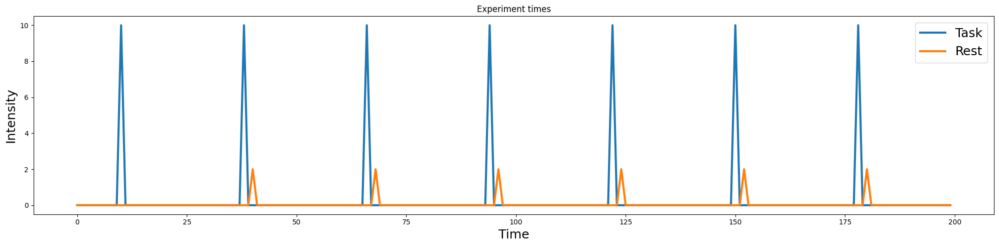

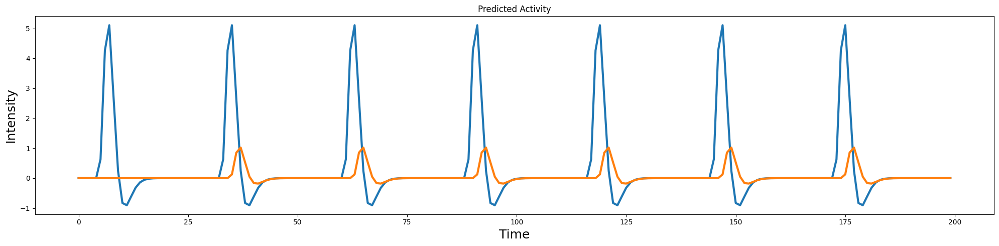

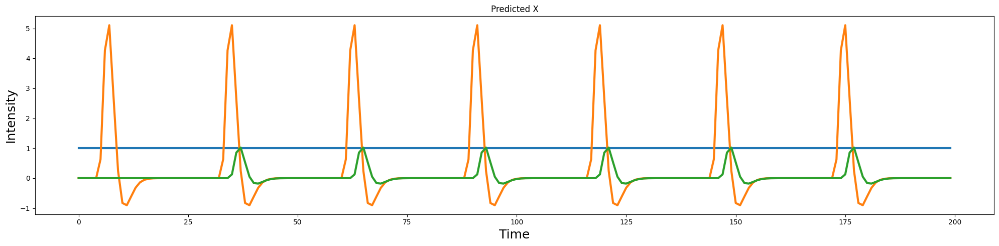

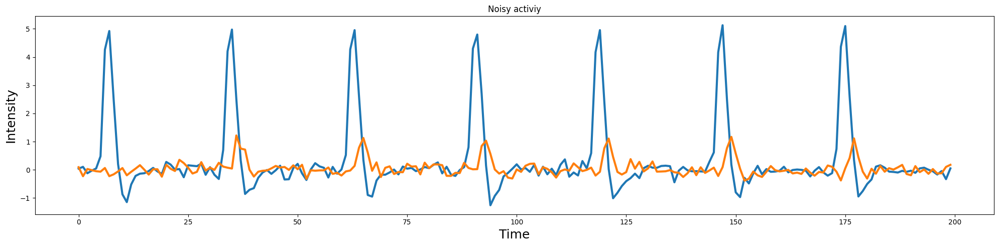

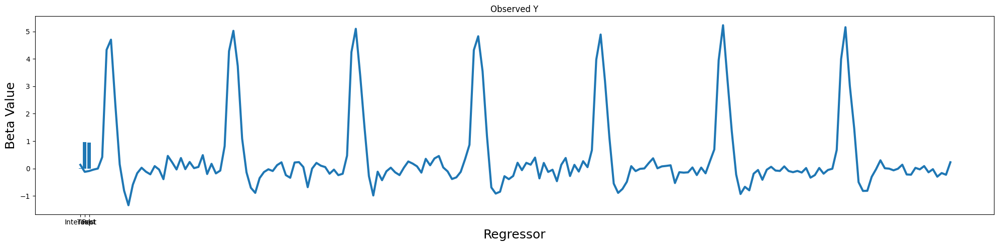

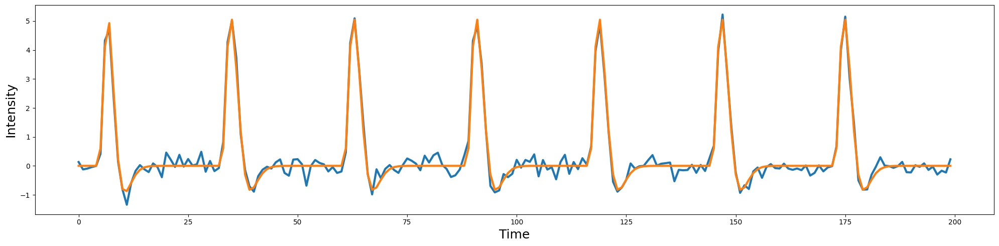

In [ ]:
# Start by defining a new signal

# Small change of amplitude - face time series has an amplitude of 2

# Set Simulation Parameters

n_tr = 200
n_trial_1 = 7
n_trial_2 = 7
task_intensity = 10
# Yeah rest intensity is stupid - I suck at naming this.
# This makes no sense fMRI experiment-wise
rest_intensity = 2

task = np.zeros(n_tr)
task[np.arange(10, n_tr, int(n_tr/n_trial_1))] = task_intensity
rest = np.zeros(n_tr)
rest[np.arange(40, n_tr, int(n_tr/n_trial_2))] = rest_intensity
ex_voxel = np.vstack([task, rest]).T

plot_timeseries(ex_voxel, labels=['Task', 'Rest'], title='Experiment times')

task = np.convolve(task, hrf, mode='same')
rest = np.convolve(rest, hrf, mode='same')
ex_voxel = np.vstack([task, rest]).T

plot_timeseries(ex_voxel, title='Predicted Activity')

# Before adding noise - Let us extract X
intercept = np.ones(n_tr)
X = np.vstack([intercept, task, rest]).T

plot_timeseries(X, title='Predicted X')


sigma = 0.15
epsilon = sigma*np.random.randn(n_tr, 2)
ex_voxel = ex_voxel + epsilon

plot_timeseries(ex_voxel, title="Noisy activiy")

Y = ex_voxel.sum(axis=1)

plot_timeseries(Y, title='Observed Y')

B = np.dot(np.dot(np.linalg.pinv(np.dot(X.T, X)), X.T), Y)

plt.bar(['Intercept','Task', 'Rest'], B)
plt.xlabel('Regressor', fontsize=18)
plt.ylabel('Beta Value', fontsize=18)

print(B)

predicted_y = np.dot(X, B)

predicted_ts = np.vstack([Y, predicted_y]).T

plot_timeseries(predicted_ts)

The predictions were not that affected by the number of trs. I am assuming that this is the result of a high signal to noise ratio

# Modeling Single Subject Data

Subject first-level model and will cover the following topics:

- Building a design matrix

- Modeling noise in the GLM with nuisance variables

- Estimating GLM

- Performing basic contrasts

## Building a Design Matrix

In [ ]:
# Initial code

%matplotlib inline

import os
import glob
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import nibabel as nib
from nltools.file_reader import onsets_to_dm
from nltools.stats import regress, zscore
from nltools.data import Brain_Data, Design_Matrix
from nltools.stats import find_spikes
from nilearn.plotting import view_img, glass_brain, plot_stat_map
from bids import BIDSLayout, BIDSValidator

# Change data directory based on used drive
data_dir = '/content/drive/MyDrive/Localizer/'
layout = BIDSLayout(data_dir, derivatives=True)

/usr/local/lib/python3.10/dist-packages/bids/layout/validation.py:123: UserWarning: The PipelineDescription field was superseded by GeneratedBy in BIDS 1.4.0. You can use ``pybids upgrade`` to update your derivative dataset.
  warnings.warn("The PipelineDescription field was superseded "


In [ ]:
# This code builds the design matrix

# THERE IS A BUG IN THE get_tr function
# Given this, I inputed it manually - 2.4 seconds

def load_bids_events(layout, subject):
    '''Create a design_matrix instance from BIDS event file'''

    tr = 2.4
    n_tr = nib.load(layout.get(subject=subject, scope='raw', suffix='bold')[0].path).shape[-1]

    onsets = pd.read_csv(layout.get(subject=subject, suffix='events')[0].path, sep='\t')
    onsets.columns = ['Onset', 'Duration', 'Stim']
    return onsets_to_dm(onsets, sampling_freq=1/tr, run_length=n_tr)

dm = load_bids_events(layout, 'S01')

display(dm)

,video_computation,horizontal_checkerboard,audio_right_hand,audio_sentence,video_right_hand,audio_left_hand,video_left_hand,vertical_checkerboard,audio_computation,video_sentence
0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...
123,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
124,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
125,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
126,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


The onsets_to_dm function returns a pandas dataframe so it retains normal df functionalities

In [ ]:
dm.head()

,video_computation,horizontal_checkerboard,audio_right_hand,audio_sentence,video_right_hand,audio_left_hand,video_left_hand,vertical_checkerboard,audio_computation,video_sentence
0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


<Axes: >

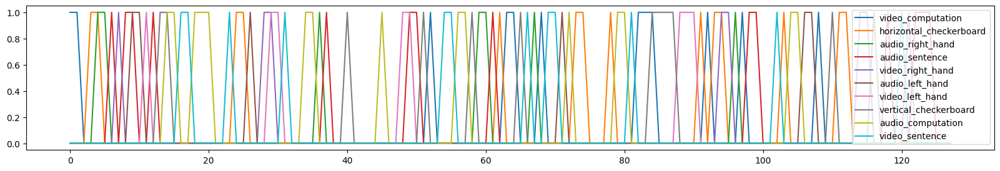

In [ ]:
# This plots the regressors

f,a = plt.subplots(figsize=(20,3))
dm.plot(ax=a)

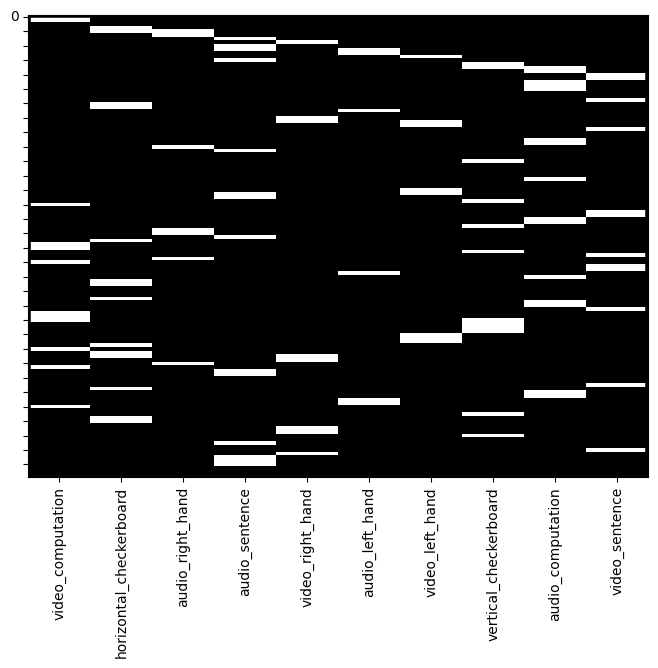

In [ ]:
# Better visualisation of regressors

dm.heatmap()

## HRF Convolution

Just like the previous chapter, we perform a convolution to predict neural based on the execution of the given tasks. When each task is performed, the hrf response is activated in certain areas of the brain. The nltools.data.design_matrix.Design_Matrix has a convolution operation programmed into it.

<class 'nltools.data.design_matrix.Design_Matrix'>


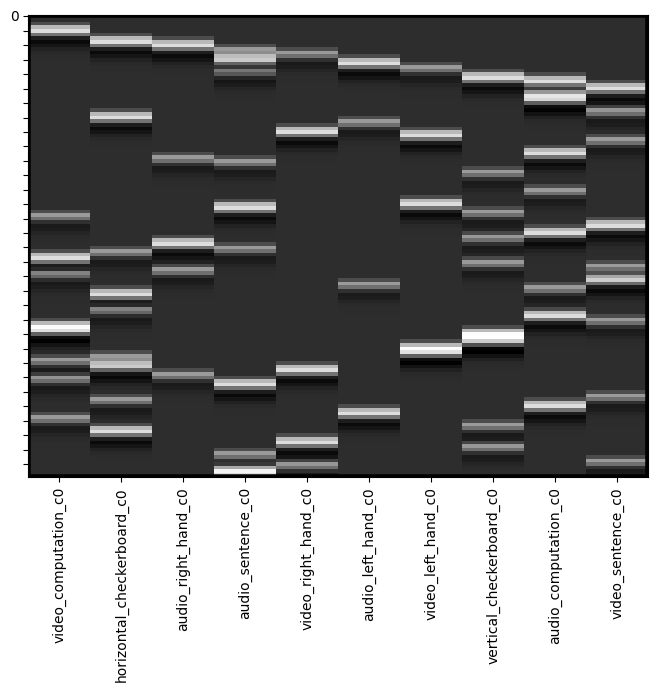

In [ ]:
print(type(dm))
dm_conv = dm.convolve()
dm_conv.heatmap()

<Axes: >

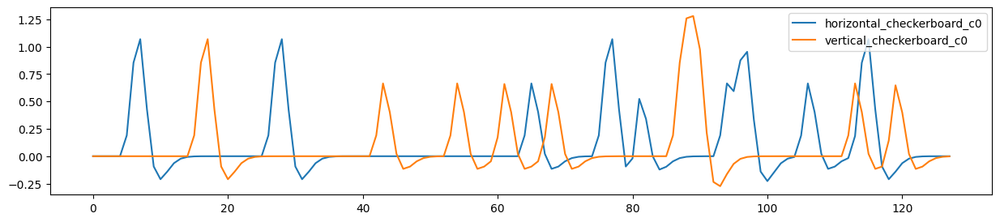

In [ ]:
# We plot two regressors here for better visualization


f,a = plt.subplots(figsize=(15,3))
dm_conv[['horizontal_checkerboard_c0','vertical_checkerboard_c0']].plot(ax=a)

## Multicollinearity

Collinearity or Multicollinearity - where one regressor can be strongly predicted from others

Interested in variance of single regressors
Interested in - Idependent variance from each regressor from X to Y


Estimation - examine the pairwise correlations between each regressor. We plot the correlation matrix as a heatmap.

<Axes: >

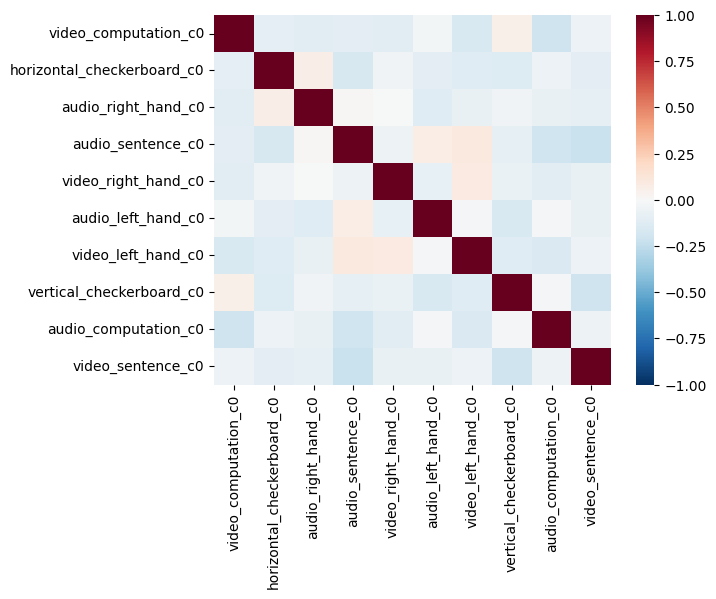

In [ ]:
sns.heatmap(dm_conv.corr(), vmin=-1, vmax=1, cmap='RdBu_r')

## Variance Inflation Factor

- Can one regressor be explained by three or more of the remaining regressors? The variance inflation factor (VIF) is a metric that can help us detect multicollinearity.

- The formula supplied in the course has a notation issue

The corrected formula:
$$
\text{VIF}_j = \frac{1}{1 - R^2_j}
$$

R_j is obtained from the R^2 value of the following regression:
$$
X_j = a_{1,j} X_{1} + a_{2,j} X_{2} + .... + a_{n,j} X_{n} + b_j
$$


Text(0, 0.5, 'Variance Inflation Factor')

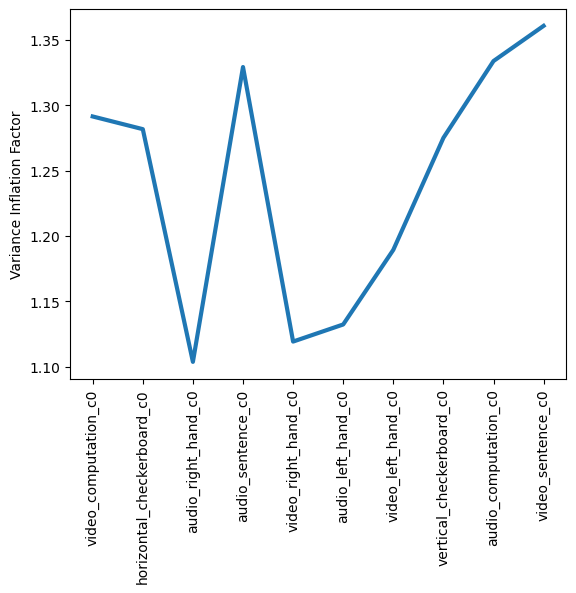

In [ ]:
# Here we calculate the VIF of each regressor

plt.plot(dm_conv.columns, dm_conv.vif(), linewidth=3)
plt.xticks(rotation=90)
plt.ylabel('Variance Inflation Factor')

## Orthogonalization

- Not that important according to the own course, so I just paste and read it lol

It is commonly thought that using a procedure called orthogonalization should be used to address issues of multicollinearity. In linear algebra, orthogonalization is the process of prioritizing shared variance between regressors to a single regressor. Recall that the standard GLM already accounts for shared variance by removing it from individual regressors. Orthogonalization allows a user to assign that variance to a specific regressor. However, the process of performing this procedure can introduce artifact into the model and often changes the interpretation of the beta weights in unanticipated ways.

- PCA could also be a pontential solution to merge regressors with high colinearity

## Filtering

Not so well explained in the course, does really explain what it does.
First the context:

Recall from our signal processing tutorial, that there are often other types of artifacts in our signal that might take the form of slow or fast oscillations. It is common to apply a high pass filter to the data to remove low frequency artifacts. Often this can also be addressed by simply using a few polynomials to model these types of trends. If we were to directly filter the brain data using something like a butterworth filter as we did in our signal processing tutorial, we would also need to apply it to our design matrix to make sure that we don’t have any low frequency drift in experimental design. One easy way to simultaneously perform both of these procedures is to simply build a filter into the design matrix. We will be using a discrete cosine transform (DCT), which is a basis set of cosine regressors of varying frequencies up to a filter cutoff of a specified number of seconds. Many software use 100s or 128s as a default cutoff, but we encourage caution that the filter cutoff isn’t too short for your specific experimental design. Longer trials will require longer filter cutoffs. See this paper for a more technical treatment of using the DCT as a high pass filter in fMRI data analysis. In addition, here is a more detailed discussion about filtering.

This is a high pass filter - so only frequencies above the cutoff will be removed. It's used mostly to deal with the slower drift from the data.
The 128 seconds removes everything bellow 0.0078 which is way less than the frequency of our signal of interest - range from 0.01 to 0.1

<Axes: >

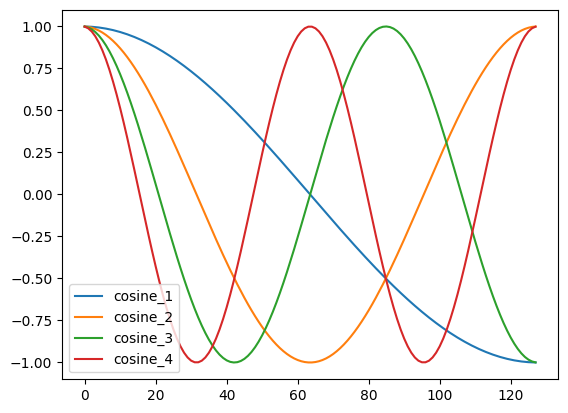

In [ ]:
dm_conv_filt = dm_conv.add_dct_basis(duration=128)

dm_conv_filt.iloc[:,10:].plot()

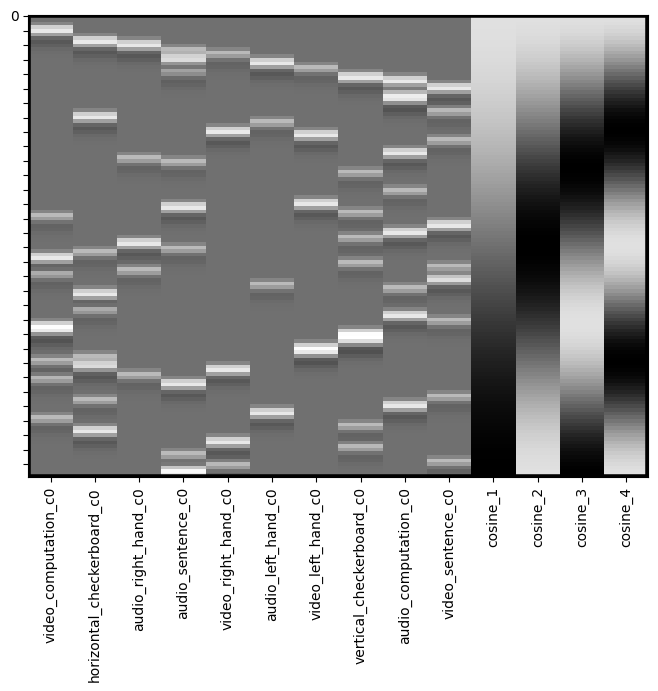

In [ ]:
### ----- QUESTION --------, what is this? Could you talk more about it?

dm_conv_filt = dm_conv.add_dct_basis(duration=128)
dm_conv_filt.heatmap()

## Intercepts

-  The baseline, or the average voxel response during the times that are not being modeled as a regressor.

- You can add an intercept by simply creating a new column of ones (e.g., dm['Intercept] = 1). Here we provide an example using the .add_poly() method, which adds an intercept by default.

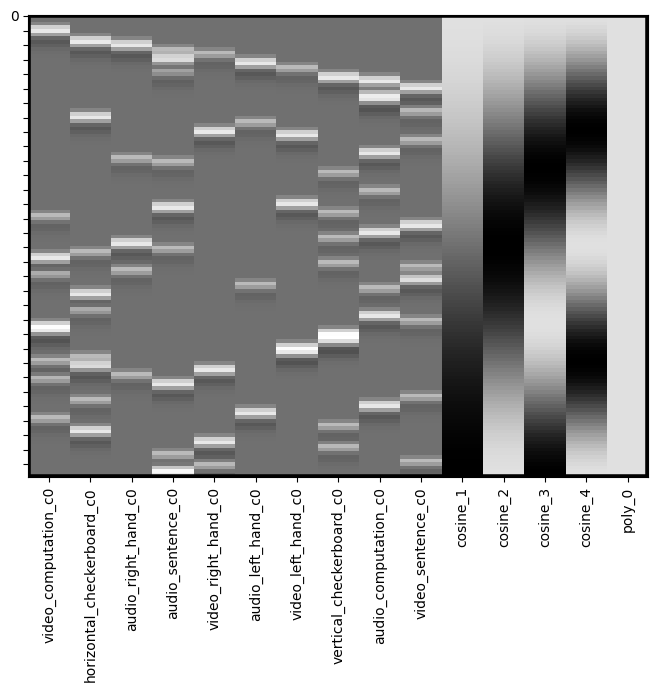

In [ ]:
dm_conv_filt_poly = dm_conv_filt.add_poly()
dm_conv_filt_poly.heatmap()

In [ ]:
sub = 'S01'

data_dir = '/content/drive/MyDrive/Localizer/derivatives/fmriprep' + \
'/sub-S01/func/sub-S01_task-localizer_space-MNI152NLin2009cAsym_desc-preproc_bold.nii'

data = Brain_Data(data_dir)

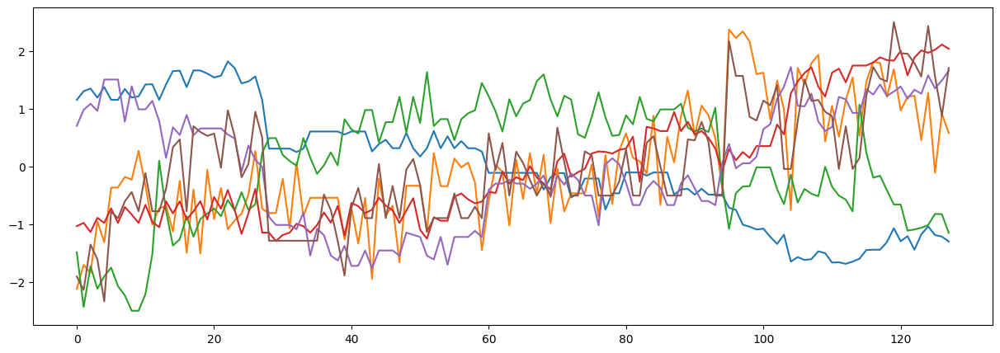

In [ ]:
# Analise motion regressor info

cov_dir = '/content/drive/MyDrive/Localizer/derivatives/fmriprep' + \
'/sub-S01/func/sub-S01_task-localizer_desc-confounds_regressors.tsv'

covariates = pd.read_csv(cov_dir, sep='\t')

mc = covariates[['trans_x','trans_y','trans_z','rot_x', 'rot_y', 'rot_z']]

plt.figure(figsize=(15,5))
plt.plot(zscore(mc))

<Axes: >

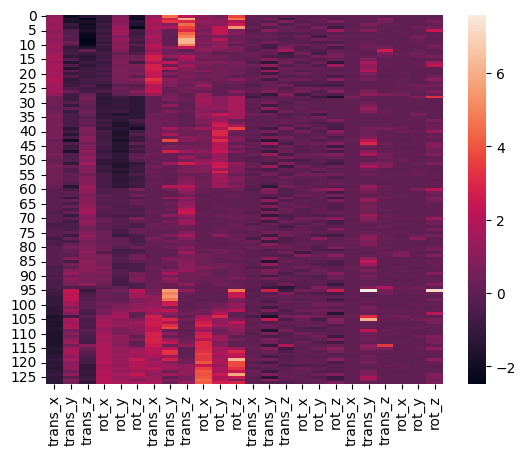

In [ ]:
#### QUESTION - Covariates for each subject - Motion regressors ######

# These are the 24 covariates related to head motion
# So motion was regressed? - Absorb coefficients non related to motion
# Add to desing matrix

def make_motion_covariates(mc, tr):
    z_mc = zscore(mc)
    all_mc = pd.concat([z_mc, z_mc**2, z_mc.diff(), z_mc.diff()**2], axis=1)
    all_mc.fillna(value=0, inplace=True)
    return Design_Matrix(all_mc, sampling_freq=1/tr)

tr = layout.get_tr()
mc_cov = make_motion_covariates(mc, tr)

sns.heatmap(mc_cov)

Text(0, 0.5, 'Intensity')

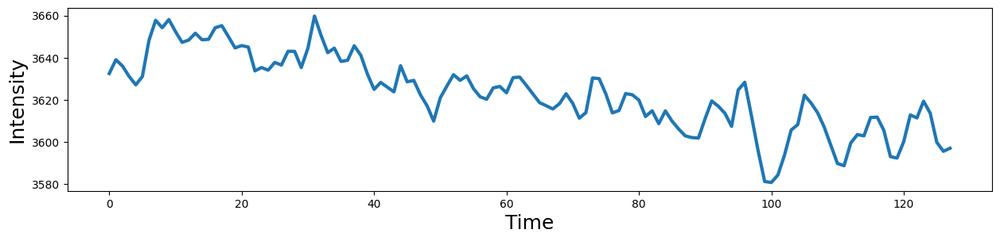

In [ ]:
# Average intensity of voxels over time - There is a drift in the data

plt.figure(figsize=(15,3))
plt.plot(np.mean(data.data, axis=1), linewidth=3)
plt.xlabel('Time', fontsize=18)
plt.ylabel('Intensity', fontsize=18)

This slow drift is removed with a high pass filter

Other artifact called spikes - sudden change in voxel amplitude
This is what is being detected by the code below:

Chat GPT explanation -
In neuroscience data analysis, spikes generally refer to sudden, brief increases in signal amplitude—essentially, outlier events that deviate from the background activity. These can be artifacts or represent significant neural events, depending on the context.

/usr/local/lib/python3.10/dist-packages/nltools/stats.py:1767: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  outlier["diff_spike" + str(i + 1)].iloc[int(loc)] = 1
/usr/local/lib/python3.10/dist-packages/nltools/stats.py:1767: FutureWarning: 

<Axes: >

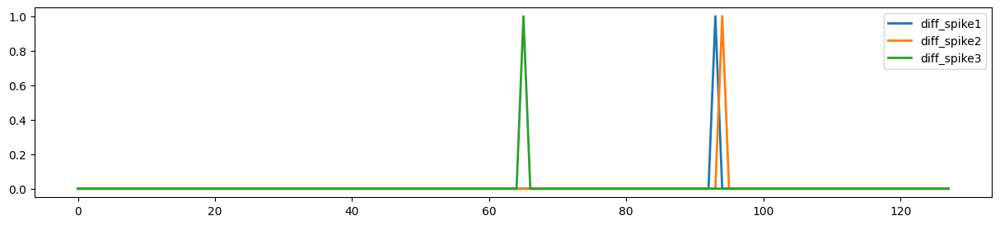

In [ ]:
# Pandas hates iloc, and I hate pandas for hating it

spikes = data.find_spikes(global_spike_cutoff=2.5, diff_spike_cutoff=2.5)

f, a = plt.subplots(figsize=(15,3))
spikes = Design_Matrix(spikes.iloc[:,1:], sampling_freq=1/tr)
spikes.plot(ax = a, linewidth=2)

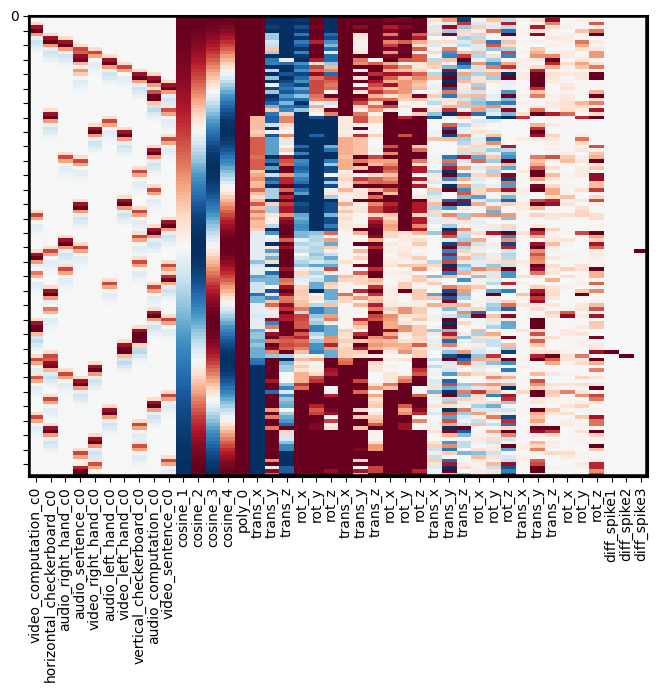

In [ ]:
# Combine all regressors together - Motion - filter - intercept

dm_conv_filt_poly_cov = pd.concat([dm_conv_filt_poly, mc_cov, spikes], axis=1)
dm_conv_filt_poly_cov.heatmap(cmap='RdBu_r', vmin=-1,vmax=1)

## Smothing

- Apply gaussian filter in image to increase SNR

To increase the signal to noise ratio and clean up the data, it is common to apply spatial smoothing to the image.

Here we will convolve the image with a 3-D gaussian kernel, with a 6mm full width half maximum (FWHM) using the .smooth() method.

In [ ]:
fwhm=6
smoothed = data.smooth(fwhm=fwhm)

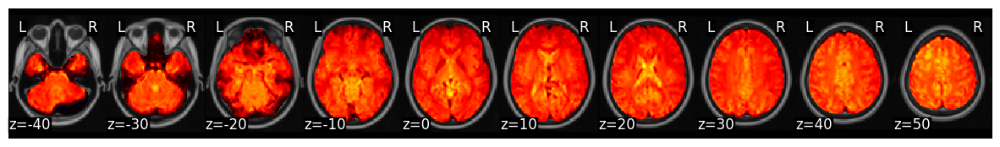

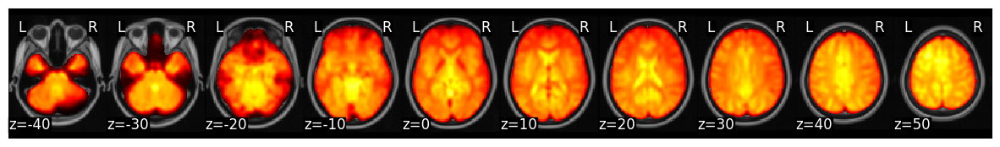

In [ ]:
# Comparison between non-smoothed data and smoothed data

data.mean().plot()
smoothed.mean().plot()

--------- QUESTION -----------

At initial inspection it does look like it removes a lot of the details from the image, which is interesting. Is this really removing noise?
It could be just decreasing spatial variance, giving the impression of a better signal, but it's just a lower variance one.

## Estimating the GLM

Finally, we estimate the single subject GLM.

In [ ]:
smoothed.X = dm_conv_filt_poly_cov
stats = smoothed.regress()

print(stats.keys())
print(stats['beta'])

dict_keys(['beta', 't', 'p', 'df', 'sigma', 'residual'])
nltools.data.brain_data.Brain_Data(data=(42, 238955), Y=(0, 0), X=(0, 0), mask=MNI152_T1_2mm_brain_mask.nii.gz)


Notation guide
- tp - number of time points mesurements
- voxels - number of voxels
- reg - number of regressors

Dimension check - So Y has one time series for each voxel. It's the single subject level brain data. So
- Y dimensions = (tp x voxels)

We have 42 regressors - task, motion, cosine filter etc - X is a conjuntion of time series with the activation of each regressor - thus:
- X dimensions = (tp x regressors)

For each voxel, each regressor has a value of beta (B - here), which results in:
- B dimensions = (regressors x voxel) -> consistent with GLM results

In [ ]:
# Final code of lab before exercises

print(smoothed.X.columns)
stats['beta'][0].iplot()

Index(['video_computation_c0', 'horizontal_checkerboard_c0',
       'audio_right_hand_c0', 'audio_sentence_c0', 'video_right_hand_c0',
       'audio_left_hand_c0', 'video_left_hand_c0', 'vertical_checkerboard_c0',
       'audio_computation_c0', 'video_sentence_c0', 'cosine_1', 'cosine_2',
       'cosine_3', 'cosine_4', 'poly_0', 'trans_x', 'trans_y', 'trans_z',
       'rot_x', 'rot_y', 'rot_z', 'trans_x', 'trans_y', 'trans_z', 'rot_x',
       'rot_y', 'rot_z', 'trans_x', 'trans_y', 'trans_z', 'rot_x', 'rot_y',
       'rot_z', 'trans_x', 'trans_y', 'trans_z', 'rot_x', 'rot_y', 'rot_z',
       'diff_spike1', 'diff_spike2', 'diff_spike3'],
      dtype='object')


interactive(children=(FloatText(value=0.0, description='Threshold'), HTML(value='Image is 3D', description='Vo…

## Contrasts

The contrast follows the following dimension :

- (1 x regressors)

When multiplied by beta B:

- (1 x regreesors) x (regressors x voxels) = (1 x voxels)

It yields one contrast value per voxel. Thus, one can use the constrast value to t-test and figure out if the contrast is statistically significant for that voxel.

In [ ]:
# Here we write a contrast that avereges the regressors pertaining to motion
# 0.25 for each - the constrast result is consistent with my analysis above

print(smoothed.X.columns)

c1 = np.zeros(len(stats['beta']))
print(c1.shape)
c1[[2,4,5,6]] = 1/4
print(c1)

motor = stats['beta'] * c1

motor.iplot()

Index(['video_computation_c0', 'horizontal_checkerboard_c0',
       'audio_right_hand_c0', 'audio_sentence_c0', 'video_right_hand_c0',
       'audio_left_hand_c0', 'video_left_hand_c0', 'vertical_checkerboard_c0',
       'audio_computation_c0', 'video_sentence_c0', 'cosine_1', 'cosine_2',
       'cosine_3', 'cosine_4', 'poly_0', 'trans_x', 'trans_y', 'trans_z',
       'rot_x', 'rot_y', 'rot_z', 'trans_x', 'trans_y', 'trans_z', 'rot_x',
       'rot_y', 'rot_z', 'trans_x', 'trans_y', 'trans_z', 'rot_x', 'rot_y',
       'rot_z', 'trans_x', 'trans_y', 'trans_z', 'rot_x', 'rot_y', 'rot_z',
       'diff_spike1', 'diff_spike2', 'diff_spike3'],
      dtype='object')
(42,)
[0.   0.   0.25 0.   0.25 0.25 0.25 0.   0.   0.   0.   0.   0.   0.
 0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
 0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.  ]


interactive(children=(FloatText(value=0.0, description='Threshold'), HTML(value='Image is 3D', description='Vo…

## Exercises

## Exercise 1

- Which regions are more involved with visual compared to auditory sensory processing?

In [ ]:
## Just create a contrast that substracs the motion areas from the auditory ones


print(smoothed.X.columns)

c_audio_vs_video = np.zeros(len(stats['beta']))
# Audio part of the constrast
c_audio_vs_video[[3,4,6,9]] = 1/4
# Video part of the constrast
c_audio_vs_video[[1,5,7,8]] = - 1/4
print(c_audio_vs_video.shape)
print(c_audio_vs_video)

audio_vs_video = stats['beta'] * c1

audio_vs_video.iplot()


Index(['video_computation_c0', 'horizontal_checkerboard_c0',
       'audio_right_hand_c0', 'audio_sentence_c0', 'video_right_hand_c0',
       'audio_left_hand_c0', 'video_left_hand_c0', 'vertical_checkerboard_c0',
       'audio_computation_c0', 'video_sentence_c0', 'cosine_1', 'cosine_2',
       'cosine_3', 'cosine_4', 'poly_0', 'trans_x', 'trans_y', 'trans_z',
       'rot_x', 'rot_y', 'rot_z', 'trans_x', 'trans_y', 'trans_z', 'rot_x',
       'rot_y', 'rot_z', 'trans_x', 'trans_y', 'trans_z', 'rot_x', 'rot_y',
       'rot_z', 'trans_x', 'trans_y', 'trans_z', 'rot_x', 'rot_y', 'rot_z',
       'diff_spike1', 'diff_spike2', 'diff_spike3'],
      dtype='object')
(42,)
[ 0.   -0.25  0.    0.25  0.25 -0.25  0.25 -0.25 -0.25  0.25  0.    0.
  0.    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.
  0.    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.
  0.    0.    0.    0.    0.    0.  ]


interactive(children=(FloatText(value=0.0, description='Threshold'), HTML(value='Image is 3D', description='Vo…

 All other exercises are similar than the previous one. Just desing a contrast and repeat this operation. Except for the last one - so I am skipping the next two

## Exercise 4

Diference between gaussian kernels

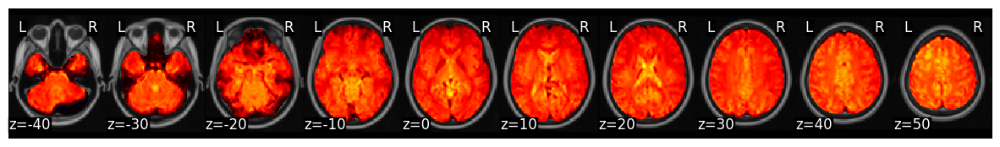

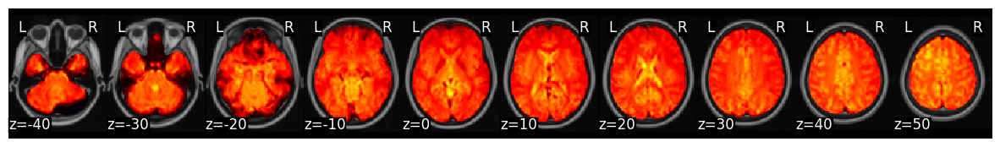

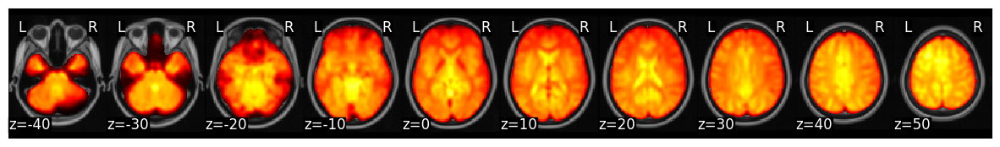

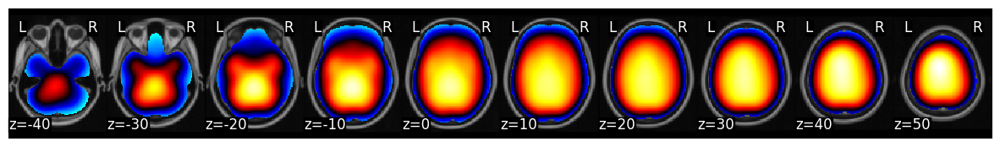

In [ ]:
### QUESTION ---- WHY fwhm = 6 througout the course? Is it emperical?

smot_2 = data.smooth(fwhm=2)
smot_6 = data.smooth(fwhm=6)
smot_10 = data.smooth(fwhm=30)

data.mean().plot()
smot_2.mean().plot()
smot_6.mean().plot()
smot_10.mean().plot()

# Group Analysis

How to infer data at the population level? Instead of the individual level.

## Hierarchical structure

- Each study can have multiple groups (condition or no condition, etc)
- Each group can have multiple subjects
- Each subject can have multiple runs
- Each run can have multiple trials
- Each trial has data for all voxels in the brain

## Modeling Mixed Effects

  - Variance within participant smallet than variance between participants
  - Combined data from all participants and treat them idenpendently - inflated view of group analysis
  - Mixed effect models -  data to be structured into groups and coefficients to vary by groups
  - “mixed” comes from the fact that these models are composed of both fixed and random effects
  - Fixed effect - systematic effect that applies to entire population
  - Random effects - randomness of each participant from the population

## Talk with Chat GPT about group level analysis

-- COMENT -- I FELL LIKE THE COURSE WAS NOT SO CLEAR ABOUT THIS PART

The pipeline:

  - For each subject - regress their GLM and obtain a metric from the time series - for example the result of a contrast applied to their individual level coeficients. For each subject, one coefficient can be obtained for each voxel

  - The result of this analysis is a Y - (subjects x voxel) matrix

  - Take a design matrix X with the regressors at the group level (1 for condition and 0 for no condition - 1 for intercept, etc)

  - The obtained coefficients will be of dimension (regressor x voxel). The coeficient $\beta_{i, j}$ is the effect of regressor $i$ on voxel $j$

  Transition from individual to group:

  If you use all regressors, for all subjects, you will end up with a (subjects x regressors x voxels) matrix. To go from this to a (subjects x voxels) matrix, you would generally either.

  Solutions:
  
  - Test each regressor independently, selecting the row of interest and stacking it across subjects to form a (subjects x voxels) matrix. For example, you can focus on the depression regressor and create a (subjects x voxels) matrix for that regressor alone.

  - Combine multiple regressors if you are interested in examining their joint effect across all subjects. This would involve selecting the relevant coefficients and using them in an overall model (e.g., testing the joint significance of all regressors across voxels).



## First Level - Single subject model

Diffently from the course. I indexed $β$ with i as it varies for each subject.

At first level, the model is defined as:

$$
  Y_i = X_i β_i + ϵ_i
$$

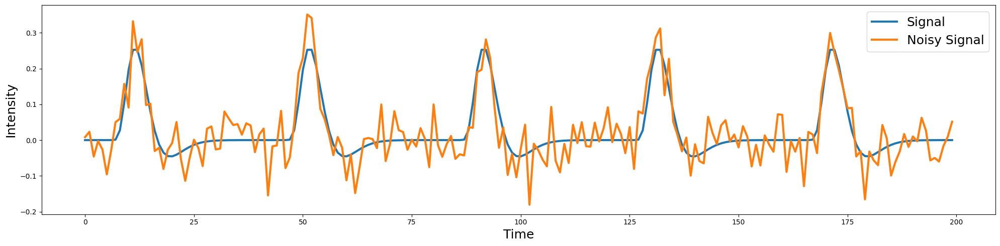

In [ ]:
# Simulation of voxel time-series

%matplotlib inline

import os
import glob
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from nltools.stats import regress, zscore
from nltools.data import Brain_Data, Design_Matrix
from nltools.stats import regress
from nltools.external import glover_hrf
from scipy.stats import ttest_1samp
import seaborn as sns

def plot_timeseries(data, linewidth=3, labels=None, axes=True):
    f,a = plt.subplots(figsize=(20,5))
    a.plot(data, linewidth=linewidth)
    a.set_ylabel('Intensity', fontsize=18)
    a.set_xlabel('Time', fontsize=18)
    plt.tight_layout()
    if labels is not None:
        plt.legend(labels, fontsize=18)
    if not axes:
        a.axes.get_xaxis().set_visible(False)
        a.axes.get_yaxis().set_visible(False)

def simulate_timeseries(n_tr=200, n_trial=5, amplitude=1, tr=1, sigma=0.05):
    y = np.zeros(n_tr)
    y[np.arange(20, n_tr, int(n_tr/n_trial))] = amplitude

    hrf = glover_hrf(tr, oversampling=1)
    y = np.convolve(y, hrf, mode='same')
    epsilon = sigma*np.random.randn(n_tr)
    y = y + epsilon
    return y

sim1 = simulate_timeseries(sigma=0)
sim2 = simulate_timeseries(sigma=0.05)
plot_timeseries(np.vstack([sim1,sim2]).T, labels=['Signal', 'Noisy Signal'])

Each time series is simulated as it was in previous classes a ts with a peak amplitude at discrete times. The peak amplitude is them convolved with the HRF to originate the observed signal.

## Second level

Combine each $\beta_i$ from each subject (either take a single regressor from each subject or combine them with a constrast) to form a output $\beta$. Using $\beta$, we can estimate the group level regressors $\beta_g$ in the following way:

$$
  β = X_g \beta_g + ŋ
$$

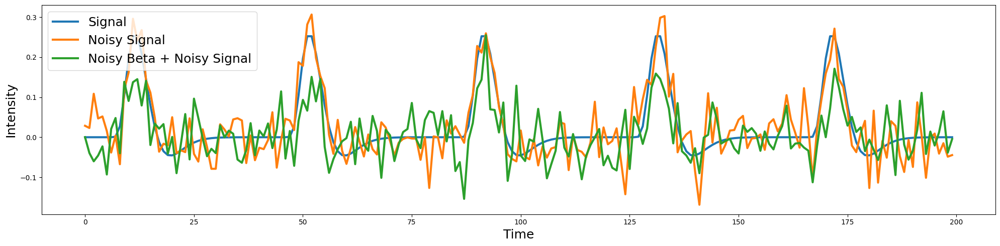

In [ ]:
# Adding noise to the beta-parameter

beta = np.abs(np.random.randn())*3
sim1 = simulate_timeseries(sigma=0)
sim2 = simulate_timeseries(sigma=0.05)
sim3 = simulate_timeseries(amplitude=beta, sigma=0.05)
plot_timeseries(np.vstack([sim1,sim2,sim3]).T, labels=['Signal', 'Noisy Signal', 'Noisy Beta + Noisy Signal'])

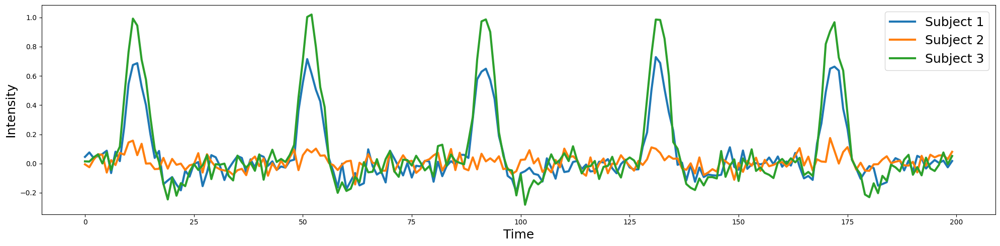

In [ ]:
# Three subject simulation

sim1 = simulate_timeseries(amplitude=np.abs(np.random.randn())*2, sigma=0.05)
sim2 = simulate_timeseries(amplitude=np.abs(np.random.randn())*2, sigma=0.05)
sim3 = simulate_timeseries(amplitude=np.abs(np.random.randn())*2, sigma=0.05)
plot_timeseries(np.vstack([sim1, sim2, sim3]).T, labels=['Subject 1', 'Subject 2', 'Subject 3'])

Beta is the amplitude of the signal before being convolved with the HRF here.

Text(0, 0.5, 'Estimated Beta')

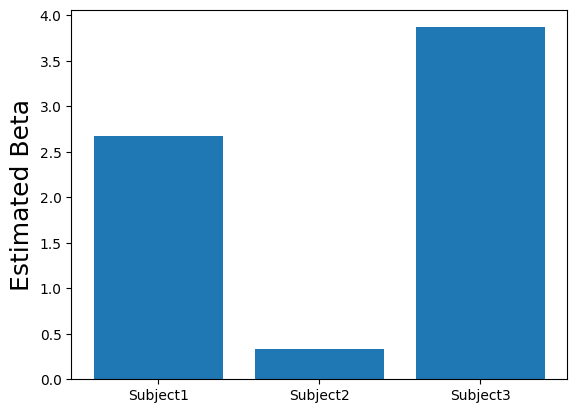

In [ ]:
# Recovering beta estimates from the 3 subjects

# Create a design matrix with an intercept and predicted response
task = simulate_timeseries(amplitude=1, sigma=0)
X = np.vstack([np.ones(len(task)), task]).T

# Loop over each of the simulated participants and estimate the amplitude of the response.
betas = []
for sub in [sim1, sim2, sim3]:
    beta,_,_,_,_,_ = regress(X, sub)
    # Two regressors - first is the intercept - second is amplitude
    betas.append(beta[1])

# Plot estimated amplitudes for each participant
plt.bar(['Subject1', 'Subject2', 'Subject3'], betas)
plt.ylabel('Estimated Beta', fontsize=18)

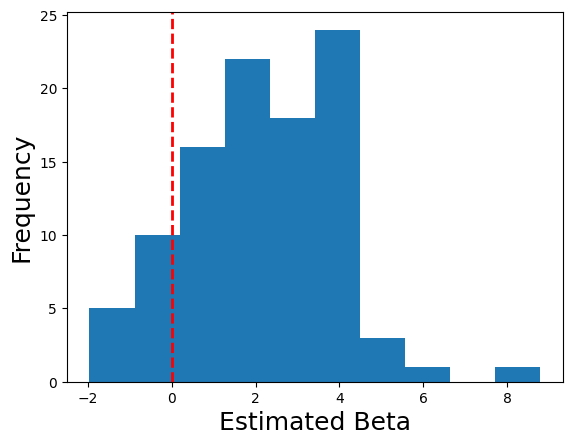

In [ ]:
# Multiple participants and beta distribution estimation

# Create a design matrix with an intercept and predicted response
task = simulate_timeseries(amplitude=1, sigma=0)
X = np.vstack([np.ones(len(task)), task]).T

# Loop over each of the simulated participants and estimate the amplitude of the response.
betas = []
for sub in range(100):
    sim = simulate_timeseries(amplitude=2+np.random.randn()*2, sigma=0.05)
    beta,_,_,_,_,_ = regress(X, sim)
    betas.append(beta[1])

# Plot distribution of estimated amplitudes for each participant
plt.hist(betas)
plt.ylabel('Frequency', fontsize=18)
plt.xlabel('Estimated Beta', fontsize=18)
plt.axvline(x=0, color='r', linestyle='dashed', linewidth=2)

In [ ]:
# t test

ttest_1samp(betas, 0)

TtestResult(statistic=12.060808092768072, pvalue=3.804170733518434e-21, df=99)

In [ ]:
# This was hard - I had to adapt the code for a local directory name as layoutimport os
from glob import glob
from tqdm import tqdm
import pandas as pd
import numpy as np
import nibabel as nib
from nltools.stats import zscore, regress, find_spikes
from nltools.data import Brain_Data, Design_Matrix
from bids import BIDSLayout, BIDSValidator
from nltools.file_reader import onsets_to_dm
from nltools.data import Brain_Data, Design_Matrix
from nilearn.plotting import view_img, glass_brain, plot_stat_map
import glob
# is taking too much time to load. Turns out you don't need it at all
# Just loop over the file names as below and it works!!!!
# For some reason, I was not able to write them separately
# It takes to much time to load the data - so it's hard to debug
# QUESTION ---- Could we go over this in detail??





# data_dir = '/content/drive/MyDrive/localizer/derivatives/fmriprep/'
# layout = BIDSLayout(data_dir, derivatives=True)
if True:
  pass
else:
  tr = 2.4
  fwhm = 6
  spike_cutoff = 3

  def load_bids_events(subject):
      '''Create a design_matrix instance from BIDS event file'''

      subject_file_name = f'/content/drive/MyDrive/localizer/derivatives/fmriprep/' + \
      f'sub-{subject}/func/sub-{subject}_task-localizer_space-MNI152NLin2009cAsym_desc-preproc_bold.nii.gz'
      subject_event_file = f'/content/drive/MyDrive/localizer/sub-{subject}/func/sub-{subject}_task-localizer_events.tsv'

      n_tr = nib.load(subject_file_name).shape[-1]

      onsets = pd.read_csv(subject_event_file, sep='\t')
      onsets.columns = ['Onset', 'Duration', 'Stim']
      return onsets_to_dm(onsets, sampling_freq=1/tr, run_length=n_tr)

  def make_motion_covariates(mc):
      z_mc = zscore(mc)
      all_mc = pd.concat([z_mc, z_mc**2, z_mc.diff(), z_mc.diff()**2], axis=1)
      all_mc.fillna(value=0, inplace=True)
      return Design_Matrix(all_mc, sampling_freq=1/tr)


  # Create output folder if it doesn't exist yet
  if not os.path.exists('/content/drive/MyDrive/localizer/derivatives/betas_fab'):
      os.mkdir('/content/drive/MyDrive/localizer/derivatives/betas_fab')

  subs_list = ['S01', 'S02', 'S03', 'S04', 'S05', 'S06', 'S07', 'S08']


  for sub in subs_list:

      subject_file_name = f'/content/drive/MyDrive/localizer/derivatives/fmriprep/' + \
      f'sub-{sub}/func/sub-{sub}_task-localizer_space-MNI152NLin2009cAsym_desc-preproc_bold.nii.gz'

      covaritates_file_name = f'/content/drive/MyDrive/localizer/derivatives/fmriprep' + \
      f'/sub-{sub}/func/sub-{sub}_task-localizer_desc-confounds_regressors.tsv'

      data = Brain_Data(subject_file_name)
      data = data.smooth(fwhm=fwhm)

      dm = load_bids_events(sub)
      covariates = pd.read_csv(covaritates_file_name, sep='\t')

      mc_cov = make_motion_covariates(covariates)

      mc_cov = make_motion_covariates(covariates[['trans_x','trans_y','trans_z','rot_x', 'rot_y', 'rot_z']])
      spikes = data.find_spikes(global_spike_cutoff=spike_cutoff, diff_spike_cutoff=spike_cutoff)
      dm_cov = dm.convolve().add_dct_basis(duration=128).add_poly(order=1, include_lower=True)
      dm_cov = dm_cov.append(mc_cov, axis=1).append(Design_Matrix(spikes.iloc[:, 1:], sampling_freq=1/tr), axis=1)
      data.X = dm_cov
      stats = data.regress()

      # Write out all betas
      stats['beta'].write(f'/content/drive/MyDrive/localizer/derivatives/betas_fab/{sub}_betas.nii.gz')

      for i, name in enumerate([x[:-3] for x in dm_cov.columns[:10]]):
          stats['beta'][i].write(f'../data/localizer/derivatives/betas/{sub}_beta_{name}.nii.gz')

In [ ]:
import glob

# Compare with Fatemeh results for some consistency
# It appears there is an inconsistenct
# There are some regressors missing from

data_dir_1 = '/content/drive/MyDrive/localizer/derivatives/betas_fab'
data_dir_2 = '/content/drive/MyDrive/localizer/derivatives/betas'


con1_file_list = glob.glob(os.path.join(data_dir_1, f'*.nii.gz'))
con1_file_list.sort()
con1_dat = Brain_Data(con1_file_list)
print(con1_dat)

con1_file_list = glob.glob(os.path.join(data_dir_2, f'*.nii.gz'))
con1_file_list.sort()
con1_dat = Brain_Data(con1_file_list)
print(con1_dat)



nltools.data.brain_data.Brain_Data(data=(339, 238955), Y=(0, 0), X=(0, 0), mask=MNI152_T1_2mm_brain_mask.nii.gz)
nltools.data.brain_data.Brain_Data(data=(419, 238955), Y=(0, 0), X=(0, 0), mask=MNI152_T1_2mm_brain_mask.nii.gz)


This t-test calculates the mean of observed betas and subtracts it with zero and divides by standard deviation over sqrt of n. It uses this value to compare with student's t-distribution and perform a t-test for the given p-value we see here. The p-value is way to low, so we can defenitly reject the null-hypothesis.

## Running a Group Analysis

## One Sample t-test

The other script performed the subject-level analysis for every single subject. Collecting all the betas and their distribution. We now continue with the group level analysis.

In [ ]:
# This code loads the betas in memory to perform the group level analysis
# QUESTION ----- How is it the same constructor? How does it diferentiate?

import glob

data_dir = '/content/drive/MyDrive/localizer/derivatives/betas'


con1_name = 'horizontal_checkerboard'
con1_file_list = glob.glob(os.path.join(data_dir, f'*_{con1_name}.nii.gz'))
con1_file_list.sort()
con1_dat = Brain_Data(con1_file_list)
print(con1_dat)

nltools.data.brain_data.Brain_Data(data=(8, 238955), Y=(0, 0), X=(0, 0), mask=MNI152_T1_2mm_brain_mask.nii.gz)


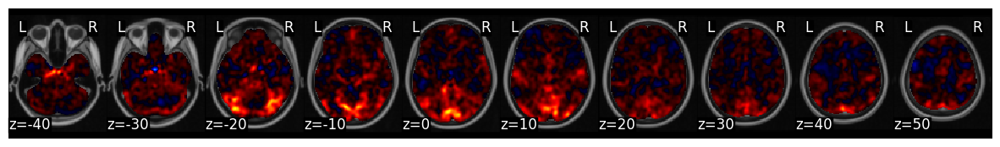

In [ ]:
# We can operate with the data - here we have the mean activation
# Beta for different areas

con1_dat.mean().plot()

In [ ]:
# Get t-test results

con1_stats = con1_dat.ttest()

print(con1_stats.keys())

con1_stats['t'].iplot()

dict_keys(['t', 'p'])


interactive(children=(FloatText(value=0.0, description='Threshold'), HTML(value='Image is 3D', description='Vo…

In [ ]:
# To perform a t-test we can isolate the regressors and operate with them
# Similarly as a contrast
# We can then perform a t-test on the result

data_dir = '/content/drive/MyDrive/localizer/derivatives/betas'


con2_name = 'vertical_checkerboard'
con2_file_list = glob.glob(os.path.join(data_dir, f'*_{con2_name}*nii.gz'))
con2_file_list.sort()
con2_dat = Brain_Data(con2_file_list)

con1_v_con2 = con1_dat-con2_dat

con1_v_con2.ttest()

con1_stats['t'].iplot()

interactive(children=(FloatText(value=0.0, description='Threshold'), HTML(value='Image is 3D', description='Vo…

## Group statistics using design matrices

-- QUESTION -- what are observations? beta's per "voxel"? (or region, or whole brain observation, etc)

In [ ]:
from IPython.display import Image, display

# Replace 'path/to/image.png' with the path to your image file
display(Image(filename='/content/drive/MyDrive/t-tests.png'))

### From beta to t-test

The standard error of a coefficient in a Generalized Linear Model (GLM) reflects the variability in the estimated coefficient due to sampling variability. It’s derived from the residual variance (how much the observed data differ from the model predictions) and the structure of the design matrix. Here’s the step-by-step process:

#### 1. Calculate the Residual Variance (also called Mean Squared Error)
   - First, fit the GLM to the data and get the predicted values for each observation.
   - Compute the residuals (the difference between each observed value and its predicted value by the model).
   - Calculate the residual sum of squares (RSS):

     $
     \text{RSS} = \sum_{i=1}^n (y_i - \hat{y}_i)^2
     $

   - Estimate the residual variance (Mean Squared Error, MSE) by dividing RSS by the degrees of freedom:

     $
     \sigma^2 = \frac{\text{RSS}}{n - p}
     $

     where $( n )$ is the number of observations, and $( p )$ is the number of parameters in the model (including the intercept).

#### 2. Obtain the Design Matrix \( X \)
   - The design matrix $( X )$ is a matrix where each row represents an observation and each column represents a predictor, including a column of ones if there’s an intercept.

#### 3. Calculate the Variance-Covariance Matrix of the Coefficients
   - The variance-covariance matrix of the estimated coefficients, $( \text{Var}(\hat{\beta}) )$, is given by:

     $
     \text{Var}(\hat{\beta}) = \sigma^2 (X^T X)^{-1}
     $

   - This matrix reflects the variability of each coefficient estimate and their covariances based on the model’s residual variance $( \sigma^2 )$ and the design matrix $( X )$.

#### 4. Extract the Standard Error of Each Coefficient
   - The diagonal elements of $( \text{Var}(\hat{\beta}) )$ give the variances of each estimated coefficient. Taking the square root of each diagonal element yields the standard error for each coefficient:

   $
     \text{SE}(\hat{\beta}_j) = \sqrt{[\text{Var}(\hat{\beta})]_{jj}}
  $

   where $( [\text{Var}(\hat{\beta})]_{jj} )$ is the $( j )$-th diagonal element corresponding to the variance of $( \hat{\beta}_j )$.

### Summary Example

If you had a model with three predictors (including an intercept) and computed the residual variance $( \sigma^2 )$, then:
1. You would construct $( X^T X )$.
2. Compute $( (X^T X)^{-1} )$.
3. Multiply $( \sigma^2 )$ by $( (X^T X)^{-1} )$ to get the variance-covariance matrix.
4. The square root of each diagonal element in this matrix would give the standard error for each respective coefficient.

In this way, the standard error reflects both the noise in the data and the design of the model.

For the $t$ statistic:

$
  t = \frac{\hat{\beta}_j}{\text{SE}(\hat{\beta}_j)}
$

If there is a contrast, compute the following:

The constrast applied to the parameters:
$
  \hat{c} = c^T β
$

The new variance given the contrast:
$
  Var(\hat{c}) = c^T \sigma^2 (X^T X)^{-1} c
$

The new standard error given the new variance
$
  SE(\hat{c}) = \sqrt{Var(\hat{c})}
$

## One-Sample t-test

One sample t-test can also be formulated as a regression, where the beta values for each subject in a voxel are predicted by a vector of ones. This intercept only model, computes the mean of Y. If the mean of (i.e., the intercept) is consistently shifted away from zero, then we can reject the null hypothesis that the mean of the betas is zero.

Y
[10.67305453  9.43959933 12.11738115 11.02222677  8.78627506  8.73606974
  7.68647702  9.83393958  9.1251757  11.89975529  8.78452422  9.91946165
 12.67213238 10.18623892 10.22879699  9.7414903  10.06295516 10.22416562
 10.57839517  9.69154093  2.9641578   5.28296372  3.16574192  4.74917804
  4.84273035  5.058956    2.97151973  3.90440883  6.90262122  6.69256529
  1.60355743  3.67109496  1.31620667  3.89728917  4.84174448  7.46320857
  1.96898884  4.85927959  9.03784317  6.09484057]

X
    Intercept
0         1.0
1         1.0
2         1.0
3         1.0
4         1.0
5         1.0
6         1.0
7         1.0
8         1.0
9         1.0
10        1.0
11        1.0
12        1.0
13        1.0
14        1.0
15        1.0
16        1.0
17        1.0
18        1.0
19        1.0
20        1.0
21        1.0
22        1.0
23        1.0
24        1.0
25        1.0
26        1.0
27        1.0
28        1.0
29        1.0
30        1.0
31        1.0
32        1.0
33        1.0
34        1.0
35 

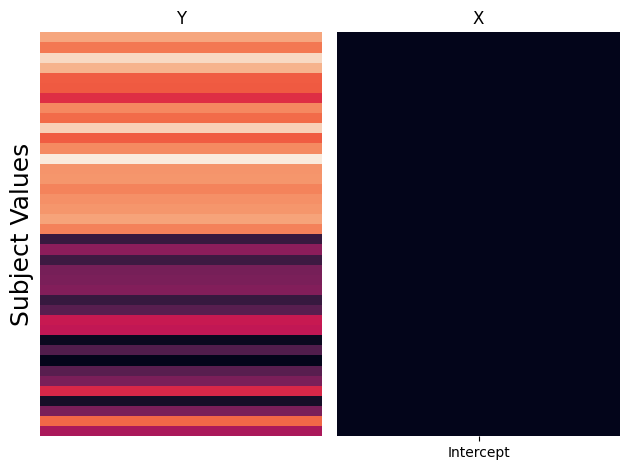

In [ ]:
# This code draws from normal distributions and tries to fit a parameter beta to them

def run_regression_simulation(x, y, paired=False):
    '''This Function runs a regression and outputs results'''
    # Estimate Regression
    if not paired:
        # Code had an error here - it was not compiling for some reason
        # Error - To many values to unpack

        # Regress performs the regression given x and y
        b, t, p, df, res, _ = regress(x, y)
        print(f"betas: {b}")
        if x.shape[1] > 1:
            print(f"beta1 + beta2: {b[0] + b[1]}")
            print(f"beta1 - beta2: {b[0] - b[1]}")
            print(f"mean(group1): {np.mean(group1)}")
            print(f"mean(group2): {np.mean(group2)}")
            print(f"mean(group1) - mean(group2): {np.mean(group1)-np.mean(group2)}")
        print(f"mean(y): {np.mean(y)}")
    else:
        beta, t, p, df, res, _ = regress(x, y)
        a = y[x.iloc[:,0]==1]
        b = y[x.iloc[:,0]==-1]
        out = []
        for sub in range(1, X.shape[1]):
            sub_dat = y[X.iloc[:, sub]==1]
            out.append(sub_dat-np.mean(sub_dat))
        avg_sub_mean_diff = np.mean([x[0] for x in out])
        print(f"betas: {b}")
        print(f"contrast beta: {beta[0]}")
        print(f"mean(subject betas): {np.mean(beta[1:])}")
        print(f"mean(y): {np.mean(y)}")
        print(f"mean(a): {a.mean()}")
        print(f"mean(b): {b.mean()}")
        print(f"mean(a-b): {np.mean(a - b)}")
        print(f"sum(a_i-mean(y_i))/n: {avg_sub_mean_diff}")

    # Create Plot
    f,a = plt.subplots(ncols=2, sharey=True)
    sns.heatmap(pd.DataFrame(y), ax=a[0], cbar=False, yticklabels=False, xticklabels=False)
    sns.heatmap(x, ax=a[1], cbar=False, yticklabels=False)
    a[0].set_ylabel('Subject Values', fontsize=18)
    a[0].set_title('Y')
    a[1].set_title('X')
    plt.tight_layout()

# Here we generate the random data
# y generates 40 random variables 20 with mean 10 and 20 with mean 5
group1_params = {'n':20, 'mean':10, 'sd':2}
group2_params = {'n':20, 'mean':5, 'sd':2}
group1 = group1_params['mean'] + np.random.randn(group1_params['n']) * group1_params['sd']
group2 = group2_params['mean'] + np.random.randn(group2_params['n']) * group2_params['sd']

y = np.hstack([group1, group2]).T
# x is a matrix of ones with the same size as y
x = pd.DataFrame({'Intercept':np.ones(len(y))})\

print('Y')
print(y)

print()
print('X')
print(x)

run_regression_simulation(x, y)

## Independent-Samples T-Test - Contrasts

Test Structure

$
\begin{pmatrix}
y_1 \\
y_2 \\
y_3 \\
y_4 \\
y_5 \\
y_6 \\
\end{pmatrix}
 =
\begin{pmatrix}
1 & 1 \\
1 & 1 \\
1 & 1 \\
1 & -1 \\
1 & -1 \\
1 & -1 \\
\end{pmatrix}
\cdot
\begin{pmatrix}
\beta_1 \\
\beta_2 \\
\end{pmatrix}
$

betas: [7.19338541 2.6726704 ]
beta1 + beta2: 9.866055808496418
beta1 - beta2: 4.52071501082075
mean(group1): 9.866055808496418
mean(group2): 4.52071501082075
mean(group1) - mean(group2): 5.345340797675668
mean(y): 7.193385409658584


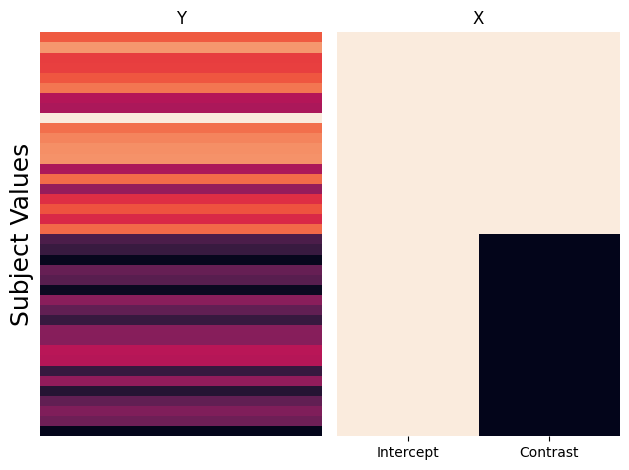

In [ ]:
# Code to test this previous test on our dummy time-series
# The results are way better

# Here B2 calculates the difference between

group1_params = {'n':20, 'mean':10, 'sd':2}
group2_params = {'n':20, 'mean':5, 'sd':2}
group1 = group1_params['mean'] + np.random.randn(group1_params['n']) * group1_params['sd']
group2 = group2_params['mean'] + np.random.randn(group2_params['n']) * group2_params['sd']

y = np.hstack([group1, group2])
x = pd.DataFrame({'Intercept':np.ones(len(y)), 'Contrast':np.hstack([np.ones(group1_params['n']), -1*np.ones(group2_params['n'])])})

run_regression_simulation(x, y)


### QUESTION - Why no intercept for baseline?

I understand it could be useless as if it's not there the resulting coeficients will take the baseline into themselves. However, does it make much of a difference testwise?

Test Structure

$
\begin{pmatrix}
y_1 \\
y_2 \\
y_3 \\
y_4 \\
y_5 \\
y_6 \\
\end{pmatrix}
 =
\begin{pmatrix}
1 & 1 & 0 \\
1 & 1 & 0 \\
1 & 1 & 0 \\
1 & 0 & 1 \\
1 & 0 & 1 \\
1 & 0 & 1 \\
\end{pmatrix}
\cdot
\begin{pmatrix}
\beta_0 \\
\beta_1 \\
\beta_2 \\
\end{pmatrix}
$

## Independent-Samples T-Test - Group Intercepts

Test structure

$
\begin{pmatrix}
y_1 \\
y_2 \\
y_3 \\
y_4 \\
y_5 \\
y_6 \\
\end{pmatrix}
 =
\begin{pmatrix}
 1 & 0 \\
 1 & 0 \\
 1 & 0 \\
 0 & 1 \\
 0 & 1 \\
 0 & 1 \\
\end{pmatrix}
\cdot
\begin{pmatrix}
\beta_1 \\
\beta_2 \\
\end{pmatrix}
$

   Group1  Group2
0     1.0     0.0
1     1.0     0.0
2     1.0     0.0
3     1.0     0.0
4     1.0     0.0
betas: [11.09791094  3.66519735]
beta1 + beta2: 14.763108294941283
beta1 - beta2: 7.4327135871313
mean(group1): 11.097910941036295
mean(group2): 3.665197353904992
mean(group1) - mean(group2): 7.432713587131303
mean(y): 7.381554147470642


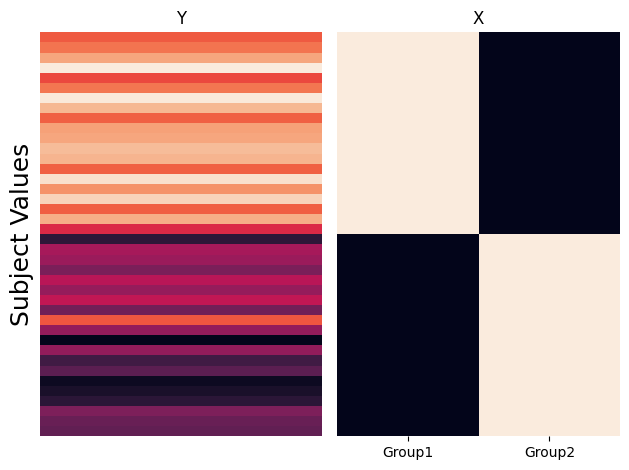

In [ ]:
# Test implementation

group1_params = {'n':20, 'mean':10, 'sd':2}
group2_params = {'n':20, 'mean':5, 'sd':2}
group1 = group1_params['mean'] + np.random.randn(group1_params['n']) * group1_params['sd']
group2 = group2_params['mean'] + np.random.randn(group2_params['n']) * group2_params['sd']

# Interesting x can be defined as a dataframe for group level analysis
y = np.hstack([group1, group2])
x = pd.DataFrame({'Group1':np.hstack([np.ones(len(group1)), np.zeros(len(group2))]), 'Group2':np.hstack([np.zeros(len(group1)), np.ones(len(group2))])})

print(x.head())
run_regression_simulation(x, y)

## Paired-Samples T-Test

One regressor will compute the contrast between condition
 and a condition b, and each subject has two measurements one with the condition and one withouth. Just like before, we need to account for the mean, but instead of computing a grand mean for all of the data, we will separately model the mean of each participant by adding more binary regressors where each subject is indicated in each regressor.

 Test structure:

 $
\begin{pmatrix}
s_{1, a} \\
s_{1, b} \\
s_{2, a} \\
s_{2, a} \\
s_{3, a} \\
s_{3, a}\\
\end{pmatrix}
 =
\begin{pmatrix}
1 & 1 & 0 & 0 \\
- 1 & 1 & 0 & 0\\
1 & 0 & 1 & 0 \\
- 1 & 0 & 1 & 0\\
1 & 0 & 0 & 1 \\
- 1 & 0 & 0 & 1 \\
\end{pmatrix}
\cdot
\begin{pmatrix}
\beta_0 \\
\beta_1 \\
\beta_2 \\
\end{pmatrix}
$

$ \beta_0 $ is the important parameter here. It is one that measures the difference between condition and no condition. The other parameters adjust for subject baseline.

<ipython-input-24-90b4992503a4>:18: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  sub_means = sub_means.replace({True:1,False:0})


betas: [22.15803317 64.92611769 36.00836629 34.75788635 43.73111933 43.23243616
 26.19471258 25.37491165 37.14842412 21.3358629  26.00744386 32.6705789
 29.04702514 52.22633283 33.95445222 15.94714858 50.40943817 31.08171818
 23.45386598 21.41945732]
contrast beta: 2.6218987365070276
mean(subject betas): 36.17616530872478
mean(y): 36.17616530872479
mean(a): 38.79806404523181
mean(b): 33.55426657221776
mean(a-b): 5.2437974730140535
sum(a_i-mean(y_i))/n: 2.6218987365070276


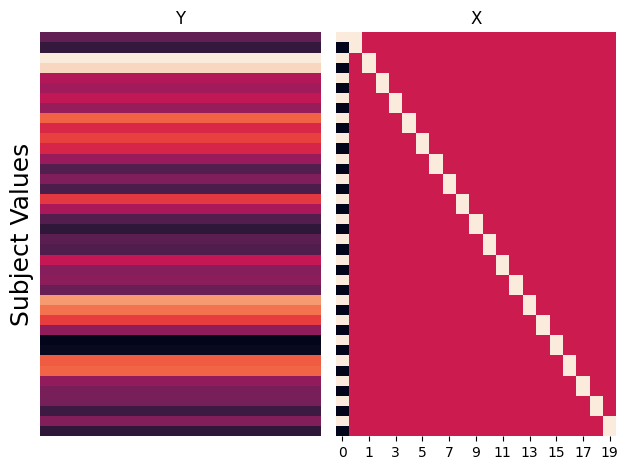

In [ ]:
# The code

a_params = {'mean':10, 'sd':2}
b_params = {'mean':5, 'sd':2}
sample_params = {'n':20, 'mean':30, 'sd':10}

y = []; x = []; sub_id = [];
for s in range(sample_params['n']):
    sub_mean = sample_params['mean'] + np.random.randn()*sample_params['sd']
    a = sub_mean + a_params['mean'] + np.random.randn() * a_params['sd']
    b = sub_mean + b_params['mean'] + np.random.randn() * b_params['sd']
    y.extend([a,b])
    x.extend([1, -1])
    sub_id.extend([s]*2)
y = np.array(y)

sub_means = pd.DataFrame([sub_id==x for x in np.unique(sub_id)]).T
sub_means = sub_means.replace({True:1,False:0})
X = pd.concat([pd.Series(x), sub_means], axis=1)

run_regression_simulation(X, y, paired=True)

## Exercises !

Nice finally got here.

## Exercise 1

In this text, the subjects were submited to several different taks all at the same time.

### Question - is this correct?

Maybe no significant result is obtained because of the low sample size

In [ ]:
from glob import glob
from tqdm import tqdm
import pandas as pd
import numpy as np
import nibabel as nib
from nltools.stats import zscore, regress, find_spikes
from nltools.data import Brain_Data, Design_Matrix
from bids import BIDSLayout, BIDSValidator
from nltools.file_reader import onsets_to_dm
from nltools.data import Brain_Data, Design_Matrix
from nilearn.plotting import view_img, glass_brain, plot_stat_map
import glob
import os

data_dir = '/content/drive/MyDrive/localizer/derivatives/betas'

video_conditions = ['video_right_hand', 'video_right_hand', 'video_sentence']

for i, vc in enumerate(video_conditions):
  con_name = vc
  con_file_list = glob.glob(os.path.join(data_dir, f'*_{vc}.nii.gz'))
  con_file_list.sort()
  con_data = Brain_Data(con_file_list)

  if i == 0:
    # This is just to check dimensions
    con_1_data = con_data
  else:
    base_con = base_con + con_data

audio_contions = ['audio_right_hand', 'audio_left_hand', 'audio_sentence']

for i, vc in enumerate(video_conditions):
  con_name = vc
  con_file_list = glob.glob(os.path.join(data_dir, f'*_{vc}.nii.gz'))
  con_file_list.sort()
  con_data = Brain_Data(con_file_list)

  base_con = base_con - con_data




#### QUESTIONS ----------
# Now the test statistic

t_test_res = base_con.ttest()

t_test_res['t'].iplot()



interactive(children=(FloatText(value=0.0, description='Threshold'), HTML(value='Image is 3D', description='Vo…

## Exercise 2

If the code from exercise 1 is correct, it's a mater of finding the tasks related to word processing instead of number processing and executing the same code with the same t-test.

## Exercise 3

### QUESTION - Fun fact Neurospin is literally two bus stops away from my Ph.D. lol - I am happy to see it's their dataset

In [ ]:
subject_info = pd.read_csv('/content/drive/MyDrive/localizer/participants.tsv', sep='\t')

#

subject_info.head()

,participant_id,age,sex,site,family,language
0,S01,24.0,M,SHFJ,F01,French
1,S02,20.0,M,SHFJ,F02,French
2,S03,22.0,F,SHFJ,F03,French
3,S04,20.0,M,Neurospin,F04,French
4,S05,23.0,F,Neurospin,F05,French


In [ ]:
# Build the desing matrix

subject_m = subject_info.head(8).loc[subject_info.head(8)['sex'] == 'M']
subject_f = subject_info.head(8).loc[subject_info.head(8)['sex'] == 'F']

subject_m_index = subject_m.index.tolist()
subject_f_index = subject_f.index.tolist()

design_matrix = np.zeros((2, 8))

# Two-samples
design_matrix[0 , subject_m_index] = 1
design_matrix[1, subject_f_index] = 1

design_matrix = design_matrix.T
print(design_matrix)


[[1. 0.]
 [1. 0.]
 [0. 1.]
 [1. 0.]
 [0. 1.]
 [1. 0.]
 [0. 1.]
 [1. 0.]]


In [ ]:
X = design_matrix
Y = np.array(base_con.data)


In [ ]:
## Now we regress to find beta, which should yield the difference.

beta_diff = regress(X, Y)[0]

print(beta_diff.shape)

(2, 238955)


- Individual level -

  ( ts x voxel ) = (ts x regressor) x ( regressors x voxel )


- Group level -

  (subjects x voxel) = (subjects x regressors) x (regressors x voxel)

### Question - Ask steph about 1 sample to two sample difference. Testing the difference of the average or the average of the diferences

## Exercise 1 - Corrected

In [ ]:
from glob import glob
from tqdm import tqdm
import pandas as pd
import numpy as np
import nibabel as nib
from nltools.stats import zscore, regress, find_spikes
from nltools.data import Brain_Data, Design_Matrix
from bids import BIDSLayout, BIDSValidator
from nltools.file_reader import onsets_to_dm
from nltools.data import Brain_Data, Design_Matrix
from nilearn.plotting import view_img, glass_brain, plot_stat_map
import glob
import os

data_dir = '/content/drive/MyDrive/localizer/derivatives/betas'

video_conditions = ['video_right_hand', 'video_right_hand', 'video_sentence']

for i, vc in enumerate(video_conditions):
  con_name = vc
  con_file_list = glob.glob(os.path.join(data_dir, f'*_{vc}.nii.gz'))
  con_file_list.sort()
  con_data = Brain_Data(con_file_list)

  if i == 0:
    # This is just to check dimensions
    con_1_data = con_data
  else:
    con_1_data = con_1_data + con_data

audio_contions = ['audio_right_hand', 'audio_left_hand', 'audio_sentence']

for i, vc in enumerate(video_conditions):
  con_name = vc
  con_file_list = glob.glob(os.path.join(data_dir, f'*_{vc}.nii.gz'))
  con_file_list.sort()
  con_data = Brain_Data(con_file_list)

  if i == 0:
    # This is just to check dimensions
    con_2_data = con_data
  else:
    con_2_data = con_2_data + con_data

print(con_1_data.shape)
print(con_2_data.shape)


<bound method Brain_Data.shape of nltools.data.brain_data.Brain_Data(data=(8, 238955), Y=(0, 0), X=(0, 0), mask=MNI152_T1_2mm_brain_mask.nii.gz)>
<bound method Brain_Data.shape of nltools.data.brain_data.Brain_Data(data=(8, 238955), Y=(0, 0), X=(0, 0), mask=MNI152_T1_2mm_brain_mask.nii.gz)>


In [ ]:
# Design matrix construction

n_subs = 8

X = np.zeros((2*n_subs, n_subs + 1))

for i in range(n_subs):
  X[i, 0] = 1
  X[i, i + 1] = 1

for i in range(n_subs):
  j = n_subs + i
  X[j, 0] = -1
  X[j, i + 1] = -1

print(X)

[[ 1.  1.  0.  0.  0.  0.  0.  0.  0.]
 [ 1.  0.  1.  0.  0.  0.  0.  0.  0.]
 [ 1.  0.  0.  1.  0.  0.  0.  0.  0.]
 [ 1.  0.  0.  0.  1.  0.  0.  0.  0.]
 [ 1.  0.  0.  0.  0.  1.  0.  0.  0.]
 [ 1.  0.  0.  0.  0.  0.  1.  0.  0.]
 [ 1.  0.  0.  0.  0.  0.  0.  1.  0.]
 [ 1.  0.  0.  0.  0.  0.  0.  0.  1.]
 [-1. -1.  0.  0.  0.  0.  0.  0.  0.]
 [-1.  0. -1.  0.  0.  0.  0.  0.  0.]
 [-1.  0.  0. -1.  0.  0.  0.  0.  0.]
 [-1.  0.  0.  0. -1.  0.  0.  0.  0.]
 [-1.  0.  0.  0.  0. -1.  0.  0.  0.]
 [-1.  0.  0.  0.  0.  0. -1.  0.  0.]
 [-1.  0.  0.  0.  0.  0.  0. -1.  0.]
 [-1.  0.  0.  0.  0.  0.  0.  0. -1.]]


In [ ]:
Y = np.vstack((con_1_data.data, con_2_data.data))

print(Y.shape)

(16, 238955)


In [ ]:
## Now we regress to find beta, which should yield the difference.
beta_diff = regress(X, Y)[0]

print(beta_diff.shape)

beta_data = Brain_Data(beta_diff)

beta_data = beta_data.ttest(threshold_dict={'fdr':.05})
beta_data['thr_t'].plot()


(9, 238955)


TypeError: data must be a single or list of: Brain_Data, filepath, or nib.Nifti1Image

# Thresholding Group Analyses

Correct for multiple comparisons
- Issues with correcting for multiple comparisons

- Family Wise Error Rate

- Bonferroni Correction

- False Discovery Rate


The metrics:

Familywise Error Rate (FWER) attempts to control the probability of finding any false positives. Mathematically, FWER can be defined as the probability of observing any false positive.

\begin{equation}
  FWER = P(FalsePositives > 1)
\end{equation}

While, False Discovery Rate (FDR) attempts to control the proportion of false positives among rejected tests. Formally, this is the expected proportion of false positive to the observed number of significant tests

\begin{equation}
  FDR = E(\frac{FalsePositives}{SignificantTests})
\end{equation}


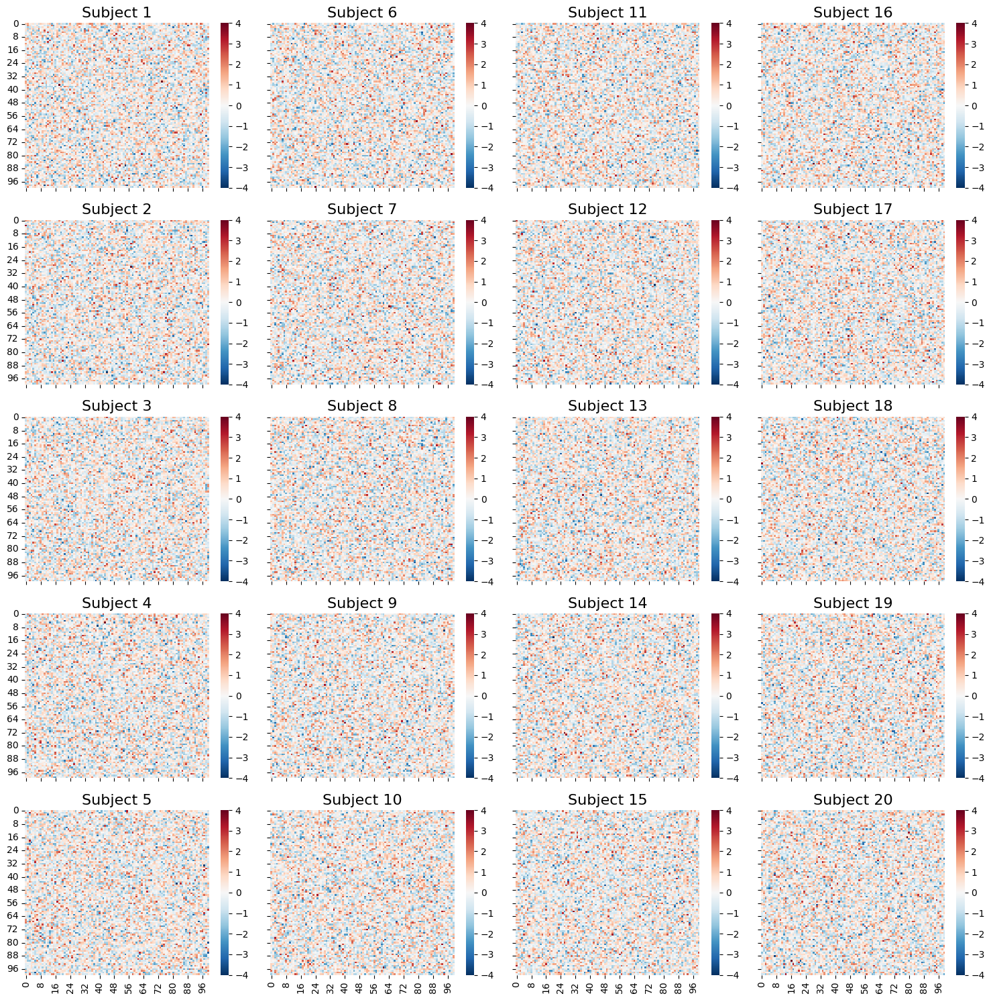

In [ ]:
# This code generates synthetic voxel data from a Normal (0, 1) for 20 participants


%matplotlib inline

import os
import glob
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from nltools.data import Brain_Data
from nltools.simulator import SimulateGrid

simulation = SimulateGrid(grid_width=100, n_subjects=20)

f,a = plt.subplots(nrows=5, ncols=4, figsize=(15,15), sharex=True, sharey=True)
counter = 0
for col in range(4):
    for row in range(5):
        sns.heatmap(simulation.data[:, :, counter], ax=a[row, col], cmap='RdBu_r', vmin=-4, vmax=4)
        a[row,col].set_title(f'Subject {counter+1}', fontsize=16)
        counter += 1
plt.tight_layout()

We know perform a t-test in all the random values from the subjects

Text(0.5, 1.0, 'T Values')

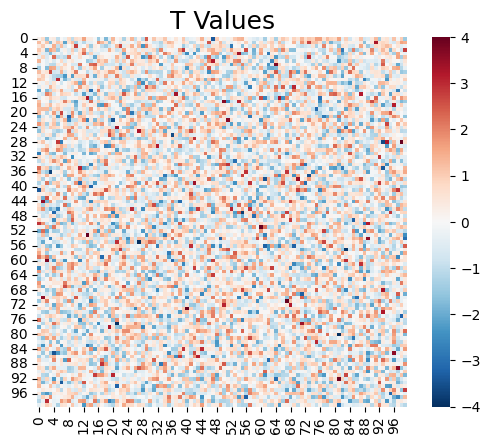

In [ ]:
simulation.fit()

sns.heatmap(simulation.t_values, square=True, cmap='RdBu_r', vmin=-4, vmax=4)
plt.title("T Values", fontsize=18)

Even though there is no signal, we can see that there are several points above 2 and -2. Those points would pass a t-test with significance p=0.05.

Now let’s apply a threshold. We can specify thresholds at a specific t-value using the threshold_type='t'. Alternatively, we can specify a specific p-value using the threshold_type='p'. To calculate the number of false positives, we can simply count the number of tests that exceed this threshold.

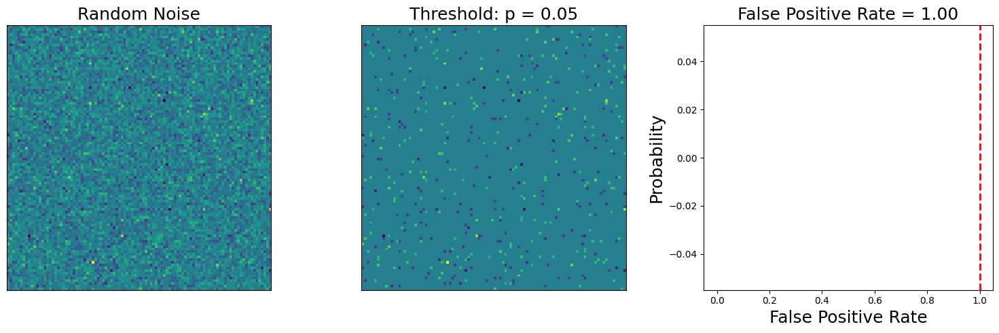

In [ ]:
threshold = .05
simulation = SimulateGrid(grid_width=100, n_subjects=20)
simulation.plot_grid_simulation(threshold=threshold, threshold_type='p', n_simulations=1)


The left panel is the average over all of the participants. The middle panel show voxels that exceed the statistical threshold. The right panel is the overall false-positive rate across the 100 simulations.

In this simulation, a threshold of p < 0.05 results in observing at least one voxels that is a false positive across every one of our 100 simulations.


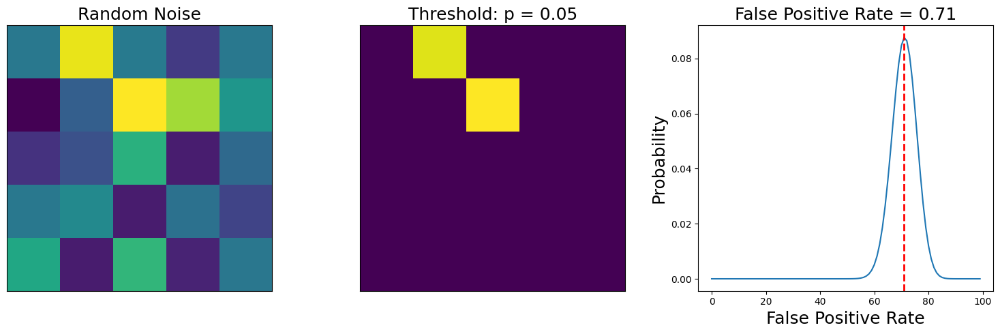

In [ ]:
threshold = .05
simulation = SimulateGrid(grid_width=5, n_subjects=20)
simulation.plot_grid_simulation(threshold=threshold, threshold_type='p', n_simulations=100)

This simulation shows that examining fewer numbers of voxels will yield considerably less false positives.

What about if we increase the threshold on our original 100 x 100 grid?

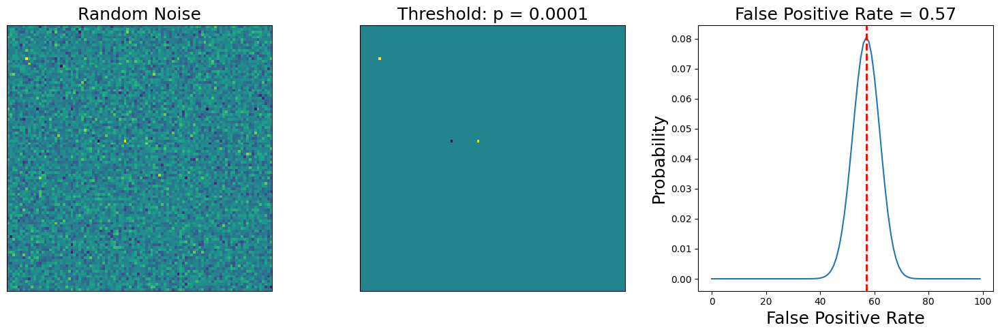

In [ ]:
threshold = .0001
simulation = SimulateGrid(grid_width=100, n_subjects=20)
simulation.plot_grid_simulation(threshold=threshold, threshold_type='p', n_simulations=100)

What individual threashold gives us a 0.05 probability of having only one false positive overall? The code bellow tests how different thresholds inpact the false positive rate

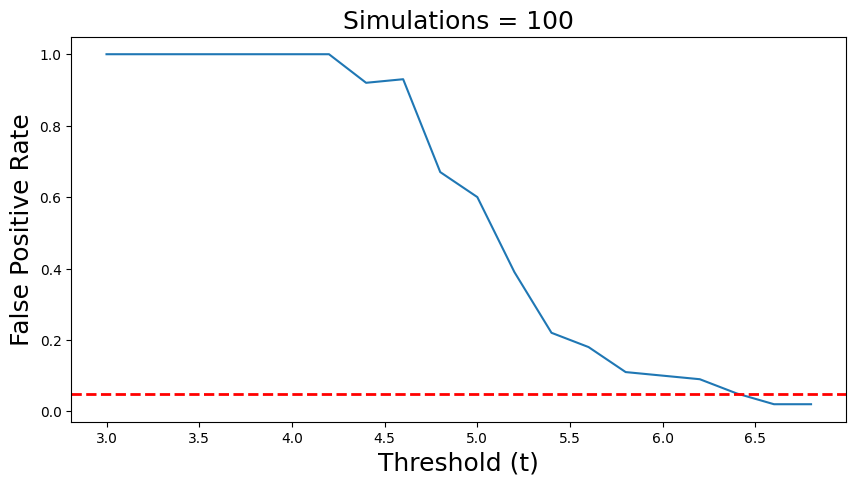

In [ ]:
alpha = 0.05
n_simulations = 100
x = np.arange(3, 7, .2)

sim_all = []
for p in x:
    sim = SimulateGrid(grid_width=100, n_subjects=20)
    sim.run_multiple_simulations(threshold=p, threshold_type='t', n_simulations=n_simulations)
    sim_all.append(sim.fpr)

f,a = plt.subplots(ncols=1, figsize=(10, 5))
a.plot(x, np.array(sim_all))
a.set_ylabel('False Positive Rate', fontsize=18)
a.set_xlabel('Threshold (t)', fontsize=18)
a.set_title(f'Simulations = {n_simulations}', fontsize=18)
a.axhline(y=alpha, color='r', linestyle='dashed', linewidth=2)

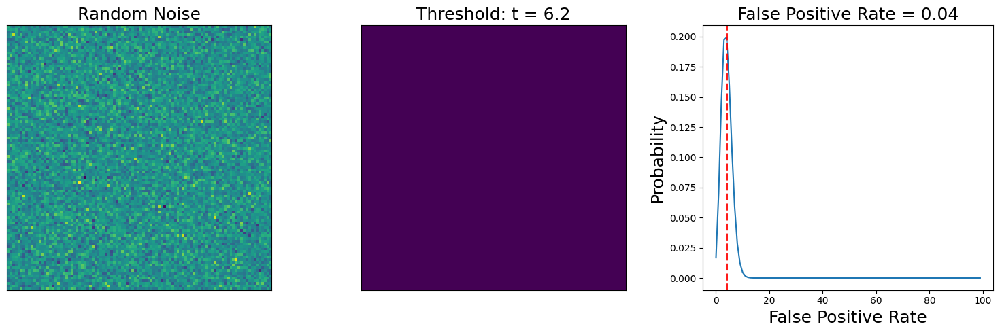

In [ ]:
# We know apply the threshold to the noise simulation again

simulation = SimulateGrid(grid_width=100, n_subjects=20)
simulation.plot_grid_simulation(threshold=6.2, threshold_type='t', n_simulations=100)

Another way to find the threshold that controls FWER is to divide the alpha by the number of independent tests across voxels. This is called the bonferroni correction.

$$
 Bonferroni = \frac{α}{M}
$$

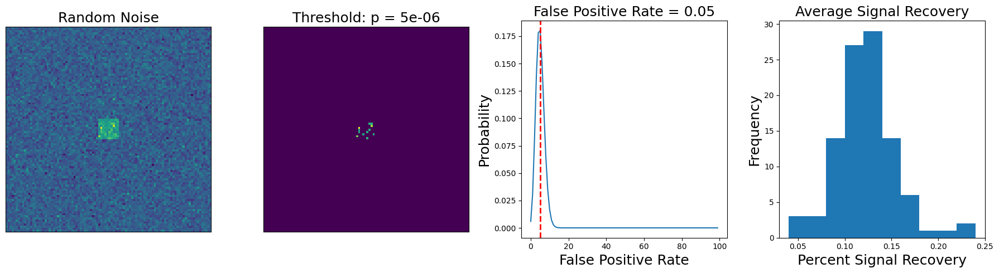

In [ ]:
# The signal is now a square in the middle of the simulation
# signal_width represents a square in the middle of the simulation
# The amplitude of the signal is controled by singal amplitude
# Now we have true positives and signal recovery

grid_width = 100
threshold = .05/(grid_width**2)
signal_width = 10
signal_amplitude = 1

simulation = SimulateGrid(signal_amplitude=signal_amplitude, signal_width=10, grid_width=grid_width, n_subjects=20)
simulation.plot_grid_simulation(threshold=threshold, threshold_type='p', n_simulations=100)

 Bonferroni increases too much the threashold. To the point that recovering the signal becomes too hard. We can barely detect any true signal with this amplitude

 Recovering around 12% of the voxels with a signal

 This simulation highlights the main issue with using bonferroni correction in practice. The threshold is so conservative that the magnitude of an effect needs to be unreasonably large to survive correction over hundreds of thousands of voxels.

## Family Wise Error Rate

You accept some errors to increase the probability of finding effects. By adjusting the expected probability of false positives, you increase the number of false positives but you also have a lower threashold which allows a better signal recovery

## Cluster Extent

Controlling the FWER is called cluster correction, or cluster extent. In this approach, the goal is to identify a threshold such that the maximum statistic exceeds it at a specified alpha.
The distribution of the maximum statistic can be approximated using Gaussian Random Field Theory (RFT), which attempts to account for the spatial dependence of the data.


Euler Characteristic or the number of blobs minus the number of holes in the thresholded image. The number of voxels in the blob and the overall smoothness can be used to calculate something called resels or resolution elements and can be effectively thought of as the spatial units that need to be controlled for using FWER

Cluster extent thresholding has recently become somewhat controversial due to several high profile papers that have found that it appears to lead to an inflated false positive rate in practice

This approach can work well with some amounts of smoothing results that have a particular spatial extent, but not equally well for all types of signals.
Problem - to assume that spatial smoothness is constant over the brain and also that it is adequately represented using a Gaussian distribution.


 It is important to note that this approach only allows us to make inferences for the entire cluster. We can say that there is some voxel in the cluster that is significant, but we can’t really pinpoint which voxels within the cluster may be driving the effect.

## Threshold Free Cluster Extent

One interesting solution to the issue of finding an initial threshold seems to be addressed by the threshold free cluster enhancement method

The authors propose a way to combine cluster extent and voxel height into a single metric that does not require specifying a specific initial threshold

Ok - really want to read the TFCE paper - so here it goes

### Threshold Free Cluster Extent Paper Summary

I feel like I need to learn this paper better - so I read a little and asked ChatGPT. Here are some interesting insights:

Expression:

$$
\text{TFCE}(v) = \int_{h} \left( h^H \cdot e(h)^E \right) dλ_h
$$


For each node:
TFCE procedure, it is an intregral over the possible threashold values.
For each h in the integral, on effect size maps, only include the nodes that are bellow that value and evaluate the size of the cluster. Sum over all possible h's to get the integral value

Procedure -
TFCE is Applied to the Entire Statistic Image:

- You provide the entire statistic map (t - scores)
- TFCE assigns a score to every voxel based on the strength and extent of local support at all thresholds
- This avoids predefining clusters or selecting arbitrary thresholds for cluster formation.
Result: Voxel-Wise TFCE Map:

- After applying TFCE, you obtain a new statistic map where each voxel's value reflects the amount of "cluster-like" signal it contributes to.

The significance is then obtained through permutation testing on the voxel level

Limitations - The parameters H and E can feel a little random as they are empirical and their interpretation is not entirely fixed




## Parametric simulations

One approach to estimating the inherent smoothness in the data, or it’s spatial autocorrelation, is using parametric simulations

## Nonparametric approaches

As an alternative to RFT, nonparametric methods use the data themselves to find the appropriate distribution. These methods can provide substantial improvements in power and validity, particularly with small sample sizes, so we recommend these in general over cluster extent. These tests can verify the validity of the less computationally expensive parametric approaches.

## False Discovery Rate (FDR)

FDR - proportion of false positives among all tests

The FDR is fairly straightforward to calculate.

We select a desired limit $q$ on FDR, which is the proportion of false positives we are okay with observing (e.g., 5/100 tests or 0.05).

We rank all of the p-values over all the voxels from the smallest to largest.

We find the threshold such that $p \leq \frac{i}{m} \cdot q$

We reject the null hypothesis of all tests whose p-value is below the threashold.

FDR q < 0.05 corresponds to p-value of 0.0002775045339318825


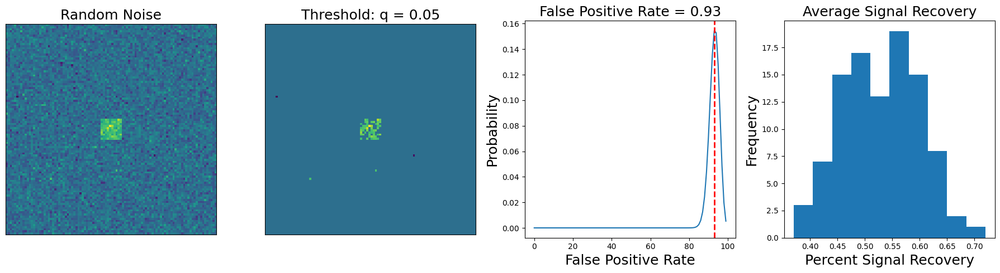

In [ ]:
# This code applies the FDR to the signal simulation

grid_width = 100
threshold = .05
signal_amplitude = 1
simulation = SimulateGrid(signal_amplitude=signal_amplitude, signal_width=10, grid_width=grid_width, n_subjects=20)
simulation.plot_grid_simulation(threshold=threshold, threshold_type='q', n_simulations=100, correction='fdr')
print(f'FDR q < 0.05 corresponds to p-value of {simulation.corrected_threshold}')

Text(0.5, 0, 'False Discovery Rate of Simulations')

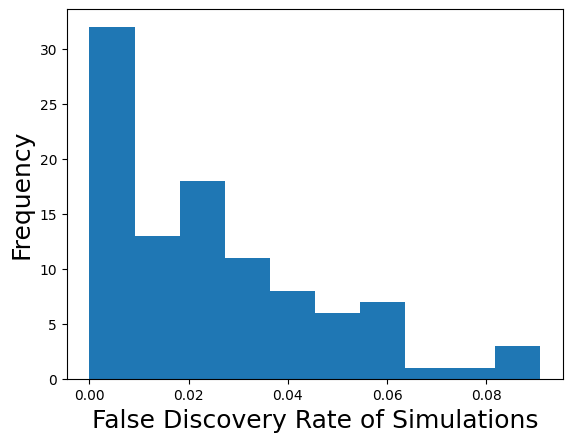

In [ ]:
# This codes calculates the actual FDR given a simulation

plt.hist(simulation.multiple_fdr)
plt.ylabel('Frequency', fontsize=18)
plt.xlabel('False Discovery Rate', fontsize=18)
plt.xlabel('False Discovery Rate of Simulations', fontsize=18)

## Thresholding Brain Maps

Applying threasholds for actual brain data

 - First, we will simply threshold based on selecting an arbitrary statistical threshold. The values are completely arbitrary, but it is common to start with something like p < .001. We call this uncorrected because this is simply the threshold for any voxel as we are not controlling for multiple tests.

In [ ]:
# appling theashold to brain data

# Ok this is really frustrating but for some f-ing reasong beyond me the drive CANNOT find the path
# This is absurd but whatever - FRUSTATING AS HELL
# I am just going to continue to the exercises and whatever

sub_l = ['S01', 'S02', 'S03', 'S04', 'S05', 'S06', 'S07']

con1_file_list = [f'/content/drive/MyDrive/localizer/sub-{sub}/func/sub-{sub}_task-localizer_bold.nii.gz' for sub in sub_l]

for f in con1_file_list:
    print(f"Checking path: {repr(f)}")
    if os.path.exists(f):
        print("File exists!")
    else:
        print("File not found.")

#con1_dat = Brain_Data(con1_file_list)
#con1_stats = con1_dat.ttest(threshold_dict={'unc':.001})

#con1_stats['thr_t'].plot()

Checking path: '/content/drive/MyDrive/localizer/sub-S01/func/sub-S01_task-localizer_bold.nii.gz'
File not found.
Checking path: '/content/drive/MyDrive/localizer/sub-S02/func/sub-S02_task-localizer_bold.nii.gz'
File not found.
Checking path: '/content/drive/MyDrive/localizer/sub-S03/func/sub-S03_task-localizer_bold.nii.gz'
File not found.
Checking path: '/content/drive/MyDrive/localizer/sub-S04/func/sub-S04_task-localizer_bold.nii.gz'
File not found.
Checking path: '/content/drive/MyDrive/localizer/sub-S05/func/sub-S05_task-localizer_bold.nii.gz'
File not found.
Checking path: '/content/drive/MyDrive/localizer/sub-S06/func/sub-S06_task-localizer_bold.nii.gz'
File not found.
Checking path: '/content/drive/MyDrive/localizer/sub-S07/func/sub-S07_task-localizer_bold.nii.gz'
File not found.


## Exercises

### Exercise 1

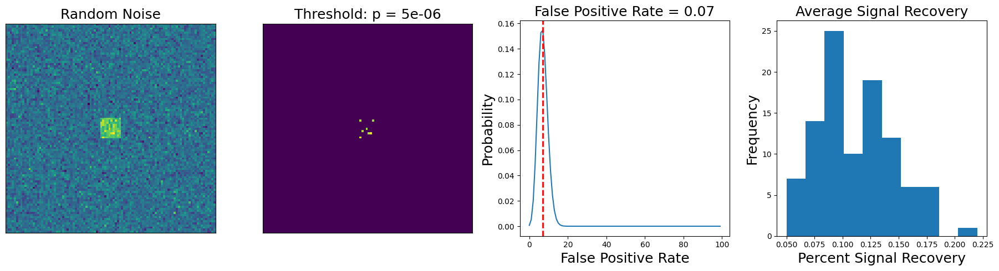

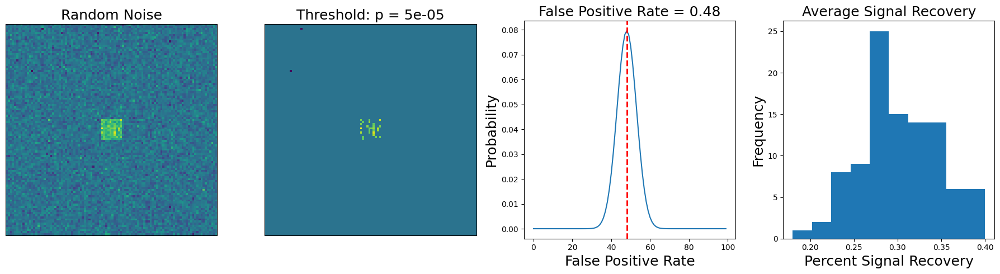

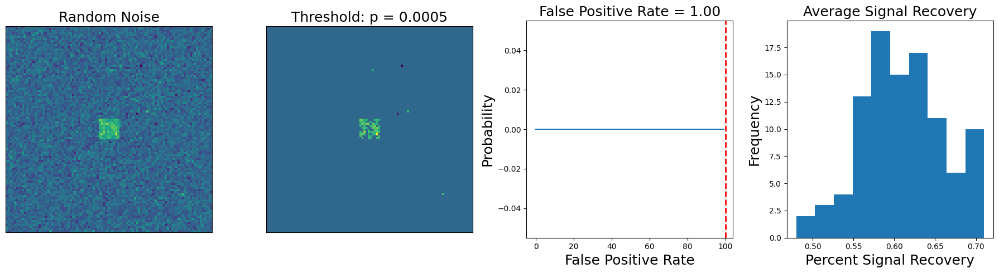

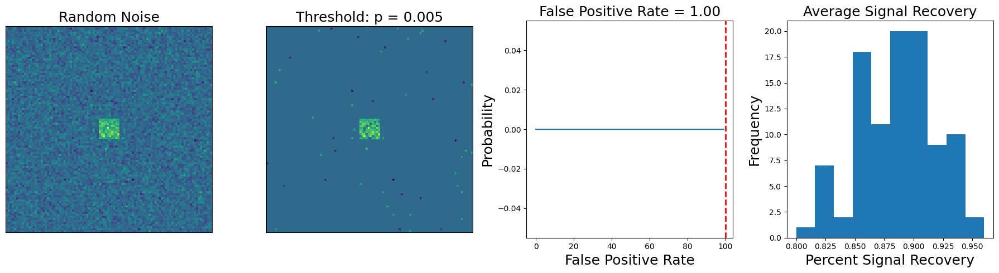

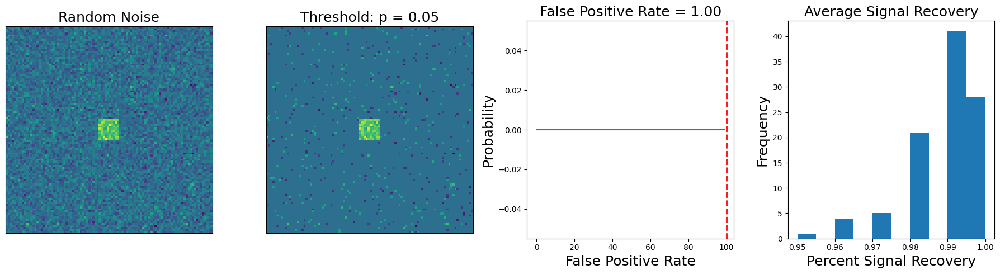

In [ ]:
## First pasting the bonferroni part
## I will just test several threasholds in a loop to see if I can recover the signal

# t_l = [.05, 0.10, 0.20, 0.30, 0.40, 0.50, 0.90]
t_l = [.05, 0.5, 5, 50, 500]


for t in t_l:
  grid_width = 100
  threshold = t/(grid_width**2)
  signal_width = 10
  signal_amplitude = 1

  simulation = SimulateGrid(signal_amplitude=signal_amplitude, signal_width=10, grid_width=grid_width, n_subjects=20)
  simulation.plot_grid_simulation(threshold=threshold, threshold_type='p', n_simulations=100)

## Exercise 2

In [ ]:
## I cannot load the data anymore - no idea why

# I need to ask Steph about this one

# To solve this problem, we would just run the code from the previous exercise Chapter
# but add the following line to the ttest part

# It is a one sided t-test and we are only interested in the positive parts

# Same thing for exercise 3 - just a repetition, but we change the subtractions
if false
  con1_stats = con1_dat.ttest(threshold_dict={'fdr':.05})
  con1_stats['thr_t'].plot()

# Connectivity

There is structural connectivity - how the brain is connected - obtained by tracking neurons. Not studied here

Also, functional connectivity - how different areas are connected in the execution of a task


## Seed Voxel Correlations

Simply the temporal correlation between the time-series of voxels.

In [ ]:
# Load code

%matplotlib inline

import os
import glob
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from nltools.data import Brain_Data, Design_Matrix, Adjacency
from nltools.mask import expand_mask, roi_to_brain
from nltools.stats import zscore, fdr, one_sample_permutation
from nltools.file_reader import onsets_to_dm
from nltools.plotting import component_viewer
from scipy.stats import binom, ttest_1samp
from sklearn.metrics import pairwise_distances
from copy import deepcopy
import networkx as nx
from nilearn.plotting import plot_stat_map, view_img_on_surf
from bids import BIDSLayout, BIDSValidator
import nibabel as nib

data_dir = '/content/drive/MyDrive/Localizer1'
layout = BIDSLayout(data_dir, derivatives=True)

/usr/local/lib/python3.10/dist-packages/bids/layout/layout.py:516: UserWarning: Derivative indexing was requested, but no valid datasets were found in the specified locations ([PosixUPath('/content/drive/MyDrive/Localizer1/derivatives')]). Note that all BIDS-Derivatives datasets must meet all the requirements for BIDS-Raw datasets (a common problem is to fail to include a 'dataset_description.json' file in derivatives datasets).
Example contents of 'dataset_description.json':
{"Name": "Example dataset", "BIDSVersion": "1.0.2", "GeneratedBy": [{"Name": "Example pipeline"}]}
  warnings.warn("Derivative indexing was requested, but no valid "


In [ ]:
# Load subject data and

sub = 'S01'
fwhm=6

data = Brain_Data('/content/drive/MyDrive/Localizer1/derivatives/fmriprep/sub-S01/anat/sub-S01_T1w.nii')
smoothed = data.smooth(fwhm=fwhm)

/usr/local/lib/python3.10/dist-packages/nilearn/maskers/nifti_masker.py:114: UserWarning: imgs are being resampled to the mask_img resolution. This process is memory intensive. You might want to provide a target_affine that is equal to the affine of the imgs or resample the mask beforehand to save memory and computation time.
  warnings.warn(


[NiftiMasker.wrapped] Resampling images

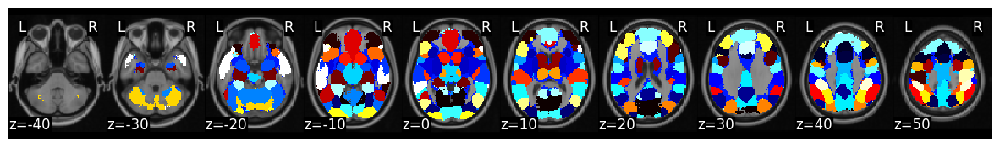

In [ ]:
# Load mask

mask = Brain_Data('/content/drive/MyDrive/localizer/mask/whole_brain_cluster_labels_PCA=100_k=50.nii')

mask.plot()


/usr/local/lib/python3.10/dist-packages/nilearn/masking.py:981: UserWarning: Data array used to create a new image contains 64-bit ints. This is likely due to creating the array with numpy and passing `int` as the `dtype`. Many tools such as FSL and SPM cannot deal with int64 in Nifti images, so for compatibility the data has been converted to int32.
  return new_img_like(mask_img, unmasked, affine)


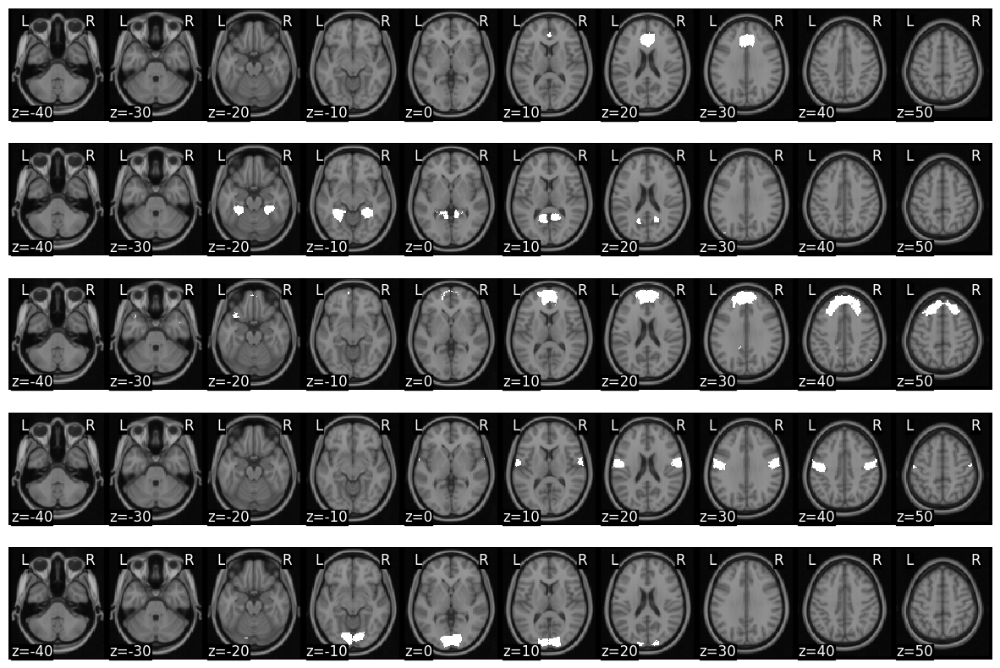

In [ ]:
# Expand mask

mask_x = expand_mask(mask)

f = mask_x[0:5].plot()

/usr/local/lib/python3.10/dist-packages/nilearn/masking.py:981: UserWarning: Data array used to create a new image contains 64-bit ints. This is likely due to creating the array with numpy and passing `int` as the `dtype`. Many tools such as FSL and SPM cannot deal with int64 in Nifti images, so for compatibility the data has been converted to int32.
  return new_img_like(mask_img, unmasked, affine)


8876.236


Text(0.5, 0, 'Time (TRs)')

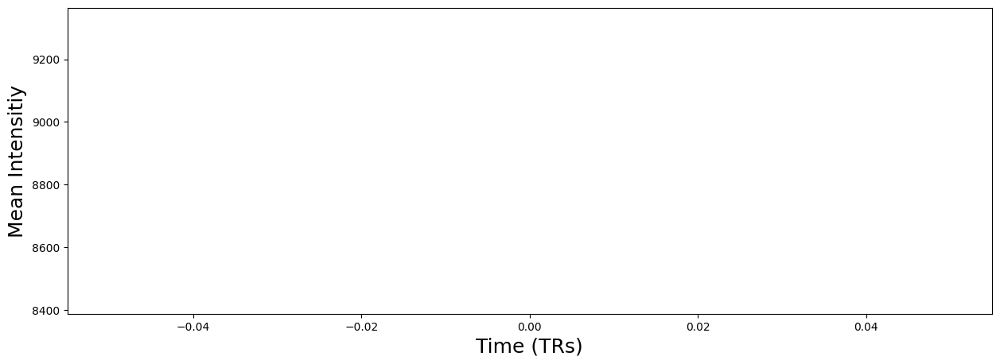

In [ ]:
#  Mean Intensity

vmpfc = smoothed.extract_roi(mask=mask_x[32])

plt.figure(figsize=(15,5))
plt.plot(vmpfc, linewidth=3)
plt.ylabel('Mean Intensitiy', fontsize=18)
plt.xlabel('Time (TRs)', fontsize=18)

So there is an issues with the mask. It is supposed to give the mean intensity over a region. We can then use this mean intensity to compute the functional connectivity between two Regions of Interest (ROI).

In [ ]:
# Test functional connectivity calculation

tr = 2.5
fwhm = 6
n_tr = len(data)

def make_motion_covariates(mc, tr):
    z_mc = zscore(mc)
    all_mc = pd.concat([z_mc, z_mc**2, z_mc.diff(), z_mc.diff()**2], axis=1)
    all_mc.fillna(value=0, inplace=True)
    return Design_Matrix(all_mc, sampling_freq=1/tr)


vmpfc = zscore(pd.DataFrame(vmpfc, columns=['vmpfc']))

csf_mask = Brain_Data(os.path.join(base_dir, 'masks', 'csf.nii.gz'))
csf_mask = csf_mask.threshold(upper=0.7, binarize=True)
csf = zscore(pd.DataFrame(smoothed.extract_roi(mask=csf_mask).T, columns=['csf']))

spikes = smoothed.find_spikes(global_spike_cutoff=3, diff_spike_cutoff=3)
covariates = pd.read_csv(layout.get(subject=sub, scope='derivatives', extension='.tsv')[0].path, sep='\t')
mc = covariates[['trans_x','trans_y','trans_z','rot_x', 'rot_y', 'rot_z']]
mc_cov = make_motion_covariates(mc, tr)
dm = Design_Matrix(pd.concat([vmpfc, csf, mc_cov, spikes.drop(labels='TR', axis=1)], axis=1), sampling_freq=1/tr)
dm = dm.add_poly(order=2, include_lower=True)

smoothed.X = dm
stats = smoothed.regress()

vmpfc_conn = stats['beta'][0]

ValueError: DataFrame constructor not properly called!

## Signal to Noise Ratio

How good is this metric?

- Signal to noise ratio in terms of variance and inter task variance.

Variance between conditions:
$$
\frac{n_t n_r}{n_t + n_r} \cdot (\bar{X}_t - \bar{X}_r)^2
$$

Variance within conditions:
$$
\frac{(n_r - 1)s_r^2 + (n_t - 1)s_t^2}{(n_r + n_t) - 2}
$$

The SRN is them the ratio between the variance between condtions and and variance within conditions.



## PCA

PCA in terms of eigenvectors and eigenvalues:

- Start with a data matrix $X$ size $m \cdot n$ with $m$ observations and $n$ variables
- Compute the Covariance Matrix;
$$
  C = \frac{1}{m - 1} X^T X
$$
- Find eigenvectors of covariance matrix $\lambda_i$
- Each eigenvector points to a direction that maximizes variance
- The variance explained by each component:
$$
  \frac{λ_i}{\sum_{i} λ_i}
$$
- To project the data and reduce dimensions just do
$$
  Z = X V_k
$$
where $V_k$ are the k highest eigenvalue respective eigenvectors

PCA in terms of SVD:

$$
X = USV^T
$$
where $V$ corresponds to the eigenimages or spatial components and $U$
corresponds to the transformation matrix to convert the eigenimages into a timecourse. $S$ reflects the amount of scaling for each component.

## ICA

Blindly separate source signal into spatially independent components - assumes that the data consists of p spatially independent components which are linerly mixed and spatially fixed - PCA assumes orthonormality constraint while ICA assumes independence

$$
  X = AS
$$
where A is a mixing matrix (mixing of the independent signals to result in X) and S is the source matrix.

To find S - we need to find an unmixing matrix -

Assumptions:
  - Linearly mixed
  - Components are statistically independent
  - Components are non-Gaussian
  


## Graph Theory

Graph thoery in a setence:
Set of nodes + set of vertices that express connections between the nodes

Centrality:
- Different metrics that evaluate how important a node is to a network

In this section, starts by calculating the functional connectivity graph between all diferent nodes.

Uses an arbitrary threshold for measuring centrality

Calculates degree centrality between different nodes

# Introduction to Independent Components Analysis (ICA)

ICA - identifying brainsignals by unmixing. This section is about ICA in more detail

In [ ]:
# Import necessary modules

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from nltools import Brain_Data, Design_Matrix
from nltools.mask import create_sphere
from nltools.utils import get_anatomical
from scipy.stats import pearsonr

n_tr = 200
n_trial = 5
tr = 2
sigma = 0.75
signal_intensity = 5

/usr/local/lib/python3.10/dist-packages/nilearn/maskers/nifti_masker.py:114: UserWarning: imgs are being resampled to the mask_img resolution. This process is memory intensive. You might want to provide a target_affine that is equal to the affine of the imgs or resample the mask beforehand to save memory and computation time.
  warnings.warn(


[NiftiMasker.wrapped] Resampling images

/usr/local/lib/python3.10/dist-packages/nilearn/image/resampling.py:297: UserWarning: Resampling binary images with continuous or linear interpolation. This might lead to unexpected results. You might consider using nearest interpolation instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/nilearn/maskers/nifti_masker.py:114: UserWarning: imgs are being resampled to the mask_img resolution. This process is memory intensive. You might want to provide a target_affine that is equal to the affine of the imgs or resample the mask beforehand to save memory and computation time.
  warnings.warn(


[NiftiMasker.wrapped] Resampling images

/usr/local/lib/python3.10/dist-packages/nilearn/image/resampling.py:297: UserWarning: Resampling binary images with continuous or linear interpolation. This might lead to unexpected results. You might consider using nearest interpolation instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/nilearn/maskers/nifti_masker.py:114: UserWarning: imgs are being resampled to the mask_img resolution. This process is memory intensive. You might want to provide a target_affine that is equal to the affine of the imgs or resample the mask beforehand to save memory and computation time.
  warnings.warn(


[NiftiMasker.wrapped] Resampling images

/usr/local/lib/python3.10/dist-packages/nilearn/image/resampling.py:297: UserWarning: Resampling binary images with continuous or linear interpolation. This might lead to unexpected results. You might consider using nearest interpolation instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/nilearn/maskers/nifti_masker.py:114: UserWarning: imgs are being resampled to the mask_img resolution. This process is memory intensive. You might want to provide a target_affine that is equal to the affine of the imgs or resample the mask beforehand to save memory and computation time.
  warnings.warn(


[NiftiMasker.wrapped] Resampling images

/usr/local/lib/python3.10/dist-packages/nilearn/image/resampling.py:297: UserWarning: Resampling binary images with continuous or linear interpolation. This might lead to unexpected results. You might consider using nearest interpolation instead.
  warnings.warn(


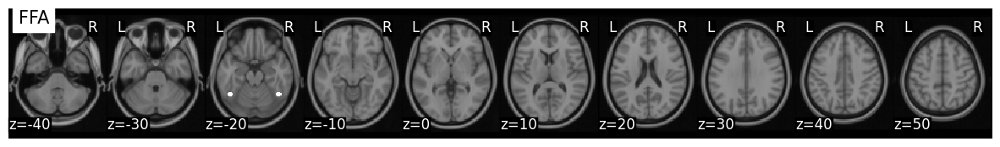

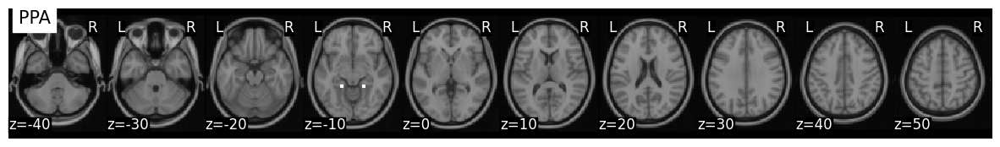

In [ ]:
# Create bilateral masks - spheres with a radius of 5 voxels centered on each region of interest (ROI)

ffa = Brain_Data(create_sphere([44, -55, -22])) + Brain_Data(create_sphere([-44, -55, -22]))
ffa.plot(title='FFA')

ppa = Brain_Data(create_sphere([-20, -40, -6])) + Brain_Data(create_sphere([20, -40, -6]))
ppa.plot(title='PPA')

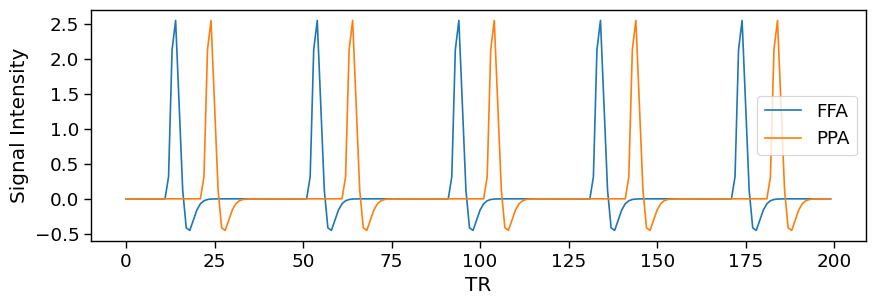

In [ ]:
# Generate synthetic brain signal data

ffa_signal = Design_Matrix(np.zeros(n_tr), sampling_freq=1/tr)
ffa_signal.iloc[np.arange(10, n_tr, int(n_tr/n_trial))] = signal_intensity
ffa_signal = ffa_signal.convolve()

ppa_signal = Design_Matrix(np.zeros(n_tr), sampling_freq=1/tr)
ppa_signal.iloc[np.arange(20, n_tr, int(n_tr/n_trial))] = signal_intensity
ppa_signal = ppa_signal.convolve()

with sns.plotting_context(context='paper', font_scale=1.5):
    f,a = plt.subplots(figsize=(10,3))
    ffa_signal.plot(ax=a)
    ppa_signal.plot(ax=a)
    a.legend(['FFA', 'PPA'])
    a.set_xlabel('TR')
    a.set_ylabel('Signal Intensity')

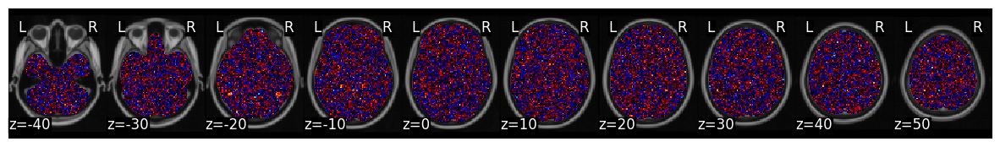

In [ ]:
# Initialize an empty brain for 200 TRs
simulated_data = Brain_Data(get_anatomical())
simulated_data.data = np.zeros([n_tr, simulated_data.shape()[0]])

# Add brain signal to each ROI
simulated_data.data[:, ffa.data==1] = pd.concat([ffa_signal.T]*ffa.data.sum().astype(int)).T
simulated_data.data[:, ppa.data==1] = pd.concat([ppa_signal.T]*ppa.data.sum().astype(int)).T

# Add Noise to each voxel and TR
simulated_data.data += np.random.randn(simulated_data.data.shape[0], simulated_data.data.shape[1]) * sigma

# Plot average voxel activity over time
simulated_data.mean().plot()

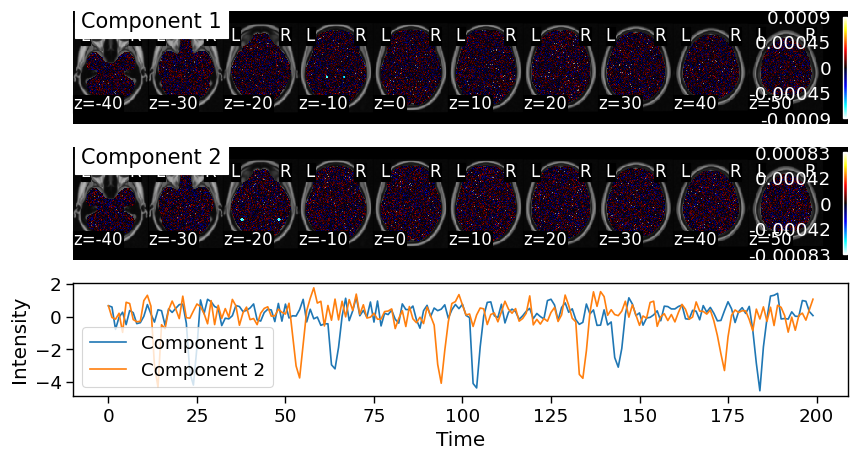

In [ ]:
# Using ICA to get both components

decomposed_voxels = simulated_data.decompose(algorithm='ica', axis='voxels', n_components=2)

with sns.plotting_context(context='paper', font_scale=1.5):

  f,a = plt.subplots(nrows=3, figsize=(10,5))
  decomposed_voxels['components'][0].plot(colorbar = True, title='Component 1', axes=a[0])
  decomposed_voxels['components'][1].plot(colorbar = True, title='Component 2', axes=a[1])

  a[2].plot(decomposed_voxels['weights'])
  a[2].set_ylabel('Intensity')
  a[2].set_xlabel('Time')
  a[2].legend(['Component 1', 'Component 2'])

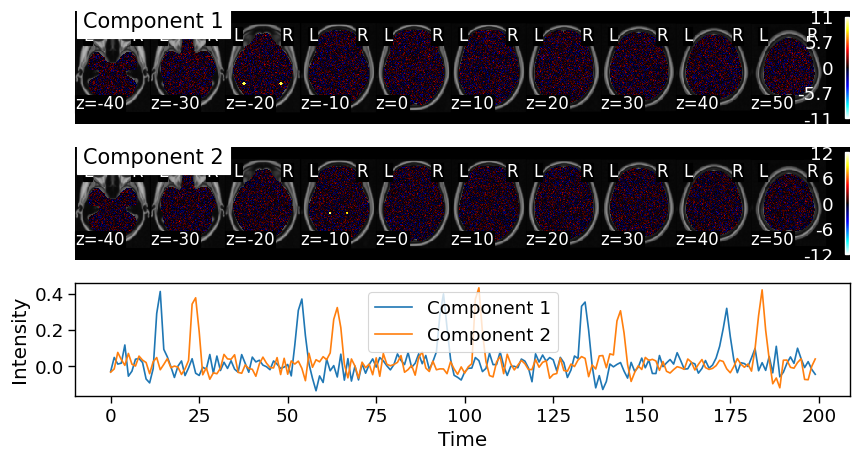

In [ ]:
# Temporal ICA now instead of spatial ICA

decomposed_voxels = simulated_data.decompose(algorithm='ica', axis='images', n_components=2)

with sns.plotting_context(context='paper', font_scale=1.5):
  f,a = plt.subplots(nrows=3, figsize=(10,5))
  decomposed_voxels['components'][0].plot(colorbar = True, title='Component 1', axes=a[0])
  decomposed_voxels['components'][1].plot(colorbar = True, title='Component 2', axes=a[1])

  a[2].plot(decomposed_voxels['weights'])
  a[2].set_ylabel('Intensity')
  a[2].set_xlabel('Time')
  a[2].legend(['Component 1', 'Component 2'])

I dont understand what is meant by spatial ICA vs temporal ICA - what are the signals being extracted in each case? What is the diference between the two?

## Overlapping temporal signals simulation

Let’s simulate a slightly different scenario to explore this more. Here we will now give different signal intensities to the face and house signals. Let’s also assume that there might be a weaker response in the PPA when viewing faces, but this signal might be slightly delayed by one TR as perceiving a house could be slower than perceiving a face.


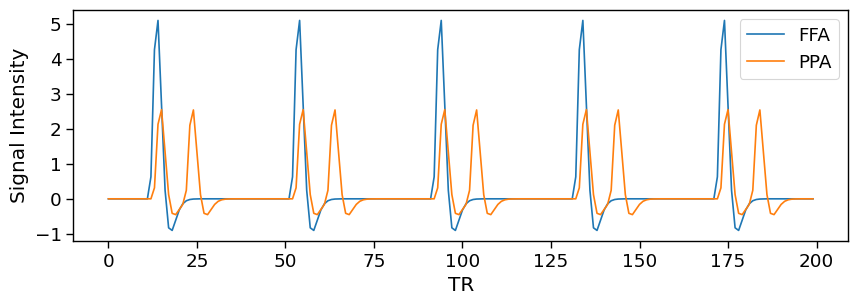

In [ ]:
n_tr = 200
n_trial = 5
tr = 2
sigma = 0.75
signal_intensity_1 = 10
signal_intensity_2 = 5

simulated_data = Brain_Data(get_anatomical())
simulated_data.data = np.zeros([n_tr, simulated_data.shape()[0]])

ffa_signal = Design_Matrix(np.zeros(n_tr), sampling_freq=1/tr)
ffa_signal.iloc[np.arange(10, n_tr, int(n_tr/n_trial))] = signal_intensity_1
ffa_signal = ffa_signal.convolve()

ppa_signal = Design_Matrix(np.zeros(n_tr), sampling_freq=1/tr)
ppa_signal.iloc[np.arange(11, n_tr, int(n_tr/n_trial))] = signal_intensity_2
ppa_signal.iloc[np.arange(20, n_tr, int(n_tr/n_trial))] = signal_intensity_2
ppa_signal = ppa_signal.convolve()

simulated_data.data[:, ffa.data==1] = pd.concat([ffa_signal.T]*ffa.data.sum().astype(int)).T
simulated_data.data[:, ppa.data==1] = pd.concat([ppa_signal.T]*ppa.data.sum().astype(int)).T

# Add Noise
simulated_data.data += np.random.randn(simulated_data.data.shape[0],simulated_data.data.shape[1]) * sigma


with sns.plotting_context(context='paper', font_scale=1.5):
    f,a = plt.subplots(figsize=(10,3))
    ffa_signal.plot(ax=a)
    ppa_signal.plot(ax=a)
    a.legend(['FFA', 'PPA'])
    a.set_xlabel('TR')
    a.set_ylabel('Signal Intensity')


Text(2, 0, 'r = 0.49')

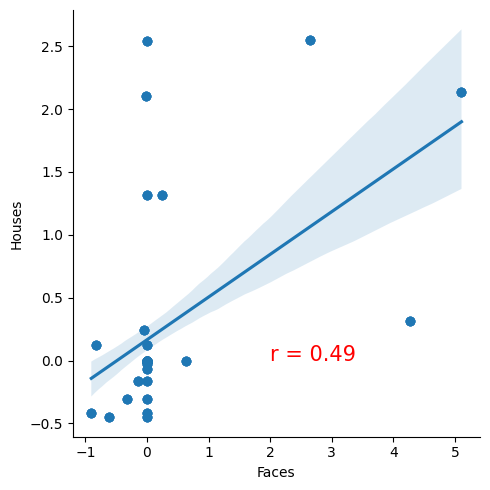

In [ ]:
## The signals are no longer independent and have a correlation

# The signal bellow shows this

combined = pd.concat([ffa_signal, ppa_signal], axis=1)
combined.columns = ['Faces', 'Houses']
sns.lmplot(data=combined, x='Faces', y='Houses')
plt.text(2,0, f'r = {pearsonr(ffa_signal.iloc[:,0], ppa_signal.iloc[:,0])[0]:.02}', {'fontsize':15, 'color':'red'})

Can ICA recover this signals?

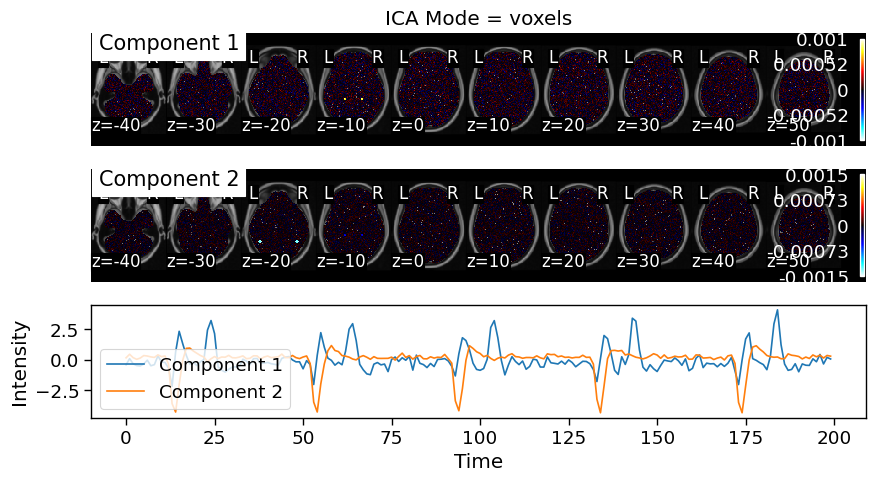

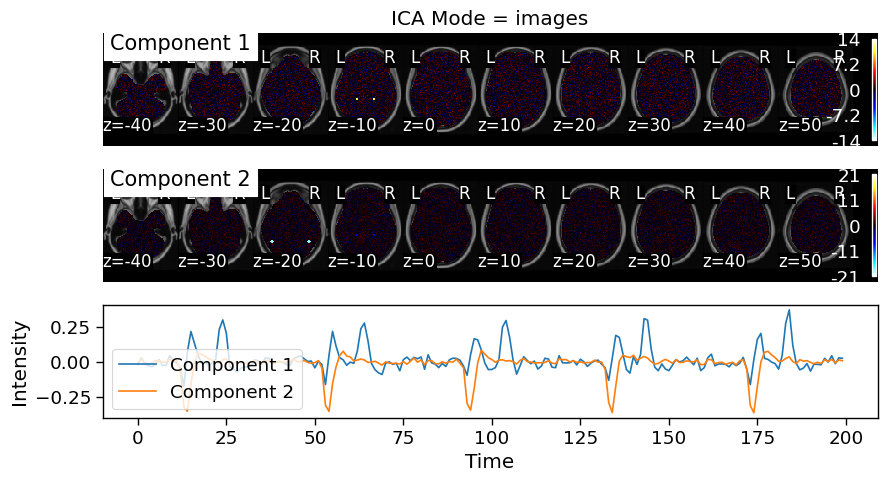

In [ ]:
for ica_mode in ['voxels', 'images']:

  decomposed_voxels = simulated_data.decompose(algorithm='ica', axis=ica_mode, n_components=2)

  with sns.plotting_context(context='paper', font_scale=1.5):

    f,a = plt.subplots(nrows=3, figsize=(10,5))
    decomposed_voxels['components'][0].plot(colorbar = True, title='Component 1', axes=a[0])
    decomposed_voxels['components'][1].plot(colorbar = True, title='Component 2', axes=a[1])

    a[2].plot(decomposed_voxels['weights'])
    a[2].set_ylabel('Intensity')
    a[2].set_xlabel('Time')
    a[2].legend(['Component 1', 'Component 2'])
    a[0].set_title(f'ICA Mode = {ica_mode}')

Both spatial and temporal ICA are able to successfully recover the signals. However, there are some slight nuances to how well they perform in this specific simulation. Notice how the spatial ICA is able to successfully identify the different spatial signals and the corresponding signals. Temporal ICA does not work quite as well in this example. Component 1 includes activity in both the FFA and PPA regions. Component 2 only has weights in the FFA, but goes up in the Face condition and down in the House condition.

Well the temporal ICA assumes temporal independence t

# Multivariate Prediction

Here instead of finding which regressors are more relevant in explain the task variance, we use the regressors to predict the outcome.

Before - is there voxel - activation with a certain task?
After - is there outcome with voxel activation? Can we predict the magnitude of the outcome?

## Data Extraction

Just like the previous statistical inference step, here we also predict the betas from several regressors. The betas will be used as input data for the prediction model.



In [ ]:
# Load data

import os
import glob
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from nltools.data import Brain_Data
from nltools.mask import expand_mask
from bids import BIDSLayout, BIDSValidator
from nilearn.plotting import view_img_on_surf

data_dir = '/content/drive/MyDrive/localizer'

layout = BIDSLayout(data_dir, derivatives=True)

/usr/local/lib/python3.10/dist-packages/bids/layout/validation.py:123: UserWarning: The PipelineDescription field was superseded by GeneratedBy in BIDS 1.4.0. You can use ``pybids upgrade`` to update your derivative dataset.
  warnings.warn("The PipelineDescription field was superseded "


In [ ]:
left_file_list = glob.glob(os.path.join(data_dir, 'derivatives', 'betas', '*video_left_hand.nii.gz'))
left_file_list.sort()
left = Brain_Data(left_file_list)

right_file_list = glob.glob(os.path.join(data_dir, 'derivatives', 'betas', '*video_right_hand.nii.gz'))
right_file_list.sort()
right = Brain_Data(right_file_list)

data = left.append(right)

In [ ]:
# The next step is to assign the data labels - we assign the label for right or left to the data Y variable
# Labels: 1 for left video and 0 for right video

Y = pd.DataFrame(np.hstack([np.ones(len(left_file_list)), np.zeros(len(left_file_list))]))

data.Y = Y

overall accuracy: 1.00


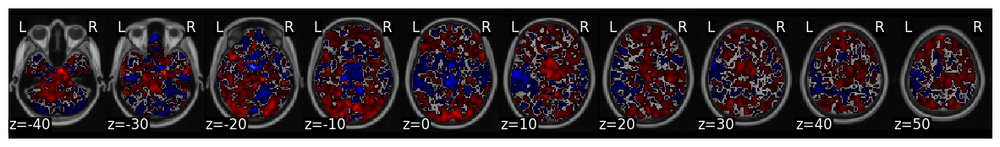

In [ ]:
# Apply a support vectorm machine for classification

svm_stats = data.predict(algorithm='svm', **{'kernel':"linear"})

the results of this analysis are stored in a dictionary.

- Y: training labels

- yfit_all: predicted labels

- dist_from_hyperplane_all: how far the prediction is from the classifier hyperplane through feature space, > 0 indicates left, while < 0 indicates right.

- intercept: scalar value which indicates how much to add to the prediction to get the correct class label.

- weight_map: multivariate brain model

- mcr_all: overall model accuracy in classifying training data

We will need to test the model on independent data - The accuracy obtained in the trainning set in the course was one. It might indicate some overfitting

In [ ]:
# This allows one the view the weight map for each voxel in a 3D brain

view_img_on_surf(svm_stats['weight_map'].to_nifti())

## Feature Selection

- The mask for feature is not present in the dataset nor there is a code available for downloading it in Python - I will use the only mask available to me

/usr/local/lib/python3.10/dist-packages/nilearn/masking.py:979: UserWarning: Data array used to create a new image contains 64-bit ints. This is likely due to creating the array with numpy and passing `int` as the `dtype`. Many tools such as FSL and SPM cannot deal with int64 in Nifti images, so for compatibility the data has been converted to int32.
  return new_img_like(mask_img, unmasked, affine)


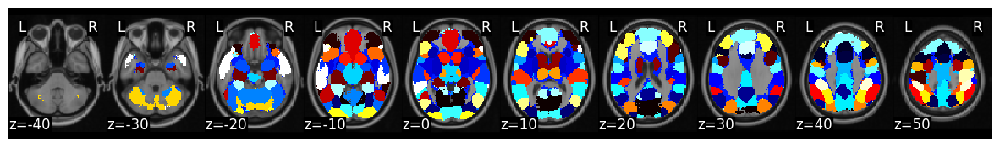

In [ ]:
mask = Brain_Data(os.path.join('..', 'masks', '/content/drive/MyDrive/localizer/mask/whole_brain_cluster_labels_PCA=100_k=50.nii'))
mask_x = expand_mask(mask)

mask.plot()

Let’s combine two parcels (left-26 and right-47 motor) to make a mask and use this as a feature extract method.

This means that we will only be training voxels to discriminate between the two conditions if they are in the right or left motor cortex.

/usr/local/lib/python3.10/dist-packages/nilearn/masking.py:979: UserWarning: Data array used to create a new image contains 64-bit ints. This is likely due to creating the array with numpy and passing `int` as the `dtype`. Many tools such as FSL and SPM cannot deal with int64 in Nifti images, so for compatibility the data has been converted to int32.
  return new_img_like(mask_img, unmasked, affine)


overall accuracy: 1.00


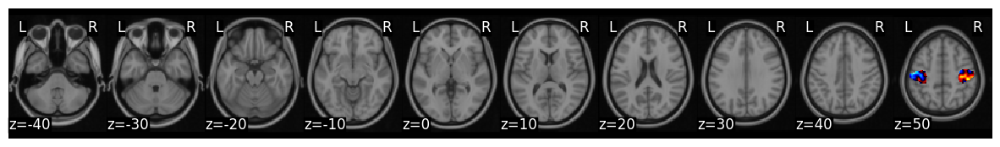

In [ ]:
motor = mask_x[[26,47]].sum()

data_masked = data.apply_mask(motor)

svm_stats_masked = data_masked.predict(algorithm='svm', **{'kernel':"linear"})

## Cross Validation

- The high accuracy on trainning data indicates an overfit

- Cross validation - divide the training data into partitions
k - separete folds



overall accuracy: 1.00
overall CV accuracy: 0.69


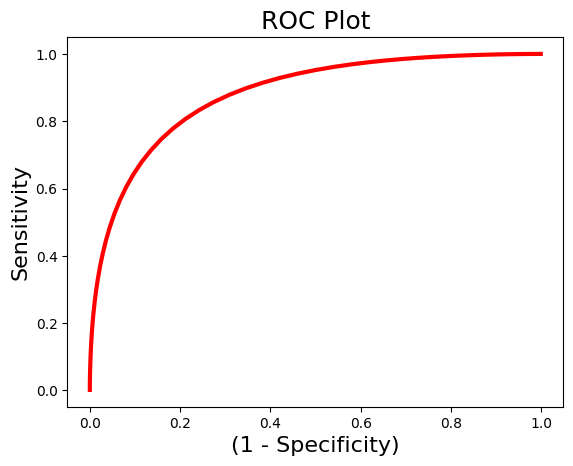

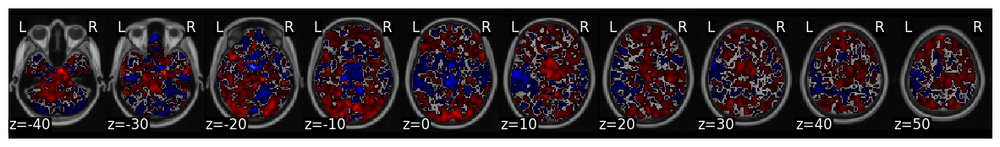

In [ ]:
## Cross validation is super easy to do here - it's implemented in the svm

# Here we test with all the features
sub_list = [os.path.basename(x).split('_')[0] for x in right_file_list]
subject_id = pd.DataFrame(sub_list + sub_list)

svm_stats = data.predict(algorithm='svm', cv_dict={'type': 'kfolds','n_folds': 5, 'subject_id':subject_id}, **{'kernel':"linear"})

/usr/local/lib/python3.10/dist-packages/nilearn/masking.py:979: UserWarning: Data array used to create a new image contains 64-bit ints. This is likely due to creating the array with numpy and passing `int` as the `dtype`. Many tools such as FSL and SPM cannot deal with int64 in Nifti images, so for compatibility the data has been converted to int32.
  return new_img_like(mask_img, unmasked, affine)


overall accuracy: 1.00
overall CV accuracy: 0.81


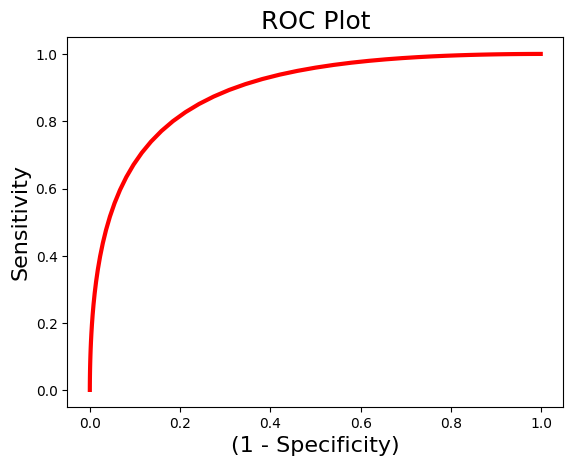

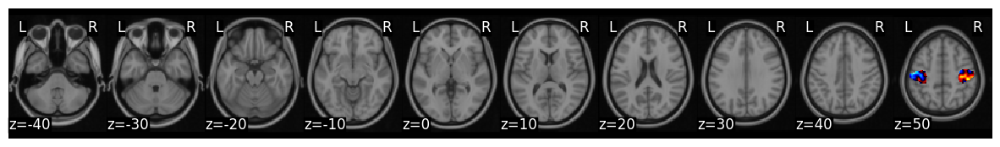

In [ ]:
# Here, we test with only with the mask
# And get an improved acccuracy lol

motor = mask_x[[26,47]].sum()
data_masked = data.apply_mask(motor)

svm_stats_masked = data_masked.predict(algorithm='svm', cv_dict={'type': 'kfolds','n_folds': 5, 'subject_id':subject_id}, **{'kernel':"linear"})

## Regularization

- It's a method that introduces penalities for too much parameter usage.

- It goes on the optimization part of the training as a penality - it needs to be minimized with the error

- The course lits two regularization norms - L1 and L2 - L1 is just the sum of the absolute value of the parameters and L2 is sum of the squares

- Curiosity - L1 and L2 come from the name of two integrable sets of functions

- Both norms are multiplied by a regularization parameter $λ$ which determines the strength of the regularization when compared to the error optimization


overall accuracy: 1.00
overall CV accuracy: 0.69


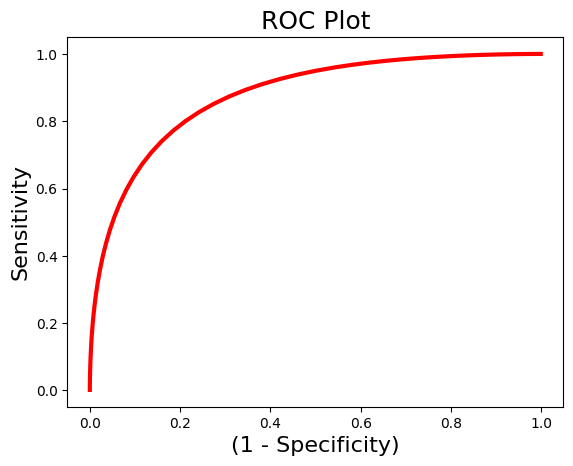

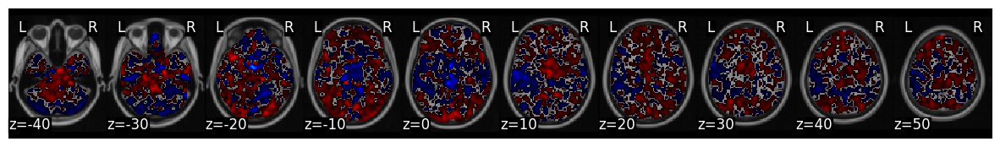

In [ ]:
# Algo with regularization

ridge_stats = data.predict(algorithm='ridgeClassifier',
                        cv_dict={'type': 'kfolds','n_folds': 5,'subject_id':subject_id},
                           **{'alpha':.01})

## Class imbalance

Sometimes, you might have to much more examples of one class then another - It does need to be accounted for - example - if 99% of points belong to an individual class, I can just guess everything belong to that class to get a 99% accuracy

The course lists some interesting startegies:

There are several different ways to deal with class imbalance.

- Make the Class Sizes Equal You can randomly sample data that is overrepresented to create your own balanced dataset. Advantages are that the data classes will be balanced. The disadvantage of this approach is that you are not using all of your data.

- Average Data You can average all of the data within a class so that each participant only has one data point per class. Advantages are the data are balanced. Disadvantages are that you have dramatically reduced the amount of data going into training the model.

- Balance Class Weights If you are using SVM, you can set class_weight=balanced. The general idea is to increase the penalty for misclassifying minority classes to prevent them from being “overwhelmed” by the majority class. See here for a brief overview.



overall accuracy: 1.00
overall CV accuracy: 0.69


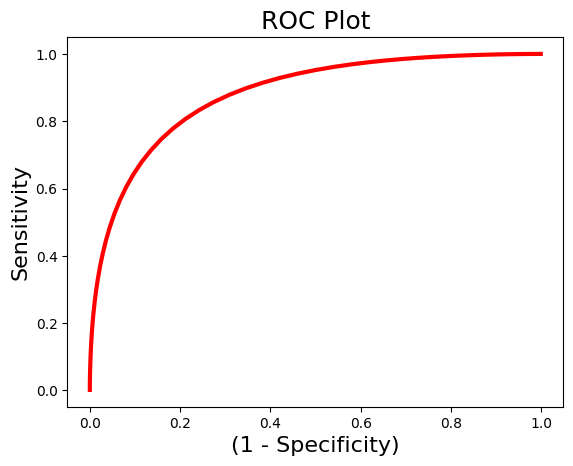

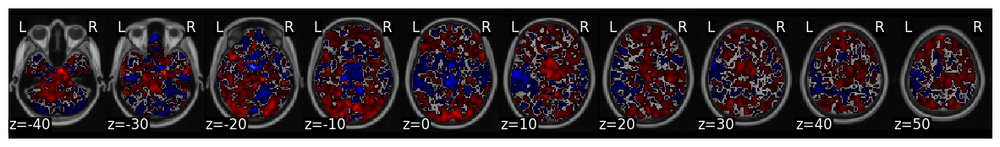

In [ ]:
# svm with balanced classes

svm_stats = data.predict(algorithm='svm', cv_dict={'type': 'kfolds','n_folds': 5, 'subject_id':subject_id},
                         **{'class_weight':'balanced', 'kernel':"linear"})

## Exercises

Training the classifier with another beta


In [ ]:
vert_file_list = glob.glob(os.path.join(data_dir, 'derivatives', 'betas', '*vertical_checkerboard.nii.gz'))
vert_file_list.sort()
vert = Brain_Data(vert_file_list)

hor_file_list = glob.glob(os.path.join(data_dir, 'derivatives', 'betas', '*horizontal_checkerboard.nii.gz'))
hor_file_list.sort()
hor = Brain_Data(hor_file_list)

data = vert.append(hor)

In [ ]:
# The next step is to assign the data labels - we assign the label for right or left to the data Y variable
# Labels: 1 for left video and 0 for right video

Y = pd.DataFrame(np.hstack([np.ones(len(vert_file_list)), np.zeros(len(hor_file_list))]))

data.Y = Y

overall accuracy: 1.00
overall CV accuracy: 0.88


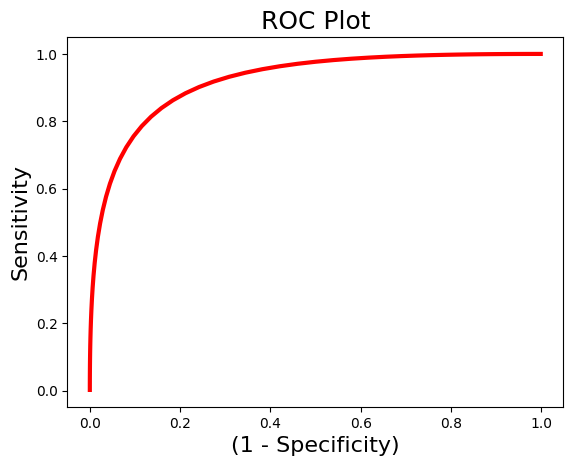

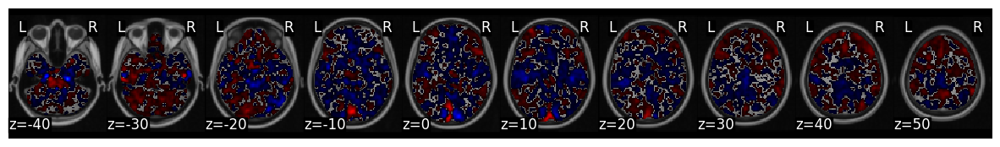

In [ ]:
svm_stats = data.predict(algorithm='svm', cv_dict={'type': 'kfolds','n_folds': 5, 'subject_id':subject_id}, **{'kernel':"linear"})

# Representational Similarity Analysis (RSA)

From what I initially understand, it's basically a distance metric between different data types:

Is this chapter, we go over:
- how to embed a stimuli in a feature space
- how to compute similarity or distance within this feature space
- how to map variations in position within this embedding space onto brain processes.


Data Structure - We can compute the representational space of these stimuli by calculating the pairwise distance between each image in this feature space (e.g., euclidean, correlation, cosine, etc). This will yield an image x image matrix.

Now we can test different hypotheses about how the brain might be processing information about each image by mapping the representational structure of the brain space to different features spaces.

To make an inference about what each region of the brain is computing, we can evaluate if there are any regions in the brain that exhibit a similar structure as the feature representational space.

This is really unclear - We can make inferences across subjects, by transforming each correlation value for a given region to a continuous metric using a fisher r-to-z transformation and then computing a one-sample t-test over participants to test if the observed distribution is significantly different from zero. - Both metrics are continous, why is it saying transform to a continus metric?  


In [ ]:
# Code example, similarity computation

%matplotlib inline

import os
import glob
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from nltools.data import Brain_Data, Adjacency
from nltools.mask import expand_mask, roi_to_brain
from nltools.stats import fdr, threshold, fisher_r_to_z, one_sample_permutation
from sklearn.metrics import pairwise_distances
from nilearn.plotting import plot_glass_brain, plot_stat_map, view_img_on_surf, view_img
from bids import BIDSLayout, BIDSValidator

data_dir = '/content/drive/MyDrive/localizer'

Exception ignored on calling ctypes callback function: <function ThreadpoolController._find_libraries_with_dl_iterate_phdr.<locals>.match_library_callback at 0x799ff8500dc0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/threadpoolctl.py", line 1005, in match_library_callback
    self._make_controller_from_path(filepath)
  File "/usr/local/lib/python3.10/dist-packages/threadpoolctl.py", line 1175, in _make_controller_from_path
    lib_controller = controller_class(
  File "/usr/local/lib/python3.10/dist-packages/threadpoolctl.py", line 114, in __init__
    self.dynlib = ctypes.CDLL(filepath, mode=_RTLD_NOLOAD)
  File "/usr/lib/python3.10/ctypes/__init__.py", line 374, in __init__
    self._handle = _dlopen(self._name, mode)
OSError: /usr/local/lib/python3.10/dist-packages/numpy.libs/libopenblas64_p-r0-0cf96a72.3.23.dev.so: cannot open shared object file: No such file or directory


## Single Subject Pattern Similarity


In [ ]:
sub = 'S01'

file_list = glob.glob(os.path.join(data_dir, 'derivatives', 'betas', f'{sub}*'))
file_list = [x for x in file_list if f'{sub}_betas.nii.gz' not in x]
file_list.sort()
conditions = [os.path.basename(x).split(f'{sub}_beta_')[1].split('.nii.gz')[0] for x in file_list]
beta = Brain_Data(file_list)

print(file_list)
print(conditions)
print(beta.data.shape)
print(beta.data)

['/content/drive/MyDrive/localizer/derivatives/betas/S01_beta_audio_computation.nii.gz', '/content/drive/MyDrive/localizer/derivatives/betas/S01_beta_audio_left_hand.nii.gz', '/content/drive/MyDrive/localizer/derivatives/betas/S01_beta_audio_right_hand.nii.gz', '/content/drive/MyDrive/localizer/derivatives/betas/S01_beta_audio_sentence.nii.gz', '/content/drive/MyDrive/localizer/derivatives/betas/S01_beta_horizontal_checkerboard.nii.gz', '/content/drive/MyDrive/localizer/derivatives/betas/S01_beta_vertical_checkerboard.nii.gz', '/content/drive/MyDrive/localizer/derivatives/betas/S01_beta_video_computation.nii.gz', '/content/drive/MyDrive/localizer/derivatives/betas/S01_beta_video_left_hand.nii.gz', '/content/drive/MyDrive/localizer/derivatives/betas/S01_beta_video_right_hand.nii.gz', '/content/drive/MyDrive/localizer/derivatives/betas/S01_beta_video_sentence.nii.gz']
['audio_computation', 'audio_left_hand', 'audio_right_hand', 'audio_sentence', 'horizontal_checkerboard', 'vertical_check

Here we load the atlas and the parcelation mask

/usr/local/lib/python3.10/dist-packages/nilearn/masking.py:979: UserWarning: Data array used to create a new image contains 64-bit ints. This is likely due to creating the array with numpy and passing `int` as the `dtype`. Many tools such as FSL and SPM cannot deal with int64 in Nifti images, so for compatibility the data has been converted to int32.
  return new_img_like(mask_img, unmasked, affine)


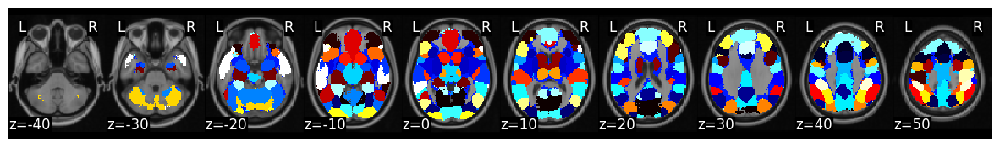

In [ ]:
mask = Brain_Data('/content/drive/MyDrive/localizer/mask/k50_2mm.nii.gz')
mask_x = expand_mask(mask)

mask.plot()

In [ ]:
# Here we aply the mask ROI and compute the correlation of the betas between tasks using all the regions

out = []
for m in mask_x:
    out.append(beta.apply_mask(m).distance(metric='correlation'))

/usr/local/lib/python3.10/dist-packages/nilearn/masking.py:979: UserWarning: Data array used to create a new image contains 64-bit ints. This is likely due to creating the array with numpy and passing `int` as the `dtype`. Many tools such as FSL and SPM cannot deal with int64 in Nifti images, so for compatibility the data has been converted to int32.
  return new_img_like(mask_img, unmasked, affine)
/usr/local/lib/python3.10/dist-packages/nilearn/masking.py:979: UserWarning: Data array used to create a new image contains 64-bit ints. This is likely due to creating the array with numpy and passing `int` as the `dtype`. Many tools such as FSL and SPM cannot deal with int64 in Nifti images, so for compatibility the data has been converted to int32.
  return new_img_like(mask_img, unmasked, affine)
/usr/local/lib/python3.10/dist-packages/nilearn/masking.py:979: UserWarning: Data array used to create a new image contains 64-bit ints. This is likely due to creating the array with numpy and p

/usr/local/lib/python3.10/dist-packages/nilearn/masking.py:979: UserWarning: Data array used to create a new image contains 64-bit ints. This is likely due to creating the array with numpy and passing `int` as the `dtype`. Many tools such as FSL and SPM cannot deal with int64 in Nifti images, so for compatibility the data has been converted to int32.
  return new_img_like(mask_img, unmasked, affine)


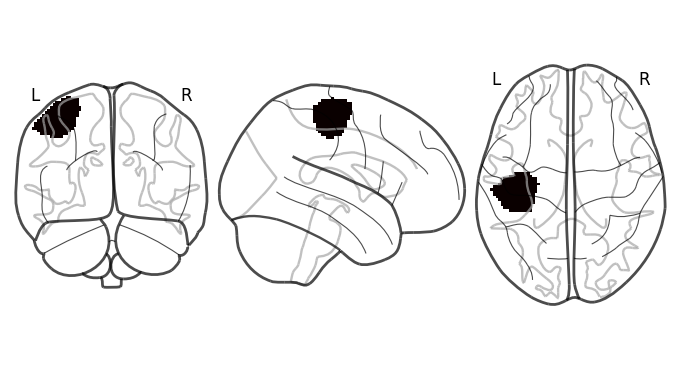

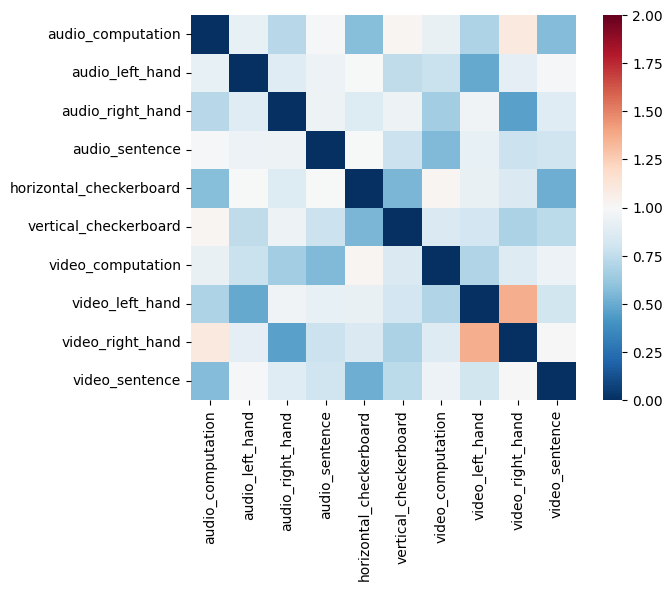

In [ ]:
# Finally we display correlation distance between ROIs

roi = 26
plot_glass_brain(mask_x[roi].to_nifti())
out[roi].labels = conditions
f2 = out[roi].plot(vmin=0, vmax=2, cmap='RdBu_r')

/usr/local/lib/python3.10/dist-packages/nilearn/masking.py:979: UserWarning: Data array used to create a new image contains 64-bit ints. This is likely due to creating the array with numpy and passing `int` as the `dtype`. Many tools such as FSL and SPM cannot deal with int64 in Nifti images, so for compatibility the data has been converted to int32.
  return new_img_like(mask_img, unmasked, affine)


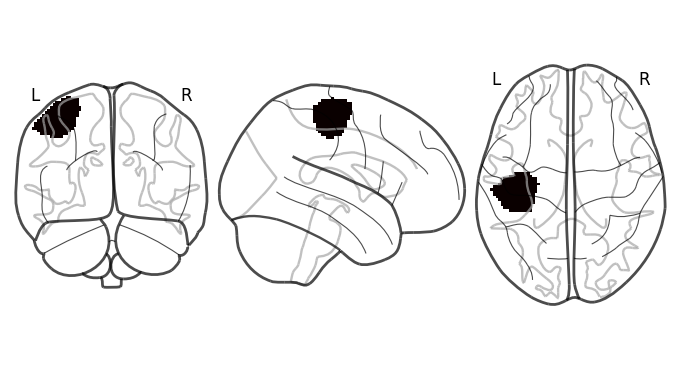

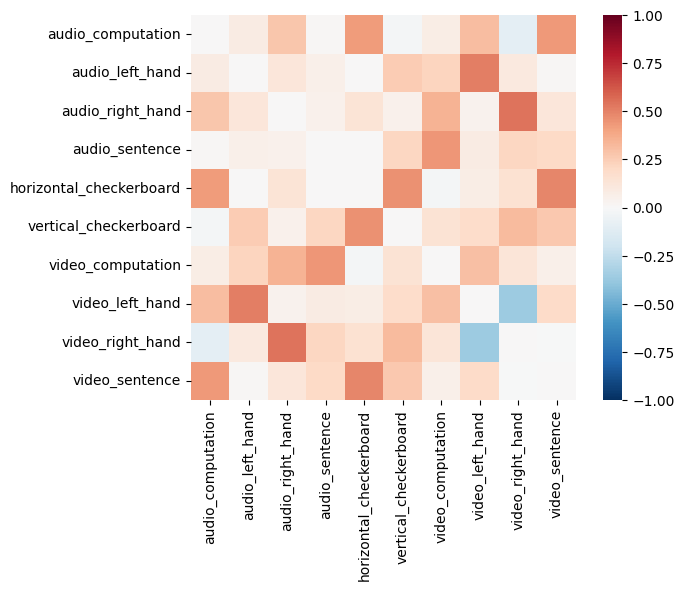

In [ ]:
# The course converts from distance to similatity - the higher the similarity - the more alike
# This is basically 1 - correlation distance

out_sim = []
for m in out:
    mask_tmp = m.copy()
    mask_tmp = 1 - mask_tmp
    mask_tmp.labels = conditions
    out_sim.append(mask_tmp)

roi = 26
plot_glass_brain(mask_x[roi].to_nifti())
f = out_sim[roi].plot(vmin=-1, vmax=1, cmap='RdBu_r')

## Testing a Representation Hypothesis

Ok, now that we have a sense of what the similarity of patterns look like in left motor cortex, let us create an adjacency matrix indicating a specific relationship between left hand finger tapping across the auditory and visual conditions. This type of adjacency matrix is one way in which we can test a specific hypotheses about the representational structure of the data across all images.



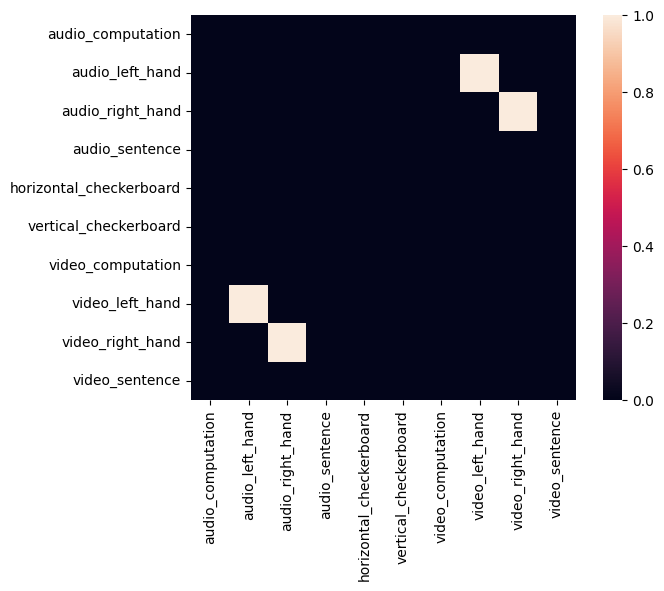

In [ ]:
# To test the hypothesis - we set the edges between the conditions analysed to 1

motor = np.zeros((len(conditions),len(conditions)))
motor[np.diag_indices(len(conditions))] = 1
motor[1,7] = 1
motor[7,1] = 1
motor[2,8] = 1
motor[8,2] = 1
motor = Adjacency(motor, matrix_type='distance', labels=conditions)
motor.plot()


Now let’s search over all ROIs to see if any match this representational structure of left motor-cortex using the similarity() method from the Adjacency class. This function uses spearman rank correlations by default. This is probably a good idea as we are most interested in monotonic relationships between the two similarity matrices.



Text(0, 0.5, 'Frequency')

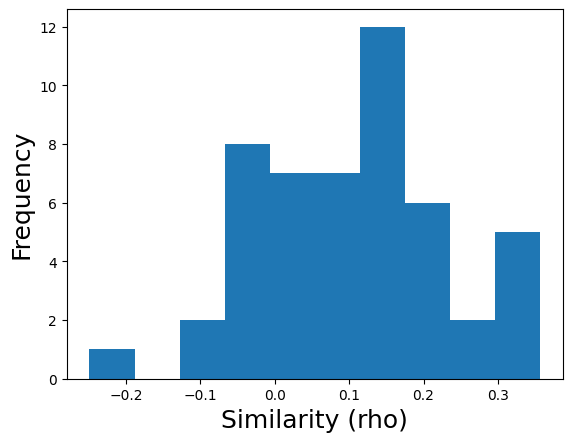

In [ ]:
# We calculate the similarity of our hypothesis with all ROIs

motor_sim_r = []
for m in out_sim:
    s = m.similarity(motor, metric='spearman', n_permute=0)
    motor_sim_r.append(s['correlation'])

plt.hist(motor_sim_r)
plt.xlabel('Similarity (rho)', fontsize=18)
plt.ylabel('Frequency', fontsize=18)

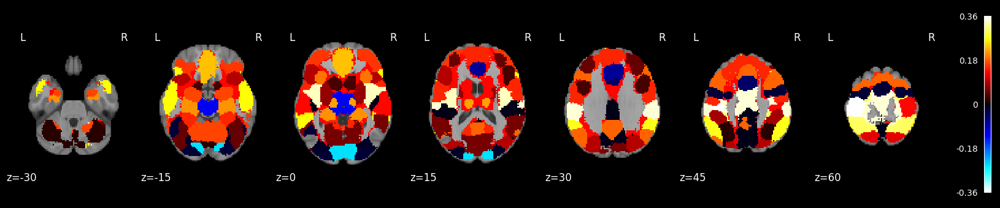

In [ ]:
# Plot it back into the brain

rsa_motor = roi_to_brain(motor_sim_r, mask_x)

plot_stat_map(rsa_motor.to_nifti(), draw_cross=False, display_mode='z', black_bg=True, cut_coords=np.arange(-30,70, 15))

# Parcellations

The goal of this tutorial is to provide an introduction to parcellation schemes. We will cover the types of atlases that are available, when to use them, and how to work with them in python.

This is basically the chapter on atlases

## Spatial Scales

Parcellations provide a way to examine the brain at different spatial scales by restricting the number of regions of interest to variable scales as determined by anatomical or functional divisions. We provide extensive detail on anatomical, functional and structural approaches to building parcellations. In general, the goal is to use group together voxels based on either one of these methodological divisions. This grouping of voxels can be either contiguous (voxels that are spatially next to one another in a particular region of the brain) or non-contiguous

In [14]:
## Nilearn atlases

from nilearn import datasets

datasets.fetch_atlas_harvard_oxford
datasets.fetch_atlas_difumo
datasets.fetch_atlas_msdl
datasets.fetch_atlas_schaefer_2018
datasets.fetch_atlas_aal
datasets.fetch_atlas_smith_2009
datasets.fetch_atlas_surf_destrieux
datasets.fetch_atlas_craddock_2012
datasets.fetch_atlas_talairach
datasets.fetch_atlas_yeo_2011
datasets.fetch_atlas_juelich
datasets.fetch_atlas_basc_multiscale_2015

<function nilearn.datasets.atlas.fetch_atlas_basc_multiscale_2015(data_dir=None, url=None, resume=True, verbose=1, resolution=None, version='sym')>

## Neuroparc package

Alternatively, there is also the Neuroparc package, which provides a large repository of standardized atlases (currently 46; see Table below), which can be used interchangeably. Neuroparc includes details to make the comparison between atlases in MNI space easily (Lawrence et al., 2021). Importantly, their Github page README file provides an excellent summary of how the parcellations where created, their description, and their native space.

[_add_readme_to_default_data_locations] Added README.md to /root/nilearn_data

[get_dataset_dir] Dataset created in /root/nilearn_data/aal_SPM12

[fetch_single_file] Downloading data from https://www.gin.cnrs.fr/AAL_files/aal_for_SPM12.tar.gz ...

[fetch_single_file]  ...done. (2 seconds, 0 min)

[uncompress_file] Extracting data from 
/root/nilearn_data/aal_SPM12/5d72fe1c9daf02b658cbf1f7e7026e0f/aal_for_SPM12.tar.gz...

[uncompress_file] .. done.

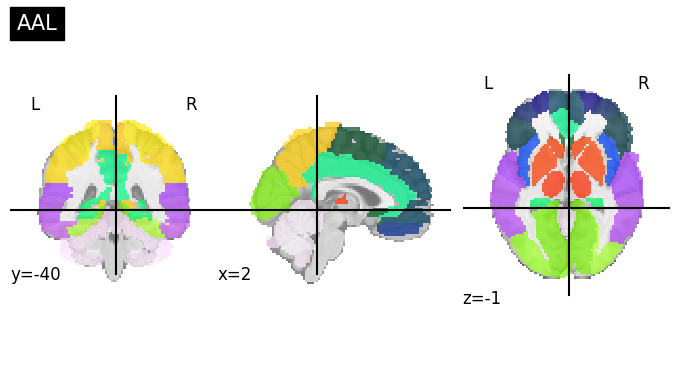

In [2]:
from nilearn import datasets, plotting

# Plotting one atlas

aal = datasets.fetch_atlas_aal(version='SPM12')
aal.maps

plotting.plot_roi(aal.maps, title="AAL")

In [5]:
# Another atlas - This one has a download error for some reason

for level in ['hemisphere', 'lobe', 'gyrus', 'tissue', 'ba']:
  talairach = datasets.fetch_atlas_talairach(level_name=level)

  plotting.plot_roi(talairach.maps, title=f'Talairach - {level}')

[get_dataset_dir] Dataset found in /root/nilearn_data/talairach_atlas

[fetch_single_file] Downloading data from https://www.talairach.org/talairach.nii ...

[fetch_single_file] Error while fetching file talairach.nii; dataset fetching aborted.

SSLError: HTTPSConnectionPool(host='www.talairach.org', port=443): Max retries exceeded with url: /talairach.nii (Caused by SSLError(SSLCertVerificationError(1, '[SSL: CERTIFICATE_VERIFY_FAILED] certificate verify failed: unable to get local issuer certificate (_ssl.c:1007)')))

Multiple-subject atlases use the combination of multiple subjects’ T1 scans as the reference image for mirroring in generating anatomical atlases. Multiple-subject parcelations are thought to be more accurate than single subject parcellations and tend to be probabilistic in that they describe the probability of a voxel belonging to a specific region of the brain based on multiple subjects.

## Functional parcellations

The goal of functional parcellations is to group voxels based on similar function, using either functional activity or functional connectivity as similarity measures. Again, a nice review can be found in Moghimi et al. 2021. The assumption is that functionally distinct brain regions have voxels with shared functional activity and connectivity. For a great discussion of how cortical regions have a ‘connectional fingerprint’ reflecting both observed cell-firing differences and functional imaging activity, see: Passingham, Stephan & Kötter (2002). A combination of resting state fMRI and task-based fMRI have been used to generate these parcellations. Before discussing the implementation and generation of functional parcellations, we wish to acknowledge a couple of ongoing fields of research.





Yeo parcellation

This parcellation divides the cortex based on resting state networks (either 7 or 17) using data from 1000, healthy subjects.

It employs a clustering approach

Notably, it shows not only localized networks (ex: motor), but also distributed networks that operate across the cortex (ex: Default Mode).

This network is also available in the Freesurfer package

This is available in MNI152 space through Nilearn and in Freesurfer space through Neuroparc. We include the Nilearn function below and show how both the 17 and 7 Network labels can be included.

[get_dataset_dir] Dataset created in /root/nilearn_data/yeo_2011

[fetch_single_file] Downloading data from ftp://surfer.nmr.mgh.harvard.edu/pub/data/Yeo_JNeurophysiol11_MNI152.zip 
...

[fetch_single_file]  ...done. (1 seconds, 0 min)

[uncompress_file] Extracting data from 
/root/nilearn_data/yeo_2011/622858b56913b19ae0865d9fa8ad47cc/Yeo_JNeurophysiol11_MNI152.zip...

[uncompress_file] .. done.

dict_keys(['description', 'thin_7', 'thick_7', 'thin_17', 'thick_17', 'colors_7', 'colors_17', 'anat'])


"Note: if you want to keep the canonical Yeo colors for your plotting, there is a 'colors_7' txt file available in the nilearn function"

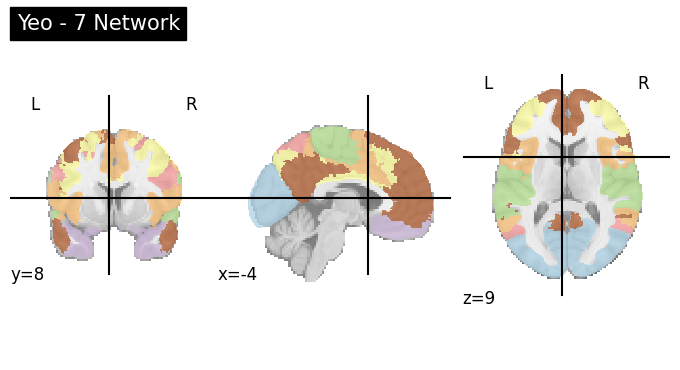

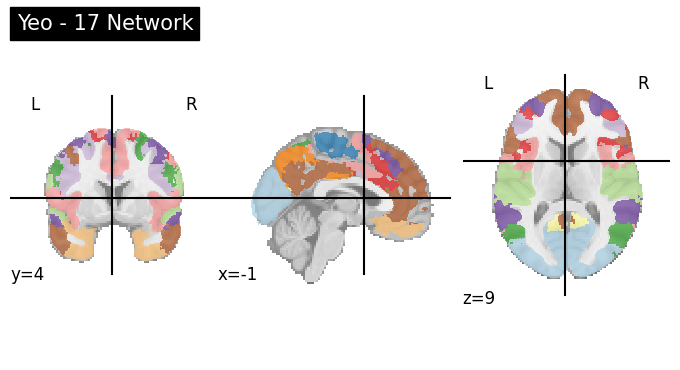

In [6]:
yeo = datasets.fetch_atlas_yeo_2011()

''' See outputs of the dataset '''
print(yeo.keys())

for label in ['thick_7','thick_17']:
  n = label.replace("thick_","")
  atlas = yeo[label] #this loads in a .nii file
  plotting.plot_roi(atlas, title=f'Yeo - {n} Network',cmap='Paired')

'''Note: if you want to keep the canonical Yeo colors for your plotting, there is a 'colors_7' txt file available in the nilearn function'''


Schaefer parcellation

This parcellation aims to combine (1) local gradient and (2) global similarity approaches by using both task-based fMRI and resting-state fMRI. They develop a gradient-weighted Markov Random Field (gwMRF) model.

Local gradient approaches look at brusque changes in the functional connectivity patterns, while global similarity approaches cluster based on similar functional connectivity more broadly (such as Yeo).

Importantly, the Github page for this parcellation is consistently updated and provides the parcellation in Freesurfer space, HCP space, and MNI space.

The parcellation also comes with labels from the Yeo 7 resting state network or 17 Network parcellation and can be split into 100, 200, 300, 400, 500, 600, 700, 800, 900, and 1000 parcels depending on user preference. A detailed anatomical description of the functional and structural features of these nodes is included in the publication.

It is available both through Nilearn and Neuroparc and we provide example code for how to use the Nilearn function below. In Nilearn, the reference space is MNI152.

In this case, the number of ROIs (parcels), the network number (7 or 17) and the resolution (1 or 2 mm) needs to be specified.

## Structural parcellation

Structural parcellations reflect the structural connectivity profile and rely on diffusion-weighted MR. The connectivity profile of a voxels reflects the probability of that voxel being connected to other voxels via a white matter fiber. They estimate where white matter tracks start and end and their pathways. The premise is that connections reflect functional organization, so cortical regions that are functionally distinct from one another should have different connectivity patterns. However, given that structural parcellations rely on accurate white matter fiber estimation, the limiting factor is the fidelity of the tractography process. There are two main topographic approaches for mapping fibers: (1) deterministic and (2) probabilistic, but the majority use probabilistic tractography. Similar methods of clustering (as described under Functional Parcellations) are used to assign boundaries based on connectivity. Importantly, tractography algorithms are biased towards tracts ended on the gyral surface such that parcellations are biased to align with the sulci.

## Summary

This part is a summary of the atlases parcelation strategy discussed:

- Anatomical parcellations:

- - Defined based on anatomical landmark (sulci/gyri)

- - Intended to relate to macroscale cytoarchitectural properties

- - Reflects the spatial location of a region

- - Disregards idioisyncracies in brain anatomy and functional-anatomical differences across subjects

- Functional parcellations:

- - Defined with functional activity/connectivity measures

- - Uses resting-state and/or task-based fMRI

- - Groups regions based on similarity of function based on clustering or graph metrics

- - Can be well-defined at the individual-subject and group level

- - Varying degrees of granularity (anywhere from 100 to 1000 regions)

- Multimodal parcellations:

- - Combines anatomical, functional, and topographic methods to define parcels

- - Defined at the group-level



# Resampling Statistics

Four ways of performing resampling statistics:

- bootstrap allows us to calculate the precision of an estimator by resampling with replacement

- permutation test allows us to perform null-hypothesis testing by empirically computing the proportion of times a test statistic exceeds a permuted null distribution.

- jackknife allows us to estimate the bias and standard error of an estimator by creating samples that drop one or more samples.

- cross-validation provides a method to provide an unbiased estimate of the out-of-sample predictive accuracy of a model by dividing the data into separate training and test samples, where each data serves as both training and test for different models.

## Bootstraping

- Bootstrapping offers a way to empirically estimate the precision of the estimated parameter by resampling with replacement from our sample distribution and estimating the parameters with each new subsample.

- This procedure is reasonably robust to the presence of outliers as they should rarely be randomly selected across the different subsamples. Together, the subsamples create a distribution of the parameters we might expect to encounter from independent random draws from the population and allow us to assess the precision of a sample statistic.

- This technique assumes that the original samples are independent and are random samples representative of the population.

<ipython-input-1-2d06a0b7145e>:14: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(population, kde=True, label='Population')


Population Mean: 49.9
Population Std: 10.0


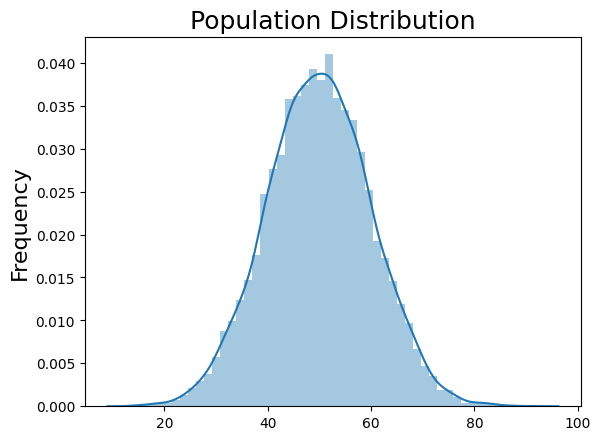

In [1]:
# Bootstraping simulation - Generate a population sample

%matplotlib inline
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

mean = 50
std = 10
population_n = 10000
population = mean + np.random.randn(population_n)*std

sns.distplot(population, kde=True, label='Population')
plt.title('Population Distribution', fontsize=18)
plt.ylabel('Frequency', fontsize=16)

print(f'Population Mean: {np.mean(population):.3}')
print(f'Population Std: {np.std(population):.3}')

<ipython-input-3-9735aa8e88bd>:6: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(sample, kde=True, label='Single Sample')


Sample Mean: 47.5
Sample Std: 10.4


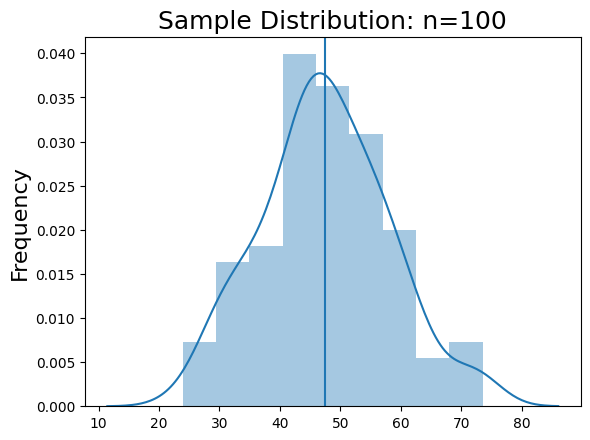

In [3]:
# Subsample drawing 50 members of the population

sample_n = 100
sample = np.random.choice(population, size=sample_n, replace=False)

sns.distplot(sample, kde=True, label='Single Sample')
plt.axvline(x=np.mean(sample), ymin=0, ymax=1, linestyle='-')
plt.title(f'Sample Distribution: n={sample_n}', fontsize=18)
plt.ylabel('Frequency', fontsize=16)

print(f'Sample Mean: {np.mean(sample):.3}')
print(f'Sample Std: {np.std(sample):.3}')

<ipython-input-4-4bb297f30db2>:11: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(bootstrap_means, kde=True, label='Bootstrap')


Bootstrapped Mean: 47.5
Bootstrapped Std: 1.06


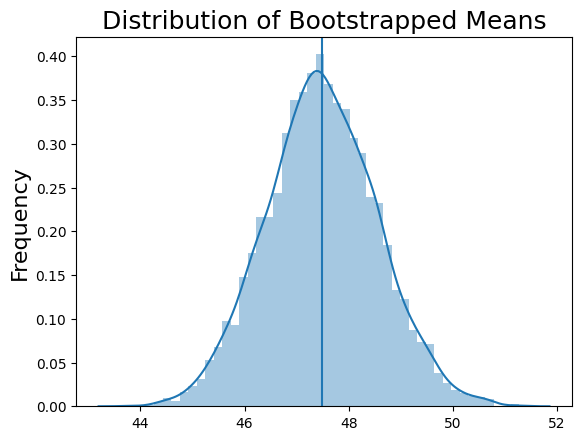

In [4]:
# Now we repeat the draw 5000 times and for each subsample we calculate and estimate the average
# We them draw the distribution of the measures averages

n_bootstrap = 5000

bootstrap_means = []
for b in range(n_bootstrap):
    bootstrap_means.append(np.mean(np.random.choice(sample, size=sample_n, replace=True)))
bootstrap_means = np.array(bootstrap_means)

sns.distplot(bootstrap_means, kde=True, label='Bootstrap')
plt.axvline(x=np.mean(bootstrap_means), ymin=0, ymax=1, linestyle='-')
plt.title('Distribution of Bootstrapped Means', fontsize=18)
plt.ylabel('Frequency', fontsize=16)

print(f'Bootstrapped Mean: {np.mean(bootstrap_means):.3}')
print(f'Bootstrapped Std: {np.std(bootstrap_means):.3}')

<ipython-input-6-85867906dd38>:13: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(bootstrap_means, kde=True, label='Bootstrap')


Bootstrapped Mean: 47.5
95% Confidence Intervals: [45.5, 49.6]


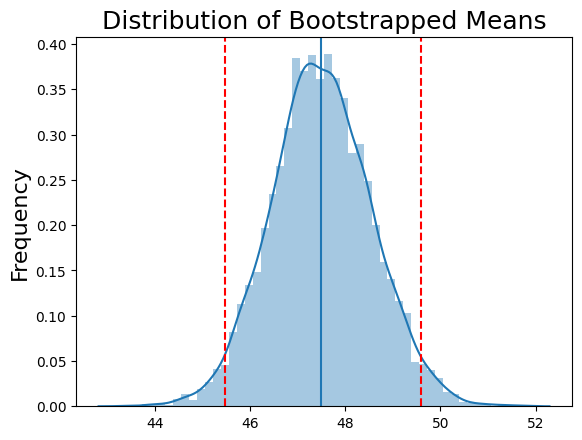

In [6]:
# We use the sample to estimate a confidence interval
# Taking the average distribution, we estimate the 2.5 and 97.5 quantiles
# essentially only %5 of the distribution is outside
# We can interpret this as there is 95% chance that our measured avarege is whithin this interval

n_bootstrap = 5000

bootstrap_means = []
for b in range(n_bootstrap):
    bootstrap_means.append(np.mean(np.random.choice(sample, size=sample_n, replace=True)))
bootstrap_means = np.array(bootstrap_means)

sns.distplot(bootstrap_means, kde=True, label='Bootstrap')
plt.axvline(x=np.mean(bootstrap_means), ymin=0, ymax=1, linestyle='-')
plt.title('Distribution of Bootstrapped Means', fontsize=18)
plt.ylabel('Frequency', fontsize=16)

lower_bound = np.percentile(bootstrap_means, 2.5)
upper_bound = np.percentile(bootstrap_means, 97.5)

plt.axvline(x=lower_bound, ymin=0, ymax=1, color='red', linestyle='--')
plt.axvline(x=upper_bound, ymin=0, ymax=1, color='red', linestyle='--')

print(f'Bootstrapped Mean: {np.mean(bootstrap_means):.3}')
print(f'95% Confidence Intervals: [{lower_bound:.3}, {upper_bound:.3}]')


The percentile method reveals that 95% of our bootstrap samples lie between the interval. While the percentile method is easy to compute and intuitive to understand, it has some issues. First, if the original sample was small and not representative of the population, the confidence interval may be biased and too narrow. Second, if the bootstrapped distribution is not symmetric and is skewed, the percentile based confidence intervals will not accurately reflect the distribution.

## Permutation Test

After we have estimated a parameter for a sample, we often want to perform a hypothesis test to assess if the observed distribution is statistically different from a null distribution at a specific alpha criterion This is called null hypothesis testing, and classical statistical tests, such as the t-test, F-test, and etc, rely on theoretical probability distributions

Using resampling statistics, we can empirically evaluate the null hypothesis by randomly shuffling the labels and re-running the statistic.
Assuming that the labels are exchangeable under the null hypothesis, then the resulting tests yield the exact significance levels, i.e., the number of times we observed our result by chance.  Permutation tests can be computationally expensive and often require writing custom code. However, because they are independent they can be run in parallel using multiple CPUs or on a high performance computing system.

### One Sample Permutation Test

Let’s simulate some data to demonstrate how to run a permutation test to evaluate if the mean of the simulated sample is statistically different from zero.

<ipython-input-7-04e7d00c953c>:14: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(sample, kde=True, label='Population')


Sample Mean: 1.21
Sample Std: 0.984


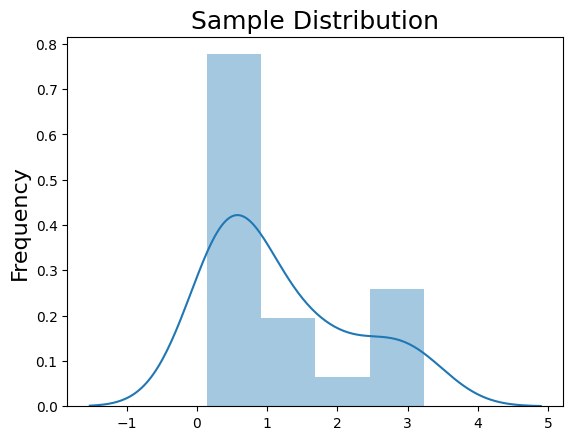

In [7]:
# Start by sampling 20 points from normal

%matplotlib inline
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

mean = 1
std = 1
sample_n = 20
sample = mean + np.random.randn(sample_n)*std

sns.distplot(sample, kde=True, label='Population')
plt.title('Sample Distribution', fontsize=18)
plt.ylabel('Frequency', fontsize=16)

print(f'Sample Mean: {np.mean(sample):.3}')
print(f'Sample Std: {np.std(sample):.3}')

In this example, the null hypothesis is that the sample does not significantly differ from zero. We can empirically evaluate this by randomly multiplying each sample by a 1 or -1 and then calculating the mean for each permutation. This will yield an empirical distribution of null means and we can evaluate the number of times the mean of our sample exceeds the mean of the null distribution.

<ipython-input-8-e742ee5ce30d>:10: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(permute_means, kde=True, label='Population')


Sample Mean: 1.21
Null Distribution Mean: 0.00417
n permutations < Sample Mean = 5000
p-value = 0.0


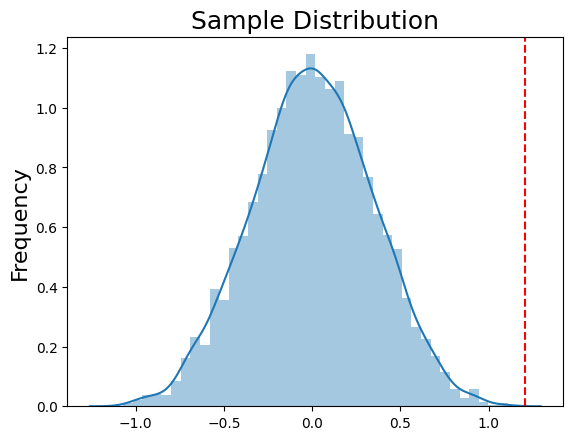

In [8]:
# We perform the permutation test and analyse how far away is your measured value from the average
# The red line indicates the location of the measured average
# We can them use this location to estimate the probability of getting a statistic as extreme as this one

n_permutations = 5000

permute_means = []
for p in range(n_permutations):
    permute_means.append(np.mean(sample * np.random.choice(np.array([1,-1]), sample_n)))
permute_means = np.array(permute_means)

p_value = 1 - np.sum(permute_means < np.mean(sample))/len(permute_means)

sns.distplot(permute_means, kde=True, label='Population')
plt.title('Sample Distribution', fontsize=18)
plt.ylabel('Frequency', fontsize=16)

plt.axvline(x=np.mean(sample), ymin=0, ymax=1, color='red', linestyle='--')

print(f'Sample Mean: {np.mean(sample):.3}')
print(f'Null Distribution Mean: {np.mean(permute_means):.3}')
print(f'n permutations < Sample Mean = {np.sum(permute_means < np.mean(sample))}')
print(f'p-value = {p_value:.3}')

### Two Sample Permutation Test

Here we compare two different groups and what to see if there is a meagninfull diference between their averages

Group one Normal av 10 dev 5
Group two Normal av 7 dev 5



<ipython-input-9-65468aab4271>:14: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(sample_1, kde=True, label='Sample 1')
<ipython-input-9-65468aab4271>:15: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(sample_2, kde=True, label='Sample 2')


Sample1 Mean: 9.66
Sample1 Std: 4.93
Sample2 Mean: 7.19
Sample2 Std: 4.82


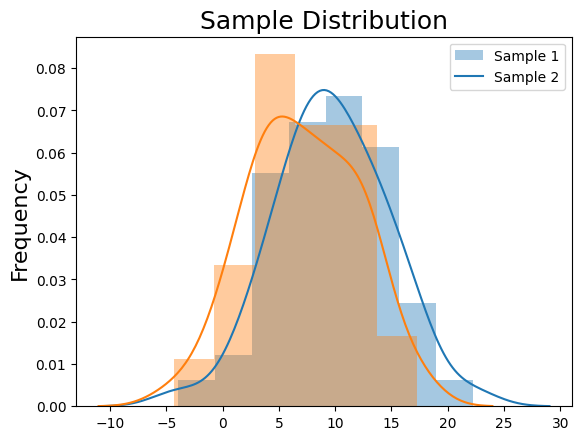

In [9]:
# Start by drawing samples

sample_n = 50

mean_1 = 10
std_1 = 5

mean_2 = 7
std_2 = 5

sample_1 = mean_1 + np.random.randn(sample_n)*std_1
sample_2 = mean_2 + np.random.randn(sample_n)*std_2

sns.distplot(sample_1, kde=True, label='Sample 1')
sns.distplot(sample_2, kde=True, label='Sample 2')
plt.title('Sample Distribution', fontsize=18)
plt.ylabel('Frequency', fontsize=16)
plt.legend(['Sample 1', 'Sample 2'])

print(f'Sample1 Mean: {np.mean(sample_1):.3}')
print(f'Sample1 Std: {np.std(sample_1):.3}')

print(f'Sample2 Mean: {np.mean(sample_2):.3}')
print(f'Sample2 Std: {np.std(sample_2):.3}')

<ipython-input-15-89dfca799ffb>:21: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(permute_diffs, kde=True, label='Population')


Difference between Sample1 & Sample2 Means: 2.47
n permutations < Sample Mean Difference = 4969
p-value = 0.0062


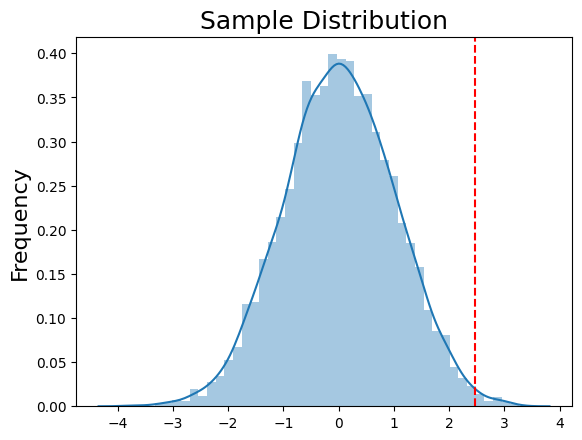

In [15]:
# To perform the test, we generate a null distribution by permuting the group labels
# We then recalculating the mean difference between the groups
# We check how extreme was our measured averge difference when compared to the null

# There is an issue with this final code - append was deprecated
# I fixed it with concat

data1 = pd.DataFrame({'Group':np.ones(len(sample_1)), 'Values':sample_1})
data2 = pd.DataFrame({'Group':np.ones(len(sample_2))*2, 'Values':sample_2})

data = pd.concat([data1, data2])

permute_diffs = []
for p in range(n_permutations):
    permutation_label = np.random.permutation(data['Group'])
    diff = np.mean(data.loc[permutation_label == 1, 'Values']) - np.mean(data.loc[permutation_label == 2, 'Values'])
    permute_diffs.append(diff)

difference = np.mean(sample_1) - np.mean(sample_2)
p_value = 1 - np.sum(permute_diffs < difference)/len(permute_means)

sns.distplot(permute_diffs, kde=True, label='Population')
plt.title('Sample Distribution', fontsize=18)
plt.ylabel('Frequency', fontsize=16)

plt.axvline(x=difference, ymin=0, ymax=1, color='red', linestyle='--')

print(f'Difference between Sample1 & Sample2 Means: {difference:.3}')
print(f'n permutations < Sample Mean Difference = {np.sum(permute_diffs < difference)}')
print(f'p-value = {p_value:.3}')